In [42]:
# General modules
import sys
import os
import session_info
import warnings
from pyprojroot.here import here
import glob
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.lines as plines
import matplotlib.colors as mcolors
from IPython.display import display
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib.lines import Line2D  # for legend handle
import seaborn as sns

import scipy.cluster.hierarchy as sch

# Specific modules
import scanpy as sc
import decoupler as dc
import anndata as ad
import scienceplots

# Setting some parameters
warnings.filterwarnings("ignore")

# Import functions
sys.path.insert(1, str(here('bin')))
from customPalette import *
from customPythonFunctions import aggregating_features, composition_barplot

# Palettes
batch_palette = {
    "gPlexA": "#E69F00",  # Orange
    "gPlexB": "#56B4E9",  # Light Blue
    "gPlexC": "#009E73",  # Green
    "gPlexD": "#F0E442",  # Yellow
    "gPlexE": "#0072B2",  # Dark Blue
    "gPlexF": "#D55E00",  # Red
    "gPlexG": "#CC79A7",  # Pink
    "gPlexH": "#8E44AD",  # Purple
    "gPlexJ": "#2E8B57",  # Sea Green
    "gPlexK": "#B22222"  # Firebrick Red
}

plt.style.use(['nature'])
dpi_fig_save = 300
sc.set_figure_params(dpi=100, dpi_save=dpi_fig_save, vector_friendly=True)

overwriteFigures = True
overwriteData = True

pd.options.display.max_columns = 300
pd.options.display.max_rows = 1000

In [43]:
print("Main directory path: {}".format(here()))

Main directory path: /scratch_isilon/groups/singlecell/shared/projects/Inflammation-PBMCs-Atlas


In [44]:
# replacing variable to exclude Progenitors & Cycling cells
annotation_Level1_NonUsedFilt_sortednames = ["B", "Plasma", "pDC", "DC", "Mono", "T_CD4_Naive", "T_CD4_NonNaive", "T_CD8_Naive", "T_CD8_NonNaive", "UTC", "ILC"]

# ADATA including Gene Universe (8253 genes) - non-corrected data

In [45]:
# Load data
inputfile_path = here("03_downstream_analysis/02_gene_universe_definition/results/04_MAIN_geneUniverse.h5ad")
adata = sc.read_h5ad(inputfile_path)
adata

AnnData object with n_obs × n_vars = 4435922 × 8253
    obs: 'studyID', 'libraryID', 'sampleID', 'chemistry', 'disease', 'sex', 'binned_age', 'Level1', 'Level2'
    var: 'hgnc_id', 'symbol', 'locus_group', 'HUGO_status', 'highly_variable'

In [46]:
# Subsetting STUDY
adata = adata[(adata.obs['studyID'] == "COMBAT2022")]
adata

View of AnnData object with n_obs × n_vars = 591017 × 8253
    obs: 'studyID', 'libraryID', 'sampleID', 'chemistry', 'disease', 'sex', 'binned_age', 'Level1', 'Level2'
    var: 'hgnc_id', 'symbol', 'locus_group', 'HUGO_status', 'highly_variable'

In [47]:
# Subsetting cells of interest
adata = adata[(adata.obs['Level1'].isin(annotation_Level1_NonUsedFilt_sortednames))]
adata.obs['Level1'] = pd.Categorical(adata.obs['Level1'], categories=annotation_Level1_NonUsedFilt_sortednames, ordered=True)
adata

AnnData object with n_obs × n_vars = 565423 × 8253
    obs: 'studyID', 'libraryID', 'sampleID', 'chemistry', 'disease', 'sex', 'binned_age', 'Level1', 'Level2'
    var: 'hgnc_id', 'symbol', 'locus_group', 'HUGO_status', 'highly_variable'

**Required to recover metadata of "batch" and "Channel_ID" and "COVID_severity"**

In [48]:
# Load COMBAT2022wSepsis study
import pickle

with open(here("01_data_processing/results/extended_obs/COMBAT2022_obs.pkl"), 'rb') as file:
    COMBATmetadata = pickle.load(file)

# Subset columns of interest
COMBATmetadata = COMBATmetadata[["batch", "Channel_ID", "COVID_severity"]]
COMBATmetadata

,batch,Channel_ID,COVID_severity
cellID,,,
COMBAT2022_L000_S00109_T0_AAACCTGAGAAAGTGG,gPlexA,A1,COVID_SEV
COMBAT2022_L000_S00112_T0_AAACCTGAGCGGATCA,gPlexA,A1,COVID_MILD
COMBAT2022_L000_G05153_T0_AAACCTGAGGACATTA,gPlexA,A1,COVID_HCW_MILD
COMBAT2022_L000_S00005_T1_AAACCTGAGGCGACAT,gPlexA,A1,COVID_CRIT
COMBAT2022_L000_S00061_T0_AAACCTGAGGGAACGG,gPlexA,A1,COVID_SEV
...,...,...,...
COMBAT2022_L069_H00064_T0_TTTGTCAGTGGCAAAC,gPlexK,K7,HV
COMBAT2022_L069_U00501_T0_TTTGTCAGTTACCGAT,gPlexK,K7,Flu
COMBAT2022_L069_G05112_T0_TTTGTCATCCTCTAGC,gPlexK,K7,COVID_HCW_MILD


In [49]:
# Merge with adata object filtered
adata.obs = adata.obs.join(COMBATmetadata, how="left")
adata.obs

,studyID,libraryID,sampleID,chemistry,disease,sex,binned_age,Level1,Level2,batch,Channel_ID,COVID_severity
cellID,,,,,,,,,,,,
COMBAT2022_L000_S00112_T0_AAACCTGAGCGGATCA,COMBAT2022,COMBAT2022_L000,COMBAT2022_S00112_T0,5_GEX_V1,COVID,female,51-60,T_CD4_NonNaive,T_CD4_EMRA,gPlexA,A1,COVID_MILD
COMBAT2022_L000_G05153_T0_AAACCTGAGGACATTA,COMBAT2022,COMBAT2022_L000,COMBAT2022_G05153_T0,5_GEX_V1,COVID,male,41-50,B,B_Naive,gPlexA,A1,COVID_HCW_MILD
COMBAT2022_L000_S00061_T0_AAACCTGAGGGAACGG,COMBAT2022,COMBAT2022_L000,COMBAT2022_S00061_T0,5_GEX_V1,COVID,female,51-60,Mono,Mono_IFNresponse,gPlexA,A1,COVID_SEV
COMBAT2022_L000_S00056_T0_AAACCTGCACATGTGT,COMBAT2022,COMBAT2022_L000,COMBAT2022_S00056_T0,5_GEX_V1,COVID,male,71-80,Mono,Mono_classical,gPlexA,A1,COVID_SEV
COMBAT2022_L000_H00067_T0_AAACCTGCATCTATGG,COMBAT2022,COMBAT2022_L000,COMBAT2022_H00067_T0,5_GEX_V1,healthy,male,71-80,T_CD8_NonNaive,T_CD8_CM,gPlexA,A1,HV
...,...,...,...,...,...,...,...,...,...,...,...,...
COMBAT2022_L069_N00038_T0_TTTGTCACACGGCGTT,COMBAT2022,COMBAT2022_L069,COMBAT2022_N00038_T0,5_GEX_V1,sepsis,female,41-50,B,B_Memory_switched,gPlexK,K7,Sepsis
COMBAT2022_L069_G05112_T0_TTTGTCACATGTCGAT,COMBAT2022,COMBAT2022_L069,COMBAT2022_G05112_T0,5_GEX_V1,COVID,male,41-50,Mono,Mono_IFNresponse,gPlexK,K7,COVID_HCW_MILD
COMBAT2022_L069_N00038_T0_TTTGTCAGTCAAACTC,COMBAT2022,COMBAT2022_L069,COMBAT2022_N00038_T0,5_GEX_V1,sepsis,female,41-50,Mono,Mono_IFNresponse,gPlexK,K7,Sepsis


In [50]:
adata.obs['COVID_severity'].unique

<bound method Series.unique of cellID
COMBAT2022_L000_S00112_T0_AAACCTGAGCGGATCA        COVID_MILD
COMBAT2022_L000_G05153_T0_AAACCTGAGGACATTA    COVID_HCW_MILD
COMBAT2022_L000_S00061_T0_AAACCTGAGGGAACGG         COVID_SEV
COMBAT2022_L000_S00056_T0_AAACCTGCACATGTGT         COVID_SEV
COMBAT2022_L000_H00067_T0_AAACCTGCATCTATGG                HV
                                                   ...      
COMBAT2022_L069_N00038_T0_TTTGTCACACGGCGTT            Sepsis
COMBAT2022_L069_G05112_T0_TTTGTCACATGTCGAT    COVID_HCW_MILD
COMBAT2022_L069_N00038_T0_TTTGTCAGTCAAACTC            Sepsis
COMBAT2022_L069_H00064_T0_TTTGTCAGTGGCAAAC                HV
COMBAT2022_L069_U00501_T0_TTTGTCAGTTACCGAT               Flu
Name: COVID_severity, Length: 565423, dtype: category
Categories (8, object): ['HV', 'COVID_MILD', 'COVID_SEV', 'COVID_CRIT', 'COVID_HCW_MILD', 'COVID_LDN', 'Sepsis', 'Flu']>

In [51]:
# Renaming and modify
# Rename categories first
adata.obs['COVID_severity'] = adata.obs['COVID_severity'].replace({
    'HV': 'healthy',
    'Flu': 'flu',
    'COVID_HCW_MILD': 'COVID_MILD',
    "Sepsis": "sepsis"
})

# Reassign with updated categories and order
adata.obs['COVID_severity'] = pd.Categorical(
    adata.obs['COVID_severity'],
    categories=['healthy', 'flu', 'COVID_MILD', 'COVID_SEV', 'COVID_CRIT', 'sepsis'],
    ordered=True
)

adata.obs['COVID_severity'].unique

<bound method Series.unique of cellID
COMBAT2022_L000_S00112_T0_AAACCTGAGCGGATCA    COVID_MILD
COMBAT2022_L000_G05153_T0_AAACCTGAGGACATTA    COVID_MILD
COMBAT2022_L000_S00061_T0_AAACCTGAGGGAACGG     COVID_SEV
COMBAT2022_L000_S00056_T0_AAACCTGCACATGTGT     COVID_SEV
COMBAT2022_L000_H00067_T0_AAACCTGCATCTATGG       healthy
                                                 ...    
COMBAT2022_L069_N00038_T0_TTTGTCACACGGCGTT        sepsis
COMBAT2022_L069_G05112_T0_TTTGTCACATGTCGAT    COVID_MILD
COMBAT2022_L069_N00038_T0_TTTGTCAGTCAAACTC        sepsis
COMBAT2022_L069_H00064_T0_TTTGTCAGTGGCAAAC       healthy
COMBAT2022_L069_U00501_T0_TTTGTCAGTTACCGAT           flu
Name: COVID_severity, Length: 565423, dtype: category
Categories (6, object): ['healthy' < 'flu' < 'COVID_MILD' < 'COVID_SEV' < 'COVID_CRIT' < 'sepsis']>

## Pseudobulk per sampleID - Level1 celltype

In [52]:
# Pseudobulk per patient and cell type, keeping disease

psdata = dc.get_pseudobulk(adata=adata, 
                                 min_cells=0, 
                                 sample_col = 'sampleID',
                                 groups_col='Level1', 
                                 layer=None,#'counts', 
                                 mode='sum')

psdata.layers['counts'] = psdata.X.copy()
psdata

AnnData object with n_obs × n_vars = 1094 × 8249
    obs: 'studyID', 'sampleID', 'chemistry', 'disease', 'sex', 'binned_age', 'Level1', 'batch', 'COVID_severity', 'psbulk_n_cells', 'psbulk_counts'
    var: 'hgnc_id', 'symbol', 'locus_group', 'HUGO_status', 'highly_variable'
    layers: 'psbulk_props', 'counts'

In [53]:
sc.pp.normalize_total(psdata, target_sum=1e6)
sc.pp.log1p(psdata)
sc.pp.scale(psdata)

### PCA

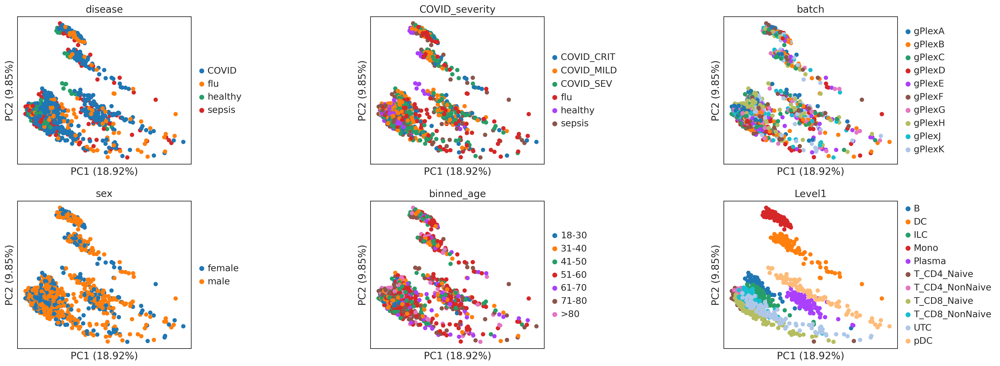

In [54]:
# HVG
#sc.pp.highly_variable_genes(psdata_sampleID, layer="log1p_10e4_counts")

# PCA
sc.pp.pca(psdata, svd_solver="arpack", use_highly_variable=False, n_comps=50)

sc.pl.pca(psdata, color=psdata.obs[[
                                    'disease','COVID_severity',
                                    'batch',
                                    'sex',
                                    'binned_age', "Level1"
                                   ]], 
          ncols=3, size=150, wspace=0.85, annotate_var_explained=True)

### UMAP (on the top 30 PC)

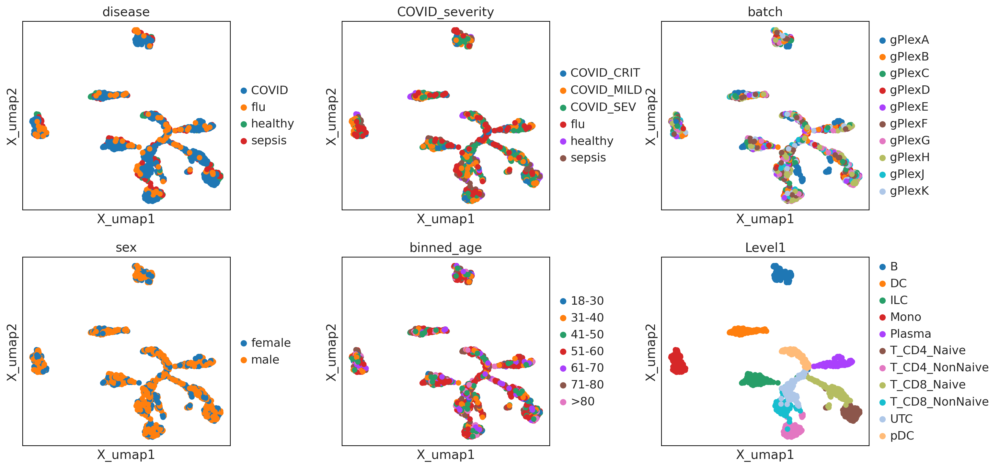

In [55]:
# Computing KNN graph
sc.pp.neighbors(psdata, n_neighbors=20, n_pcs=30)

# UMAP
sc.tl.umap(psdata)

fig = sc.pl.embedding(psdata, basis = 'X_umap',  
                 color=['disease','COVID_severity','batch','sex','binned_age', "Level1"], 
                 wspace = 0.4, size=150, ncols = 3, return_fig=True)

### Leiden clustering

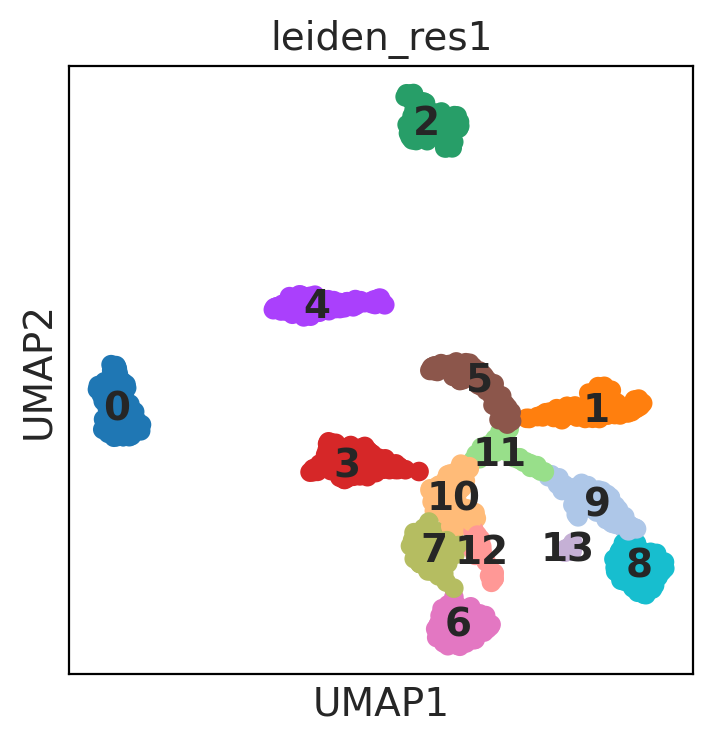

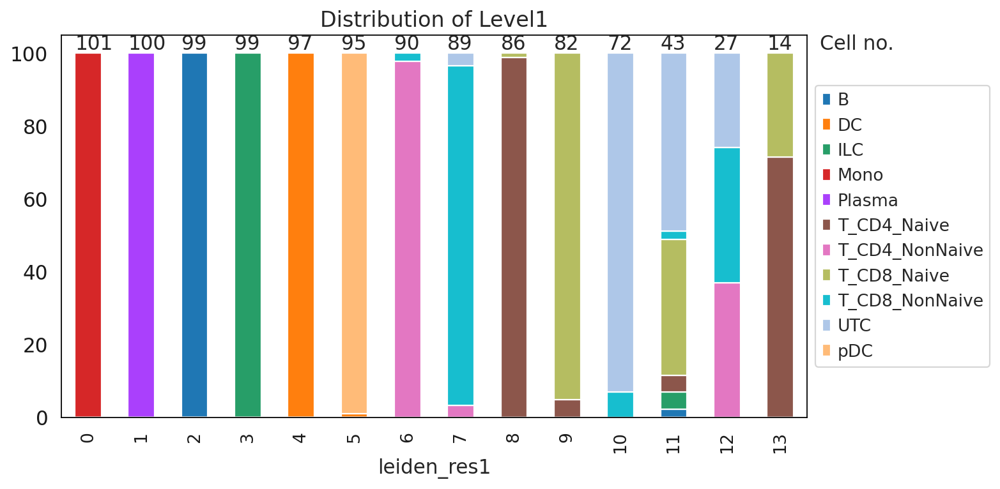

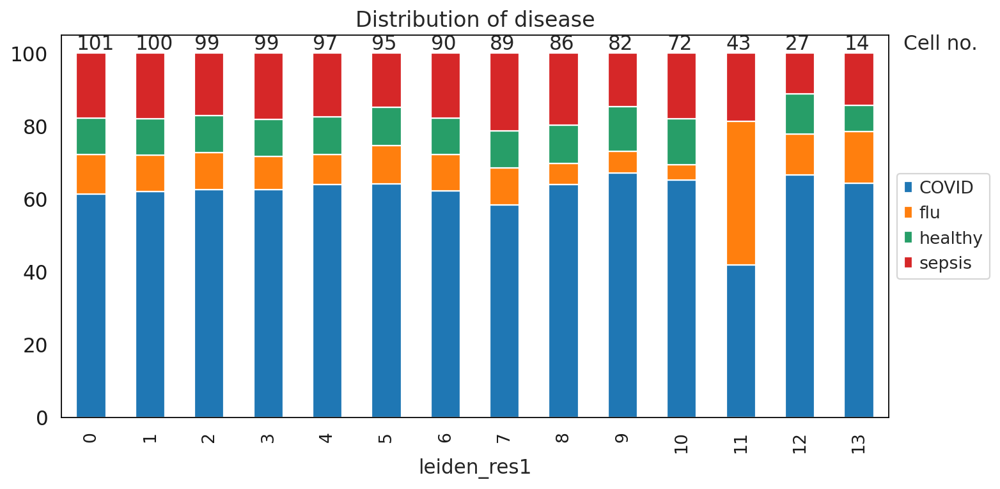

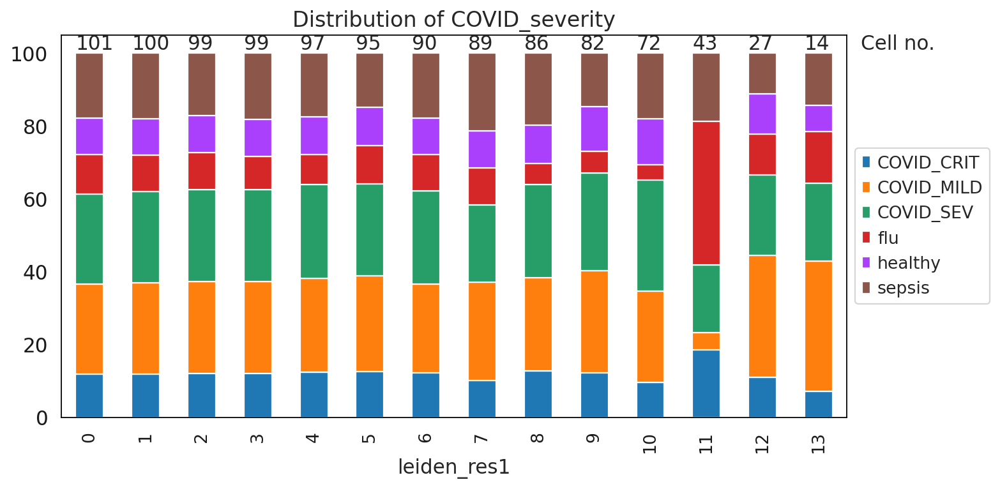

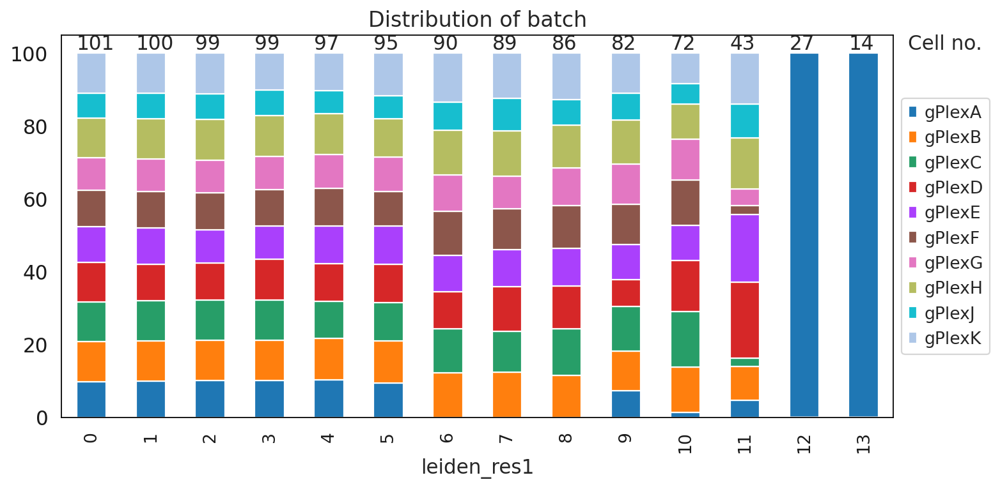

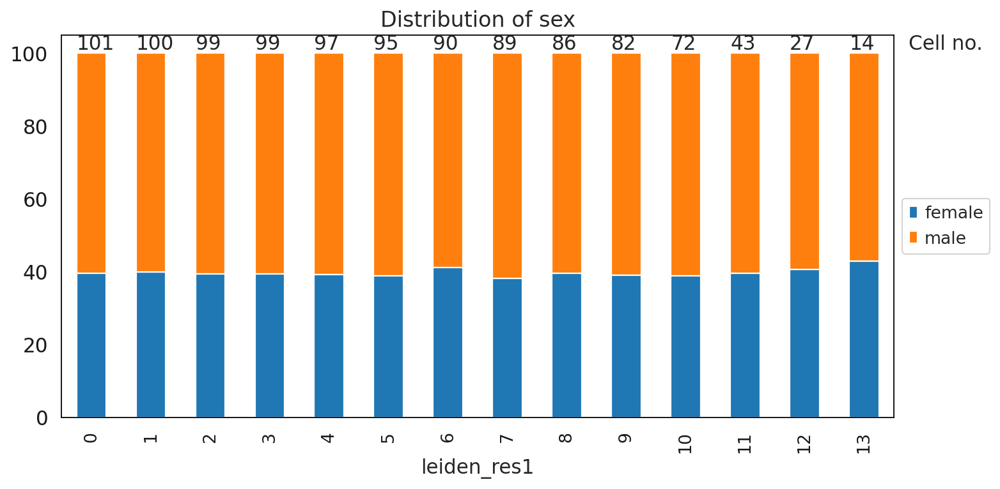

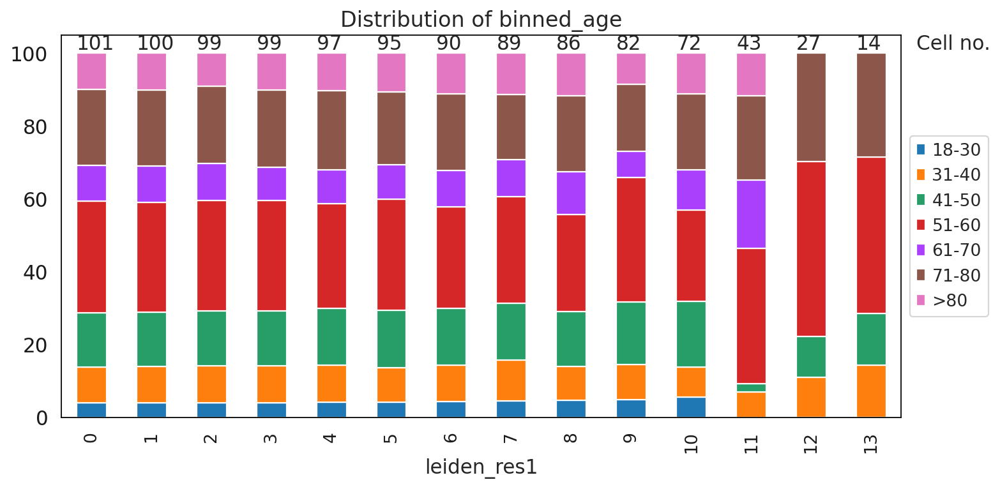

In [56]:
sc.tl.leiden(psdata, key_added="leiden_res1", resolution=1)

sc.pl.umap(
    psdata,
    color=["leiden_res1"],
    legend_loc="on data",
    size=200
)

# Evaluate co-variables distribution across clusters
pdf_pages = PdfPages(here("03_downstream_analysis/06_inflammation_signatures/results/figures/COMBAT2022wSepsis_noncorr_pseudoB-sampleIDLevel1_LeidClust_barplots.pdf"))
for variable in ["Level1", 'disease','COVID_severity','batch','sex','binned_age']:
    sc.set_figure_params(figsize=(10, 5))
    composition_barplot(psdata, xattr="leiden_res1", yattr=variable, title="Distribution of {}".format(variable), save_pdf=pdf_pages)
pdf_pages.close()

### Hierarchical clustering based on 9K gene expression

In [57]:
# Extract Pseudobulk Gene Expression
pseudobulk_df = psdata.to_df()  # Pseudobulk samples (rows) x Genes (columns)
pseudobulk_df.head()

ensembl_gene_id,ENSG00000000003,ENSG00000000457,ENSG00000000938,ENSG00000000971,ENSG00000001036,ENSG00000001084,ENSG00000001167,ENSG00000001460,ENSG00000001461,ENSG00000001561,ENSG00000001630,ENSG00000001631,ENSG00000002016,ENSG00000002330,ENSG00000002549,ENSG00000002586,ENSG00000002587,ENSG00000002822,ENSG00000002933,ENSG00000003147,ENSG00000003249,ENSG00000003400,ENSG00000003402,ENSG00000003436,ENSG00000004059,ENSG00000004139,ENSG00000004142,ENSG00000004399,ENSG00000004468,ENSG00000004478,ENSG00000004487,ENSG00000004700,ENSG00000004766,ENSG00000004799,ENSG00000004846,ENSG00000004939,ENSG00000004975,ENSG00000005007,ENSG00000005020,ENSG00000005059,ENSG00000005102,ENSG00000005187,ENSG00000005206,ENSG00000005243,ENSG00000005249,ENSG00000005339,ENSG00000005379,ENSG00000005381,ENSG00000005436,ENSG00000005469,ENSG00000005471,ENSG00000005486,ENSG00000005812,ENSG00000005844,ENSG00000005882,ENSG00000005884,ENSG00000005961,ENSG00000006015,ENSG00000006025,ENSG00000006125,ENSG00000006194,ENSG00000006210,ENSG00000006282,ENSG00000006327,ENSG00000006432,ENSG00000006459,ENSG00000006530,ENSG00000006534,ENSG00000006555,ENSG00000006576,ENSG00000006607,ENSG00000006625,ENSG00000006634,ENSG00000006638,ENSG00000006652,ENSG00000006715,ENSG00000006740,ENSG00000006757,ENSG00000006837,ENSG00000007038,ENSG00000007047,ENSG00000007129,ENSG00000007202,ENSG00000007237,ENSG00000007255,ENSG00000007264,ENSG00000007312,ENSG00000007350,ENSG00000007376,ENSG00000007392,ENSG00000007402,ENSG00000007516,ENSG00000007520,ENSG00000007541,ENSG00000007545,ENSG00000007944,ENSG00000007968,ENSG00000008056,ENSG00000008083,ENSG00000008086,ENSG00000008130,ENSG00000008226,ENSG00000008256,ENSG00000008277,ENSG00000008283,ENSG00000008294,ENSG00000008300,ENSG00000008311,ENSG00000008382,ENSG00000008394,ENSG00000008441,ENSG00000008513,ENSG00000008517,ENSG00000008710,ENSG00000008869,ENSG00000009335,ENSG00000009413,ENSG00000009694,ENSG00000009790,ENSG00000009950,ENSG00000010030,ENSG00000010165,ENSG00000010219,ENSG00000010270,ENSG00000010278,ENSG00000010292,ENSG00000010295,ENSG00000010310,ENSG00000010318,ENSG00000010319,ENSG00000010327,ENSG00000010404,ENSG00000010539,ENSG00000010610,ENSG00000010671,ENSG00000010704,ENSG00000010803,ENSG00000010810,ENSG00000010818,ENSG00000011028,ENSG00000011105,ENSG00000011114,ENSG00000011143,ENSG00000011198,ENSG00000011258,ENSG00000011295,ENSG00000011376,ENSG00000011422,ENSG00000011451,ENSG00000011523,...,ENSG00000258366,ENSG00000258429,ENSG00000258472,ENSG00000258484,ENSG00000258659,ENSG00000258818,ENSG00000258839,ENSG00000258890,ENSG00000259207,ENSG00000259431,ENSG00000259956,ENSG00000260001,ENSG00000260314,ENSG00000260456,ENSG00000261052,ENSG00000261150,ENSG00000261221,ENSG00000261236,ENSG00000261371,ENSG00000261609,ENSG00000262246,ENSG00000262655,ENSG00000262814,ENSG00000262919,ENSG00000263002,ENSG00000263155,ENSG00000263465,ENSG00000263528,ENSG00000263874,ENSG00000263961,ENSG00000264343,ENSG00000264364,ENSG00000264522,ENSG00000265491,ENSG00000265808,ENSG00000265972,ENSG00000266028,ENSG00000266094,ENSG00000266173,ENSG00000266338,ENSG00000266412,ENSG00000266714,ENSG00000266964,ENSG00000266967,ENSG00000267041,ENSG00000267368,ENSG00000267534,ENSG00000267673,ENSG00000267680,ENSG00000267796,ENSG00000267855,ENSG00000268350,ENSG00000269028,ENSG00000269313,ENSG00000269343,ENSG00000269404,ENSG00000269713,ENSG00000269858,ENSG00000270170,ENSG00000270629,ENSG00000270672,ENSG00000271254,ENSG00000271303,ENSG00000271383,ENSG00000271425,ENSG00000271447,ENSG00000271503,ENSG00000271601,ENSG00000271605,ENSG00000272047,ENSG00000272325,ENSG00000272333,ENSG00000272391,ENSG00000272398,ENSG00000272602,ENSG00000272886,ENSG00000273045,ENSG00000273136,ENSG00000273173,ENSG00000273274,ENSG00000273748,ENSG00000273802,ENSG00000273899,ENSG00000274070,ENSG00000274180,ENSG00000274211,ENSG00000274290,ENSG00000274349,ENSG00000274523,ENSG00000274588,ENSG00000274618,ENSG00000274736,ENSG00000274847,ENSG00000274997,ENSG00000275004,ENSG00000275023,ENSG00000275063,ENSG00000275066,ENSG00000275

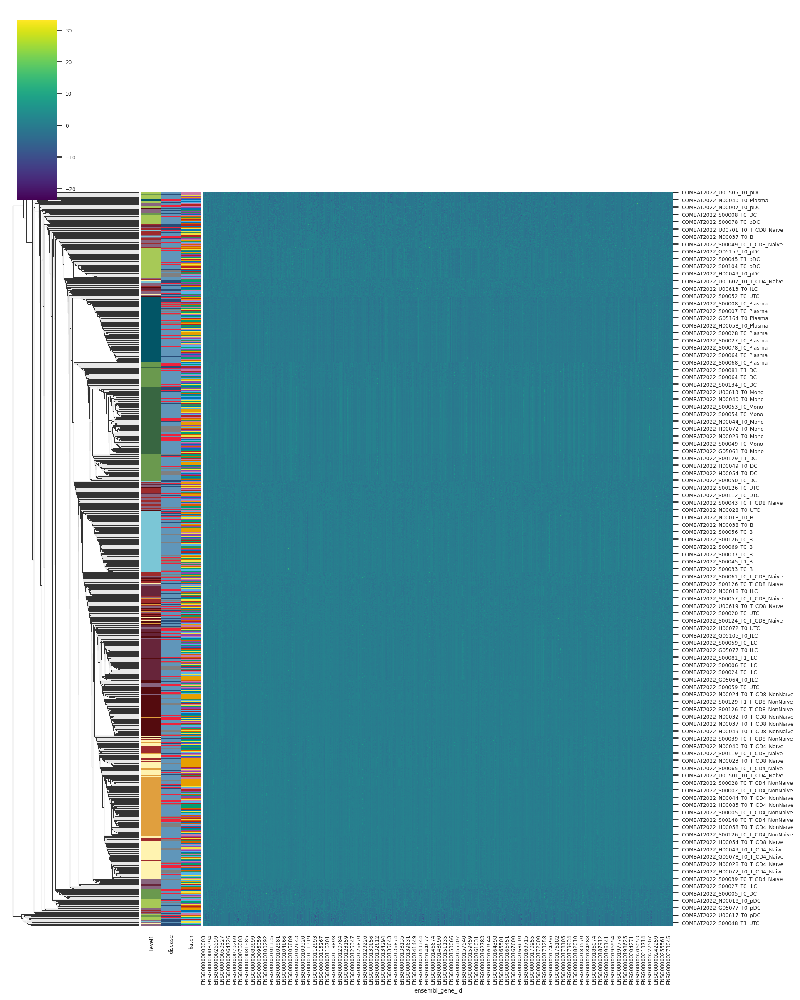

In [58]:
# Heatmap with Cell Type & Disease Annotation

# Create metadata DataFrame for annotations
metadata = psdata.obs[["Level1", "disease", "batch"]]  # Extract metadata

sns.set(font_scale=0.5)

# Plot clustered heatmap with metadata
g = sns.clustermap(
    pseudobulk_df, 
    row_cluster=True, 
    col_cluster=False, 
    method='average', metric='euclidean', 
    cmap="viridis",
    figsize=(12, 15),
    row_colors=metadata.replace({"Level1": annotation_Level1_palette, "disease": diseases_palette,
                                "batch" : batch_palette})  # , "sex": sex_palette, "binned_age" : binned_age_palette
)

# Save as PDF
g.savefig(here("03_downstream_analysis/06_inflammation_signatures/results/figures/COMBAT2022wSepsis_noncorr_pseudoB-sampleIDLevel1_clustermap_covariates.pdf"),
          format="pdf", dpi=300, bbox_inches="tight", pad_inches=0)
plt.show()

### Hierarchical clustering based on top 30 PC

In [59]:
# Extract Pseudobulk Gene Expression
pseudobulk_PC_df = pd.DataFrame(psdata.obsm["X_pca"][:, 1:31], index=psdata.obs.index)
pseudobulk_PC_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29
COMBAT2022_G05061_T0_B,6.311531,-42.902020,-10.598450,8.692700,27.584389,9.697235,4.743054,4.049906,-2.873965,8.967827,3.952602,-0.773190,0.614378,2.190040,1.594937,-0.325552,0.632796,0.208939,-0.619836,-0.761631,-0.296351,-0.676157,0.847076,-0.136124,1.503027,-0.426465,1.158146,0.236481,0.153353,-0.003059
COMBAT2022_G05064_T0_B,8.103372,-41.255390,-12.203712,7.894655,23.741348,15.796192,26.567406,4.403606,-2.968456,5.313164,1.297944,-0.835633,1.360949,0.923143,-0.539573,-1.009984,2.103557,-0.021616,-0.936333,-0.250093,-0.026990,1.071516,1.187029,0.593956,0.242890,-0.025144,1.619820,-0.242656,-0.163867,-0.155653
COMBAT2022_G05077_T0_B,2.209816,-39.476044,-11.302382,8.045453,28.417364,7.256200,-2.181345,3.424752,-5.584746,12.199010,2.241693,-0.989642,1.428752,1.136592,-0.860927,-0.489408,-0.035336,0.316328,-0.923610,-0.170533,-1.445545,0.310285,1.647159,-0.457154,1.448021,0.705525,2.451737,-0.046135,-0.880191,0.245519
COMBAT2022_G05078_T0_B,-5.480134,-39.744251,-5.575265,6.180922,33.920704,3.231332,4.518806,3.545296,-9.270221,13.641443,1.239940,0.828848,1.542978,-1.015728,-2.474035,2.102478,-0.068408,-0.231568,-0.178448,0.469849,1.351520,-1.247805,-1.600351,2.173776,-1.754858,0.459668,0.186978,0.750755,0.463682,1.153249
COMBAT2022_G05105_T0_B,9.155802,-38.107990,-12.278464,6.762214,26.596981,8.211844,-5.097667,3.971910,-3.699834,10.215166,2.203413,-1.440662,2.308190,1.804398,0.421313,-2.010250,-0.217871,-0.824442,-0.649720,-0.662544,-2.721758,0.601727,1.483070,-0.613833,1.710714,-0.476661,1.683249,0.474786,-1.925258,-1.435416


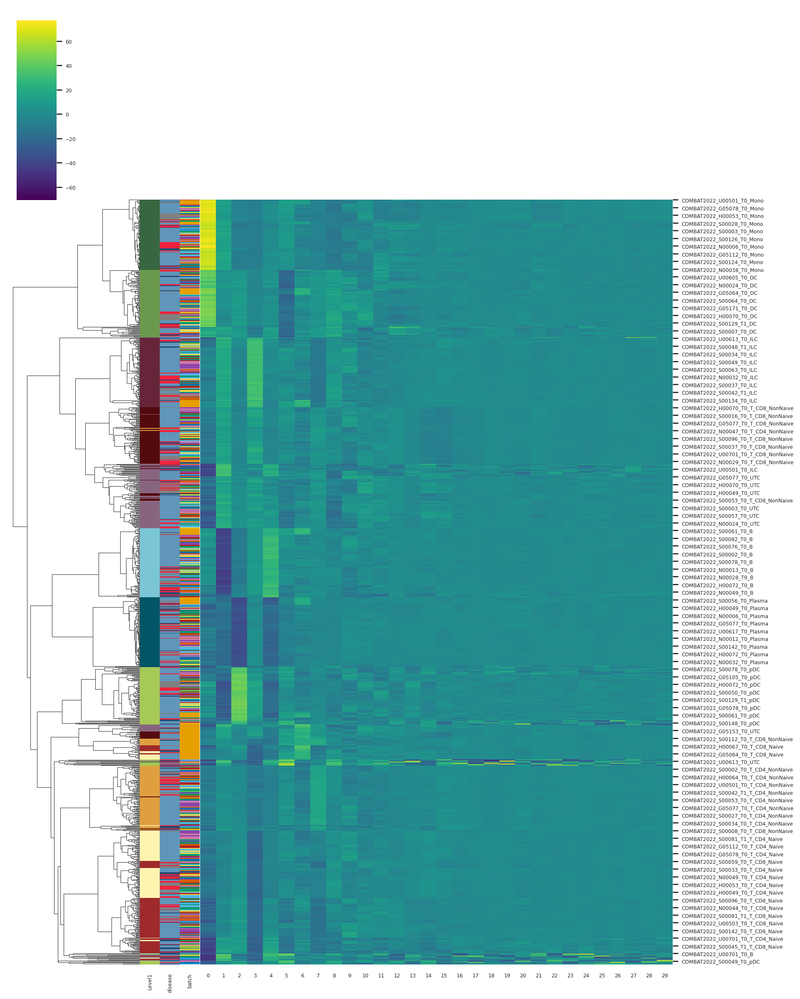

In [60]:
# Heatmap with Cell Type & Disease Annotation

# Create metadata DataFrame for annotations
metadata_sampleID = psdata.obs[['Level1', "disease", "batch"]]  # Extract metadata

# Plot clustered heatmap with metadata
sns.set(font_scale=0.5)
g = sns.clustermap(
    pseudobulk_PC_df, 
    col_cluster=False, 
    method='average', metric='cosine', 
    cmap="viridis",
    figsize=(12, 15),
    row_colors=metadata_sampleID.replace({"Level1": annotation_Level1_palette, "disease": diseases_palette,
                                "batch" : batch_palette})
)

# Save as PDF
g.savefig(here("03_downstream_analysis/06_inflammation_signatures/results/figures/COMBAT2022wSepsis_noncorr-PCA_pseudoB-sampleIDLevel1_clustermap_covariates.pdf"),
          format="pdf", dpi=300, bbox_inches="tight", pad_inches=0)
plt.show()

## Pseudobulk per sampleID

In [61]:
# Pseudobulk per patient and cell type, keeping disease
psdata_sampleID = dc.get_pseudobulk(adata=adata, 
                                 min_cells=0, 
                                 sample_col = 'sampleID',
                                 groups_col='sampleID', 
                                 layer=None,#'counts', 
                                 mode='sum')

psdata_sampleID.layers['counts'] = psdata_sampleID.X.copy()
psdata_sampleID

AnnData object with n_obs × n_vars = 101 × 8249
    obs: 'studyID', 'sampleID', 'chemistry', 'disease', 'sex', 'binned_age', 'batch', 'COVID_severity', 'psbulk_n_cells', 'psbulk_counts'
    var: 'hgnc_id', 'symbol', 'locus_group', 'HUGO_status', 'highly_variable'
    layers: 'psbulk_props', 'counts'

In [62]:
sc.pp.normalize_total(psdata_sampleID, target_sum=1e6)
sc.pp.log1p(psdata_sampleID)
psdata_sampleID.layers["log1p_10e4_counts"] = psdata_sampleID.X.copy()
sc.pp.scale(psdata_sampleID)

In [63]:
psdata_sampleID

AnnData object with n_obs × n_vars = 101 × 8249
    obs: 'studyID', 'sampleID', 'chemistry', 'disease', 'sex', 'binned_age', 'batch', 'COVID_severity', 'psbulk_n_cells', 'psbulk_counts'
    var: 'hgnc_id', 'symbol', 'locus_group', 'HUGO_status', 'highly_variable', 'mean', 'std'
    uns: 'log1p'
    layers: 'psbulk_props', 'counts', 'log1p_10e4_counts'

### PCA

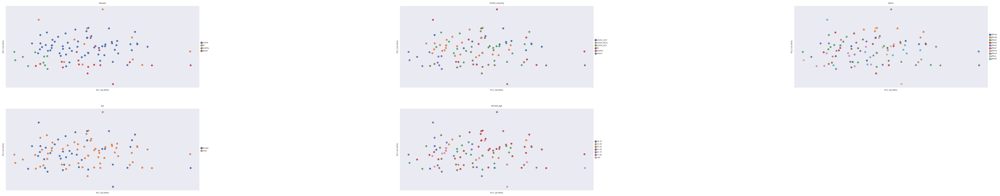

In [64]:
# HVG
#sc.pp.highly_variable_genes(psdata_sampleID, layer="log1p_10e4_counts")

# PCA
sc.pp.pca(psdata_sampleID, svd_solver="arpack", use_highly_variable=False, n_comps=50)

sc.pl.pca(psdata_sampleID, color=psdata_sampleID.obs[[
                                    'disease','COVID_severity',
                                    'batch',
                                    'sex',
                                    'binned_age'
                                   ]], 
          ncols=3, size=150, wspace=0.85, annotate_var_explained=True)

### UMAP (on the top 30 PC)

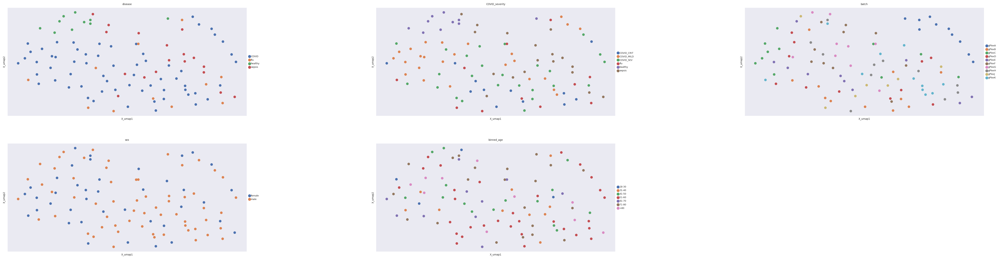

In [65]:
# Computing KNN graph
sc.pp.neighbors(psdata_sampleID, n_neighbors=20, n_pcs=30)

# UMAP
sc.tl.umap(psdata_sampleID)

fig = sc.pl.embedding(psdata_sampleID, basis = 'X_umap',  
                 color=['disease','COVID_severity','batch','sex','binned_age'], 
                 wspace = 0.4, size=150, ncols = 3, return_fig=True)

### Leiden clustering

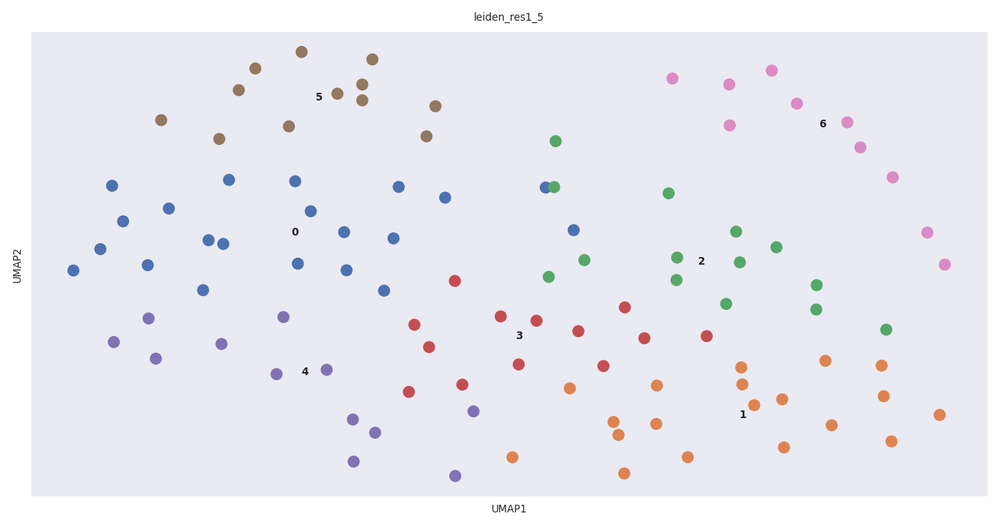

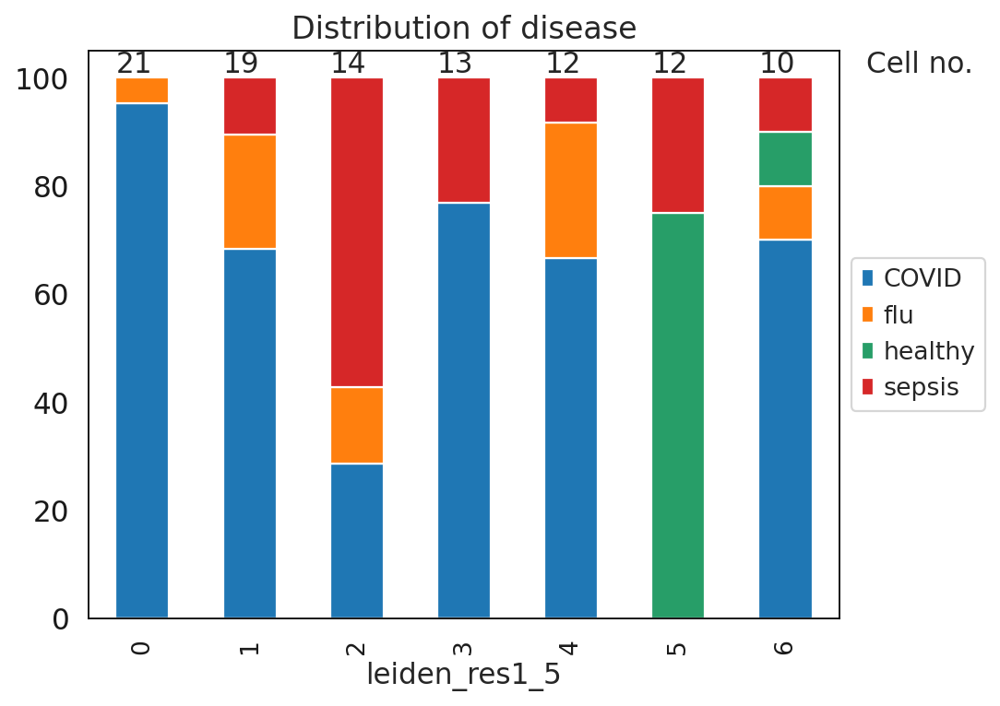

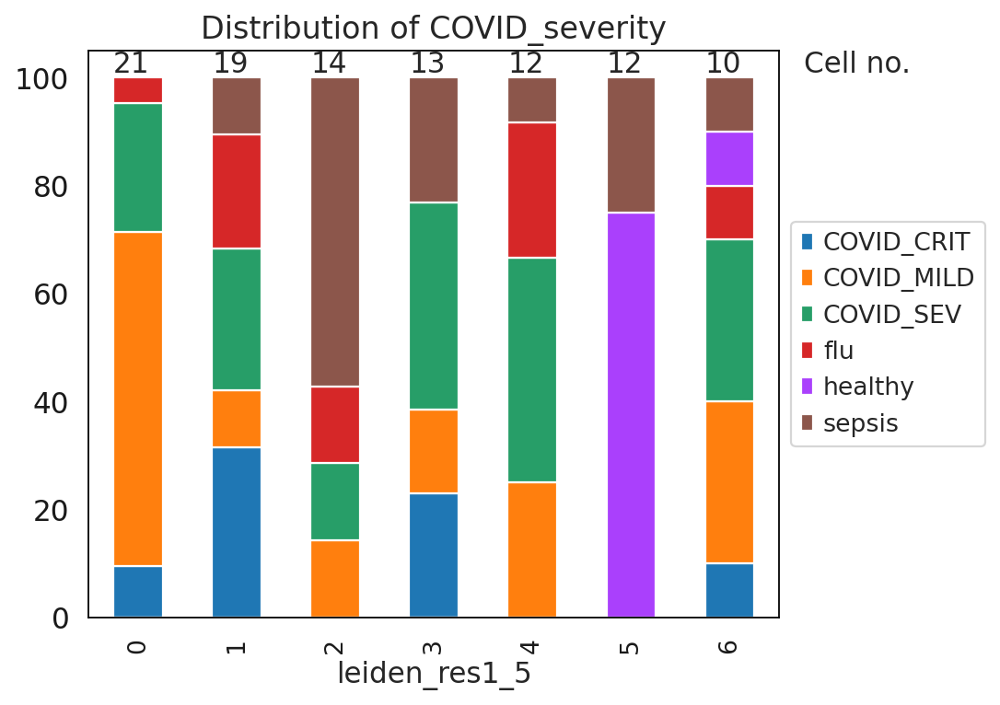

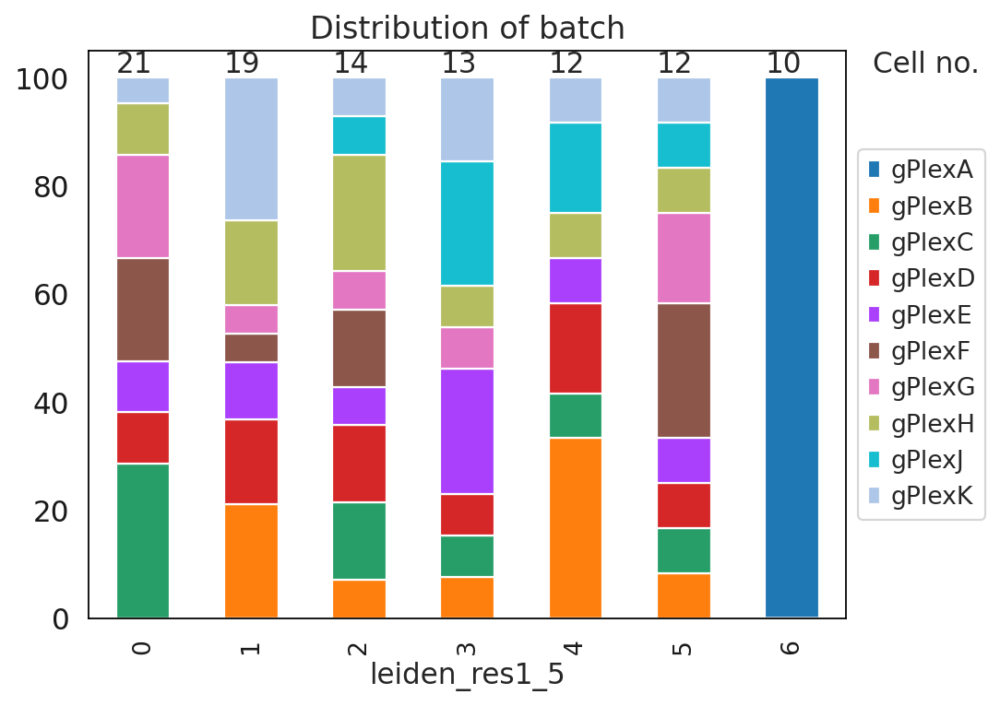

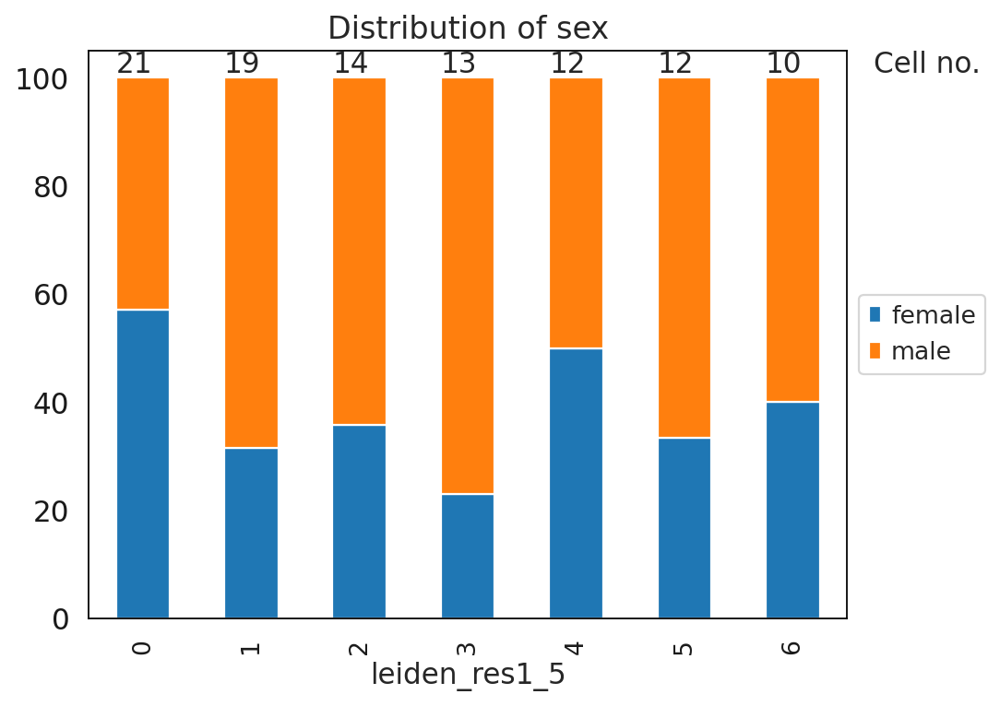

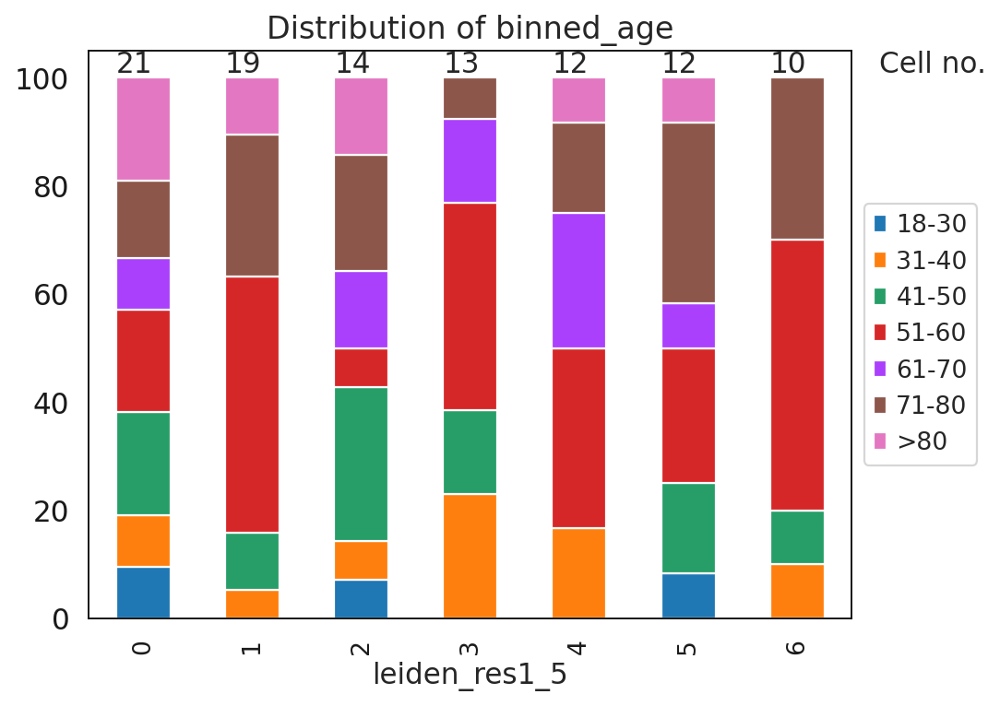

In [66]:
sc.tl.leiden(psdata_sampleID, key_added="leiden_res1_5", resolution=1.5)

sc.pl.umap(
    psdata_sampleID,
    color=["leiden_res1_5"],
    legend_loc="on data",
    size=200
)

# Evaluate co-variables distribution across clusters
pdf_pages = PdfPages(here("03_downstream_analysis/06_inflammation_signatures/results/figures/COMBAT2022wSepsis_noncorr_pseudoB-sampleID_LeidClust_barplots.pdf"))
for variable in ['disease','COVID_severity','batch','sex','binned_age']:
    sc.set_figure_params(figsize=(7, 5))
    composition_barplot(psdata_sampleID, xattr="leiden_res1_5", yattr=variable, title="Distribution of {}".format(variable), save_pdf=pdf_pages)
pdf_pages.close()

### Hierarchical clustering based on 9K gene expression

In [67]:
# Extract Pseudobulk Gene Expression
pseudobulk_sampleID_df = psdata_sampleID.to_df()  # Genes (rows) × Pseudobulk samples (columns)
pseudobulk_sampleID_df.head()

ensembl_gene_id,ENSG00000000003,ENSG00000000457,ENSG00000000938,ENSG00000000971,ENSG00000001036,ENSG00000001084,ENSG00000001167,ENSG00000001460,ENSG00000001461,ENSG00000001561,ENSG00000001630,ENSG00000001631,ENSG00000002016,ENSG00000002330,ENSG00000002549,ENSG00000002586,ENSG00000002587,ENSG00000002822,ENSG00000002933,ENSG00000003147,ENSG00000003249,ENSG00000003400,ENSG00000003402,ENSG00000003436,ENSG00000004059,ENSG00000004139,ENSG00000004142,ENSG00000004399,ENSG00000004468,ENSG00000004478,ENSG00000004487,ENSG00000004700,ENSG00000004766,ENSG00000004799,ENSG00000004846,ENSG00000004939,ENSG00000004975,ENSG00000005007,ENSG00000005020,ENSG00000005059,ENSG00000005102,ENSG00000005187,ENSG00000005206,ENSG00000005243,ENSG00000005249,ENSG00000005339,ENSG00000005379,ENSG00000005381,ENSG00000005436,ENSG00000005469,ENSG00000005471,ENSG00000005486,ENSG00000005812,ENSG00000005844,ENSG00000005882,ENSG00000005884,ENSG00000005961,ENSG00000006015,ENSG00000006025,ENSG00000006125,ENSG00000006194,ENSG00000006210,ENSG00000006282,ENSG00000006327,ENSG00000006432,ENSG00000006459,ENSG00000006530,ENSG00000006534,ENSG00000006555,ENSG00000006576,ENSG00000006607,ENSG00000006625,ENSG00000006634,ENSG00000006638,ENSG00000006652,ENSG00000006715,ENSG00000006740,ENSG00000006757,ENSG00000006837,ENSG00000007038,ENSG00000007047,ENSG00000007129,ENSG00000007202,ENSG00000007237,ENSG00000007255,ENSG00000007264,ENSG00000007312,ENSG00000007350,ENSG00000007376,ENSG00000007392,ENSG00000007402,ENSG00000007516,ENSG00000007520,ENSG00000007541,ENSG00000007545,ENSG00000007944,ENSG00000007968,ENSG00000008056,ENSG00000008083,ENSG00000008086,ENSG00000008130,ENSG00000008226,ENSG00000008256,ENSG00000008277,ENSG00000008283,ENSG00000008294,ENSG00000008300,ENSG00000008311,ENSG00000008382,ENSG00000008394,ENSG00000008441,ENSG00000008513,ENSG00000008517,ENSG00000008710,ENSG00000008869,ENSG00000009335,ENSG00000009413,ENSG00000009694,ENSG00000009790,ENSG00000009950,ENSG00000010030,ENSG00000010165,ENSG00000010219,ENSG00000010270,ENSG00000010278,ENSG00000010292,ENSG00000010295,ENSG00000010310,ENSG00000010318,ENSG00000010319,ENSG00000010327,ENSG00000010404,ENSG00000010539,ENSG00000010610,ENSG00000010671,ENSG00000010704,ENSG00000010803,ENSG00000010810,ENSG00000010818,ENSG00000011028,ENSG00000011105,ENSG00000011114,ENSG00000011143,ENSG00000011198,ENSG00000011258,ENSG00000011295,ENSG00000011376,ENSG00000011422,ENSG00000011451,ENSG00000011523,...,ENSG00000258366,ENSG00000258429,ENSG00000258472,ENSG00000258484,ENSG00000258659,ENSG00000258818,ENSG00000258839,ENSG00000258890,ENSG00000259207,ENSG00000259431,ENSG00000259956,ENSG00000260001,ENSG00000260314,ENSG00000260456,ENSG00000261052,ENSG00000261150,ENSG00000261221,ENSG00000261236,ENSG00000261371,ENSG00000261609,ENSG00000262246,ENSG00000262655,ENSG00000262814,ENSG00000262919,ENSG00000263002,ENSG00000263155,ENSG00000263465,ENSG00000263528,ENSG00000263874,ENSG00000263961,ENSG00000264343,ENSG00000264364,ENSG00000264522,ENSG00000265491,ENSG00000265808,ENSG00000265972,ENSG00000266028,ENSG00000266094,ENSG00000266173,ENSG00000266338,ENSG00000266412,ENSG00000266714,ENSG00000266964,ENSG00000266967,ENSG00000267041,ENSG00000267368,ENSG00000267534,ENSG00000267673,ENSG00000267680,ENSG00000267796,ENSG00000267855,ENSG00000268350,ENSG00000269028,ENSG00000269313,ENSG00000269343,ENSG00000269404,ENSG00000269713,ENSG00000269858,ENSG00000270170,ENSG00000270629,ENSG00000270672,ENSG00000271254,ENSG00000271303,ENSG00000271383,ENSG00000271425,ENSG00000271447,ENSG00000271503,ENSG00000271601,ENSG00000271605,ENSG00000272047,ENSG00000272325,ENSG00000272333,ENSG00000272391,ENSG00000272398,ENSG00000272602,ENSG00000272886,ENSG00000273045,ENSG00000273136,ENSG00000273173,ENSG00000273274,ENSG00000273748,ENSG00000273802,ENSG00000273899,ENSG00000274070,ENSG00000274180,ENSG00000274211,ENSG00000274290,ENSG00000274349,ENSG00000274523,ENSG00000274588,ENSG00000274618,ENSG00000274736,ENSG00000274847,ENSG00000274997,ENSG00000275004,ENSG00000275023,ENSG00000275063,ENSG00000275066,ENSG00000275

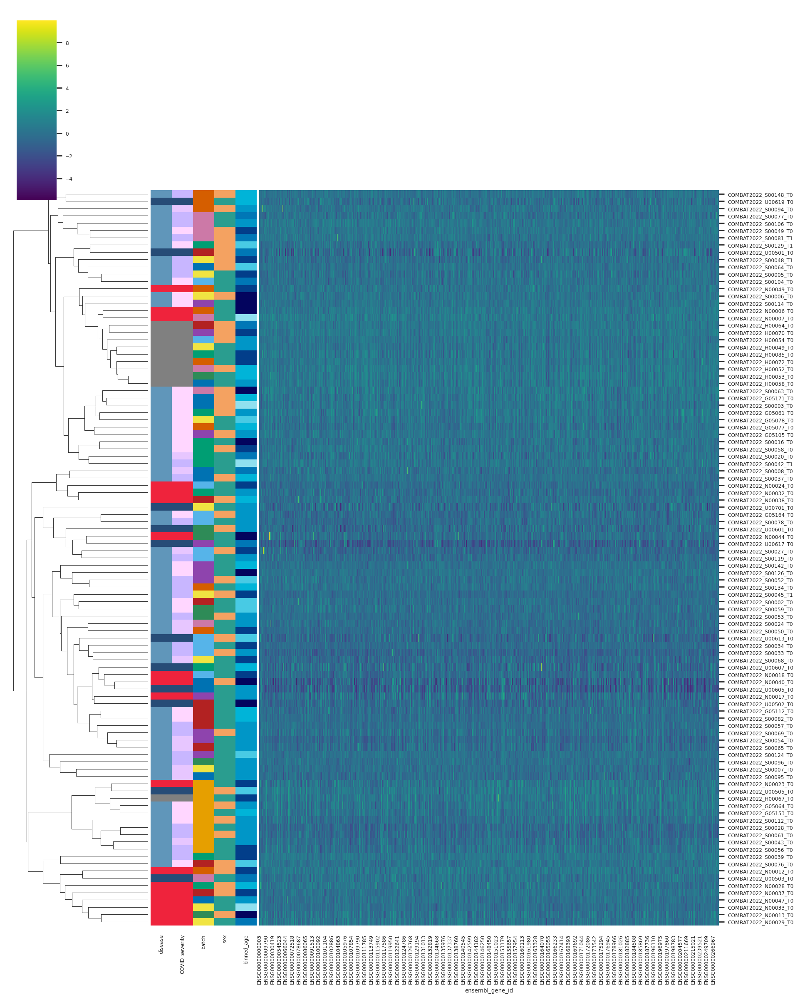

In [68]:
# Heatmap with Cell Type & Disease Annotation

# Create metadata DataFrame for annotations
metadata_sampleID = psdata_sampleID.obs[["disease", 'COVID_severity', "batch", "sex", "binned_age"]]  # Extract metadata

# Plot clustered heatmap with metadata
sns.set(font_scale=0.5)
g = sns.clustermap(
    pseudobulk_sampleID_df, 
    col_cluster=False, 
    method='average', metric='cosine', 
    cmap="viridis",
    figsize=(12, 15),
    row_colors=metadata_sampleID.replace({"disease": diseases_palette, "COVID_severity": COVID_severity_palette,
                                          "sex": sex_palette, "binned_age" : binned_age_palette,
                                         "batch" : batch_palette})
)

# Save as PDF
g.savefig(here("03_downstream_analysis/06_inflammation_signatures/results/figures/COMBAT2022wSepsis_noncorr_pseudoB-sampleID_clustermap_covariates.pdf"),
          format="pdf", dpi=300, bbox_inches="tight", pad_inches=0)
plt.show()

### Hierarchical clustering based on top 30 PC

In [69]:
# Extract Pseudobulk Gene Expression
pseudobulk_sampleID_PC_df = pd.DataFrame(psdata_sampleID.obsm["X_pca"][:, 1:31], index=psdata_sampleID.obs.index)
pseudobulk_sampleID_PC_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29
COMBAT2022_G05061_T0,1.999084,20.650402,36.048977,5.553425,13.461620,7.179296,-6.103907,8.645013,16.535221,4.809696,1.873868,11.137270,7.013884,5.400494,3.277487,-2.794414,2.223157,2.623645,1.276163,-4.932404,2.505149,1.030632,5.586082,10.808002,7.104244,14.187204,-4.482006,2.631163,0.402497,-10.106062
COMBAT2022_G05064_T0,11.195650,85.849213,4.105627,-2.828358,-0.051189,6.855997,-7.171402,12.624562,2.340954,7.167875,-9.857857,-3.064937,-4.270382,-0.965901,3.930820,4.980134,-7.529619,-2.748329,5.715025,0.541386,3.219401,2.819789,1.393934,-2.372092,0.979944,-5.872204,4.367345,3.215313,0.202583,-2.151729
COMBAT2022_G05077_T0,17.804054,-0.278047,55.441566,9.674021,29.065895,-3.218499,-3.499945,17.616819,-0.398759,6.056122,6.438061,-8.363234,-11.564713,8.103904,-0.911326,-6.414328,-2.167804,-5.720735,-9.520556,-6.325575,-5.843390,-1.116413,-1.653053,-4.673938,6.177497,3.430336,-5.151311,1.727603,-10.110994,2.984653
COMBAT2022_G05078_T0,5.190691,21.797850,47.305962,16.533014,4.466604,-15.609058,-2.441118,24.711708,5.314748,1.274027,-1.819329,-11.760019,4.318871,7.956088,2.988643,-5.107504,-5.246924,-4.636436,8.235604,1.226476,2.126330,2.237025,-1.419601,8.862212,6.370129,1.570077,-1.497204,9.371431,-2.646604,9.069239
COMBAT2022_G05105_T0,-10.361888,6.266890,51.622341,-1.761285,7.923549,-5.833504,-12.791522,8.537952,-2.273773,-7.455384,4.112801,-13.513828,0.371997,-0.716698,6.706775,2.265334,-1.117039,-0.845750,-5.731885,-9.816031,3.498964,2.121300,-2.587523,0.637491,-4.791964,-2.087972,0.356700,3.641161,5.097032,-0.521149


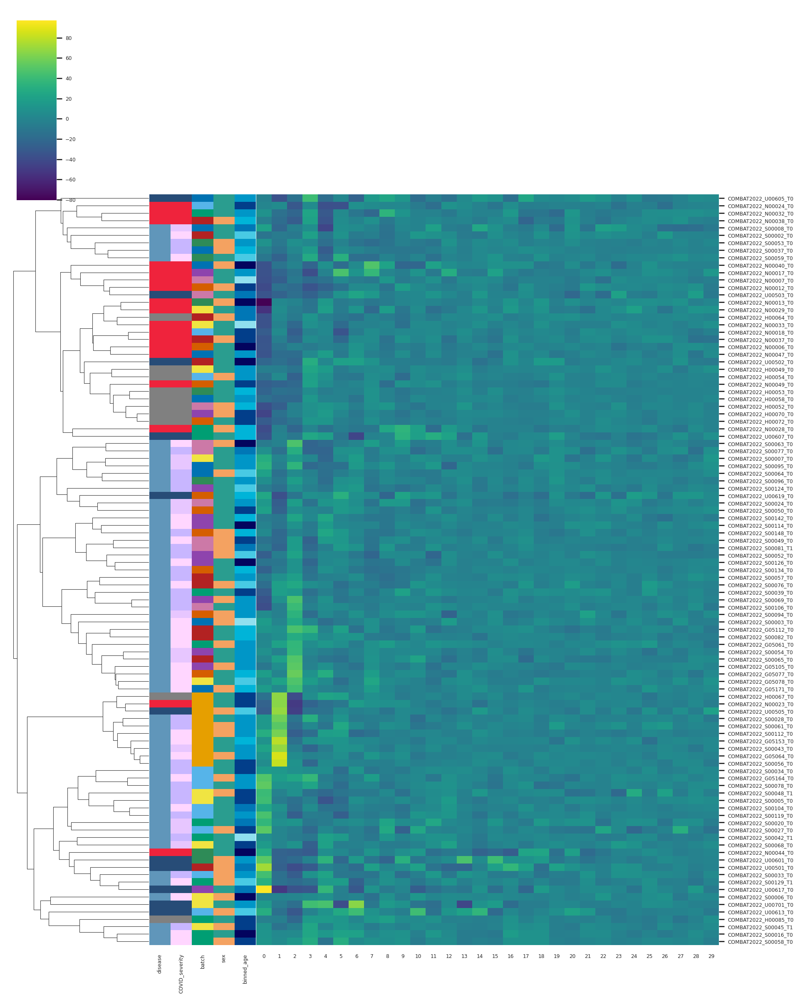

In [70]:
# Heatmap with Cell Type & Disease Annotation

# Create metadata DataFrame for annotations
metadata_sampleID = psdata_sampleID.obs[["disease", 'COVID_severity',"batch", "sex", "binned_age"]]  # Extract metadata

# Plot clustered heatmap with metadata
sns.set(font_scale=0.5)
g = sns.clustermap(
    pseudobulk_sampleID_PC_df, 
    col_cluster=False, 
    method='average', metric='cosine', 
    cmap="viridis",
    figsize=(12, 15),
    row_colors=metadata_sampleID.replace({"disease": diseases_palette, "COVID_severity": COVID_severity_palette,
                                          "sex": sex_palette, "binned_age" : binned_age_palette,
                                         "batch" : batch_palette})
)

# Save as PDF
g.savefig(here("03_downstream_analysis/06_inflammation_signatures/results/figures/COMBAT2022wSepsis_noncorr-PCA_pseudoB-sampleID_clustermap_covariates.pdf"),
          format="pdf", dpi=300, bbox_inches="tight", pad_inches=0)
plt.show()

## Pseudobulk per sampleID WITHIN Level1 celltype

B


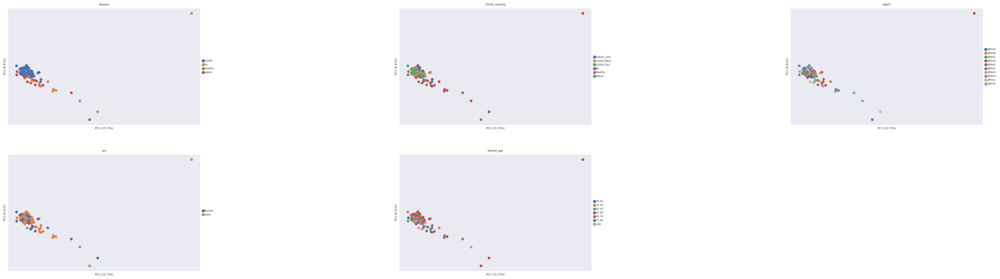

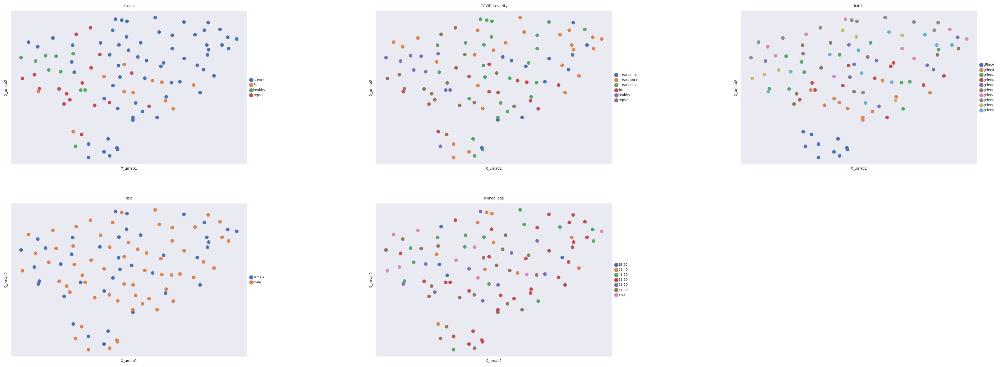

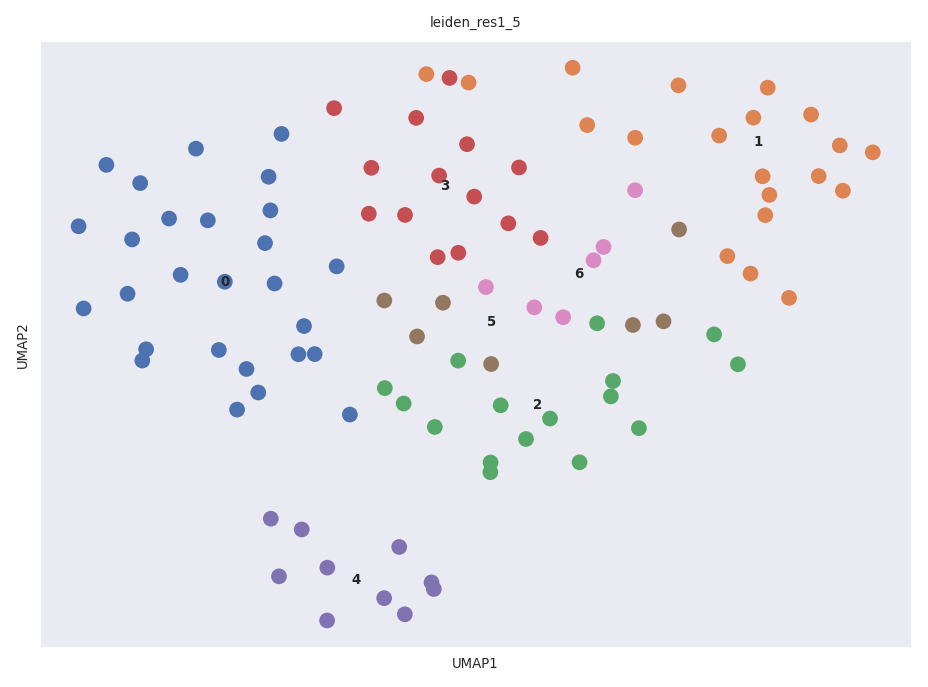

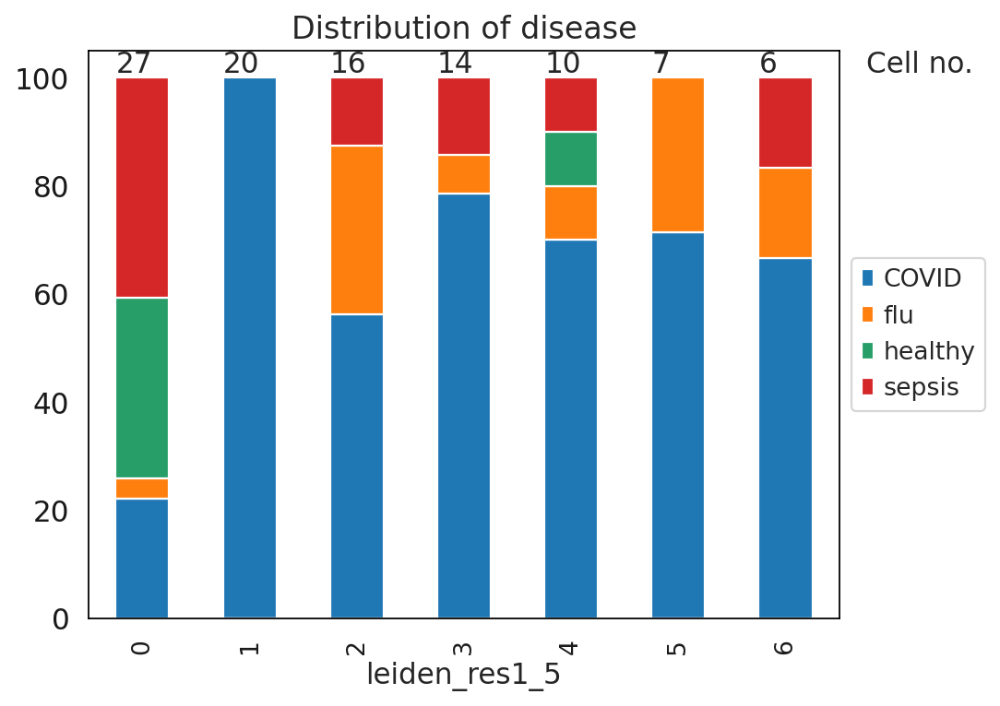

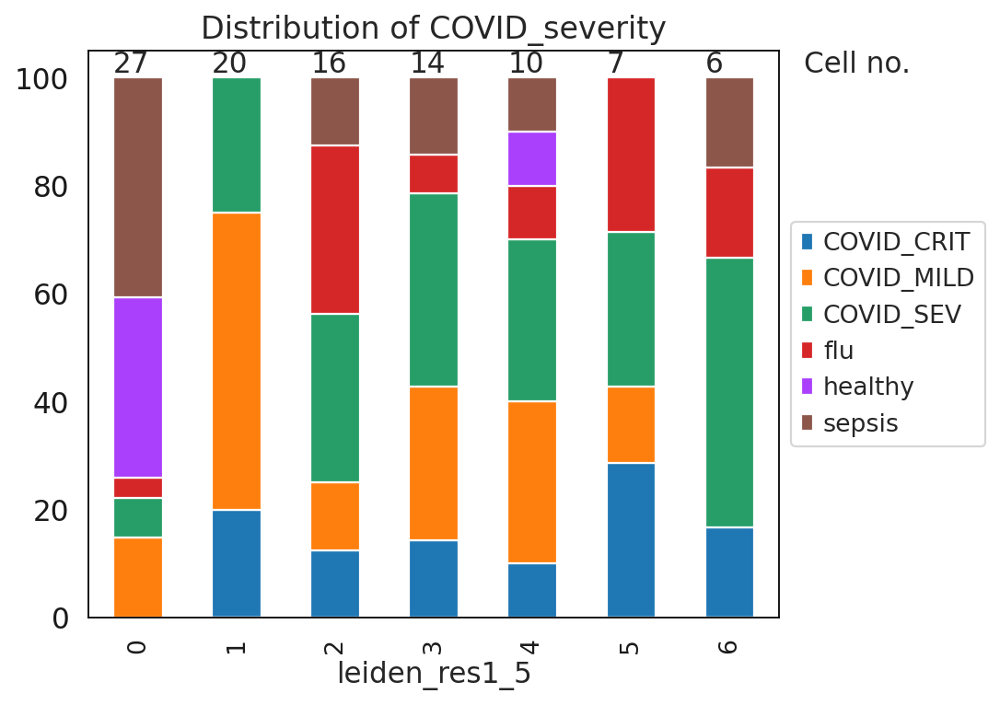

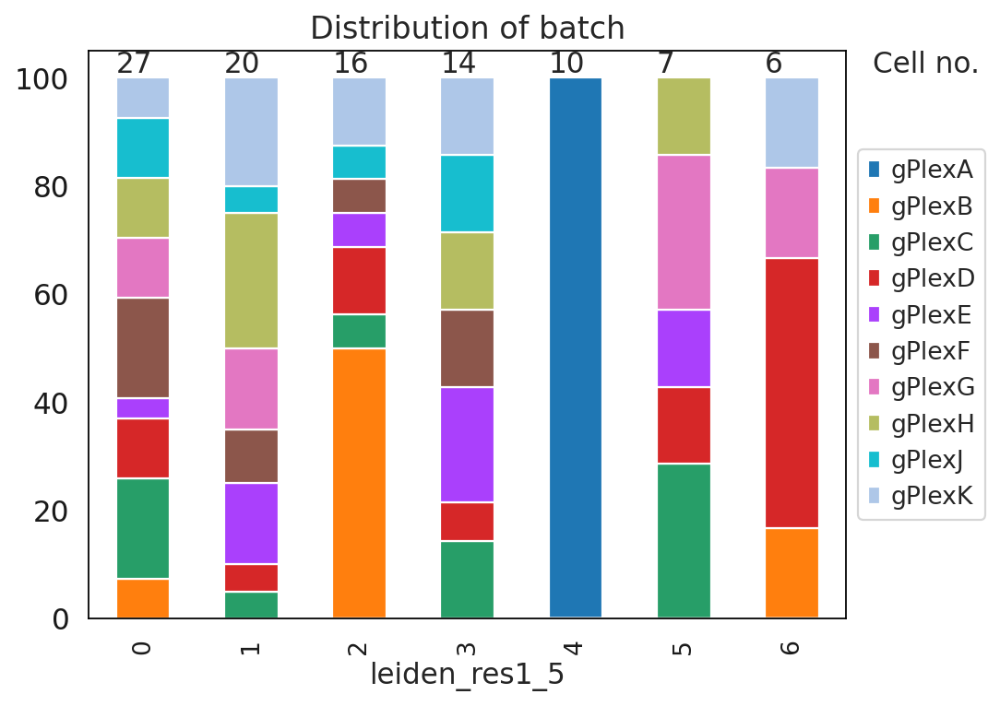

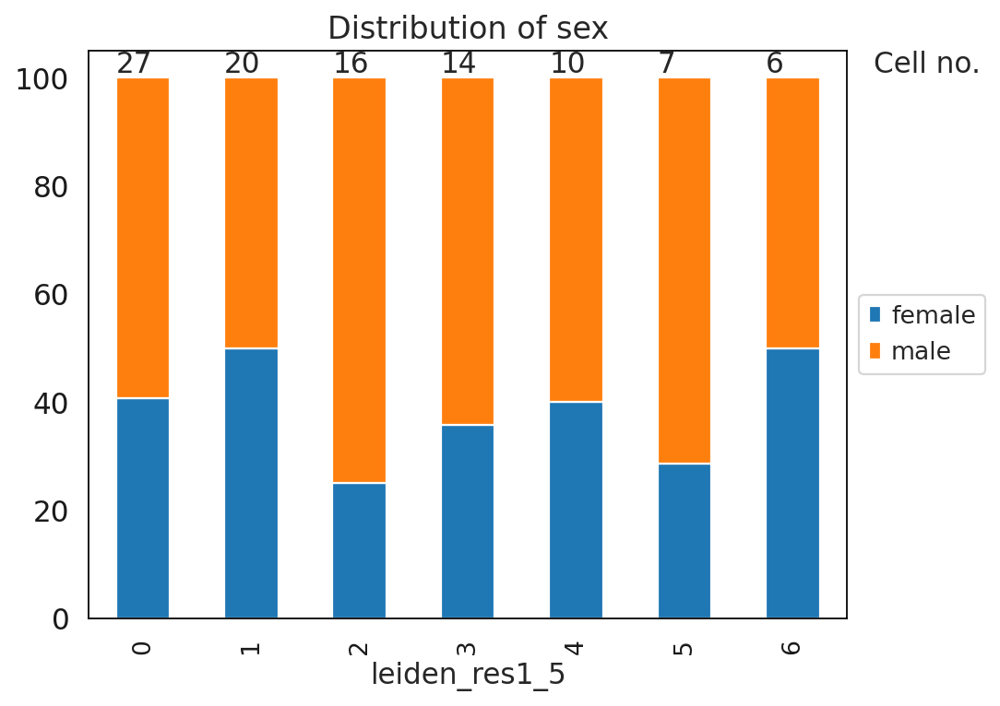

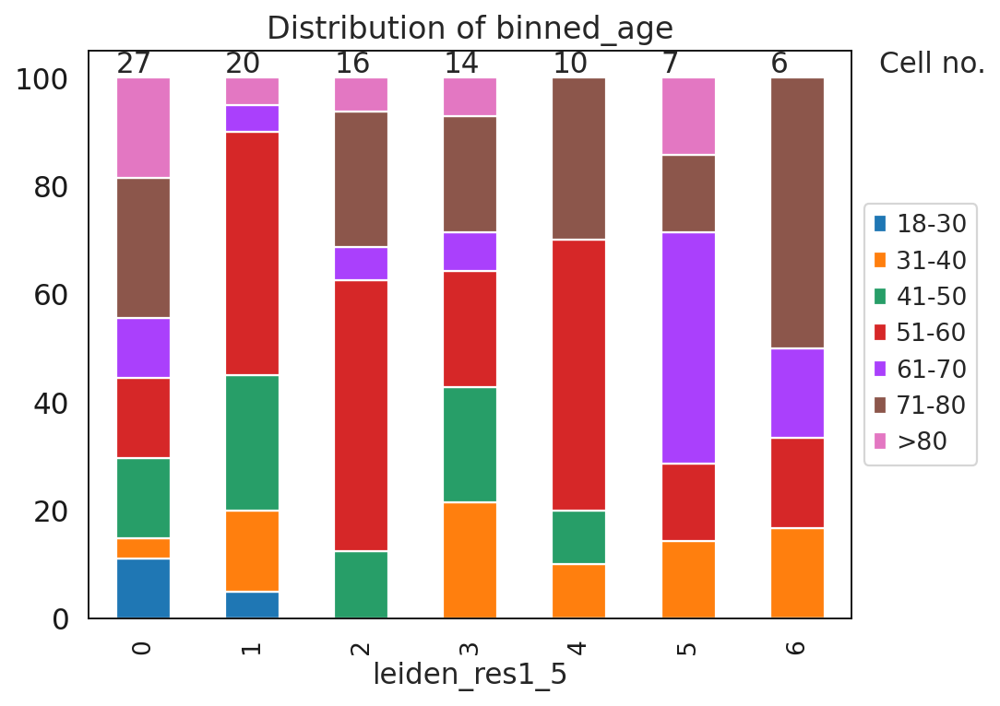

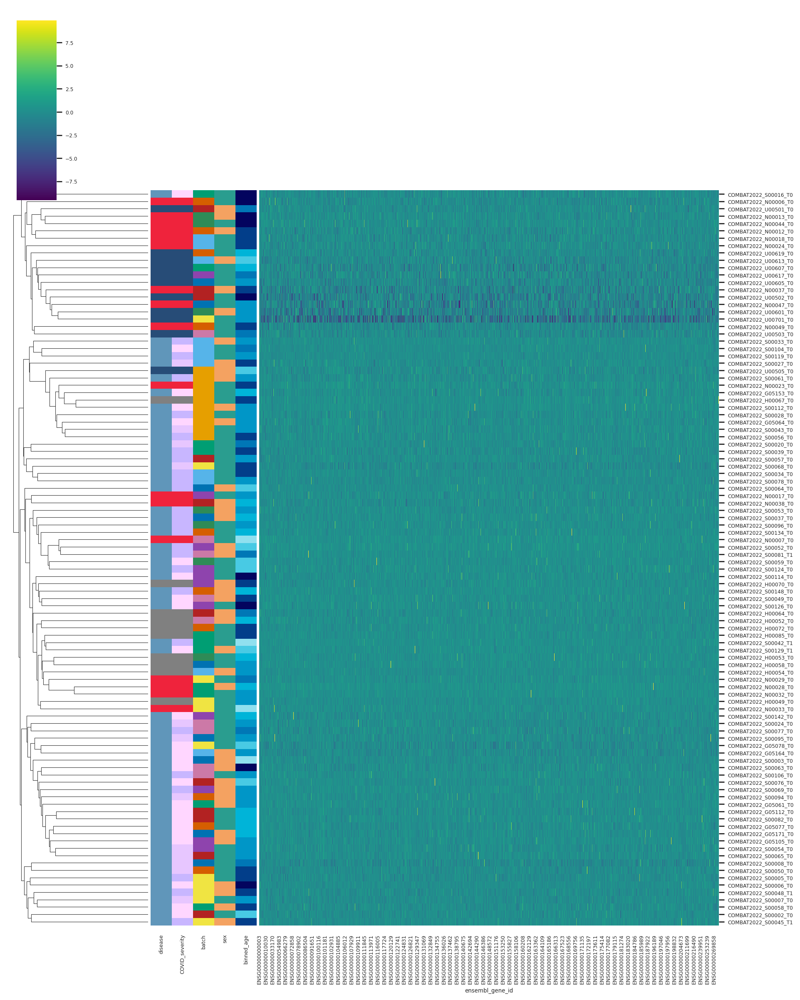

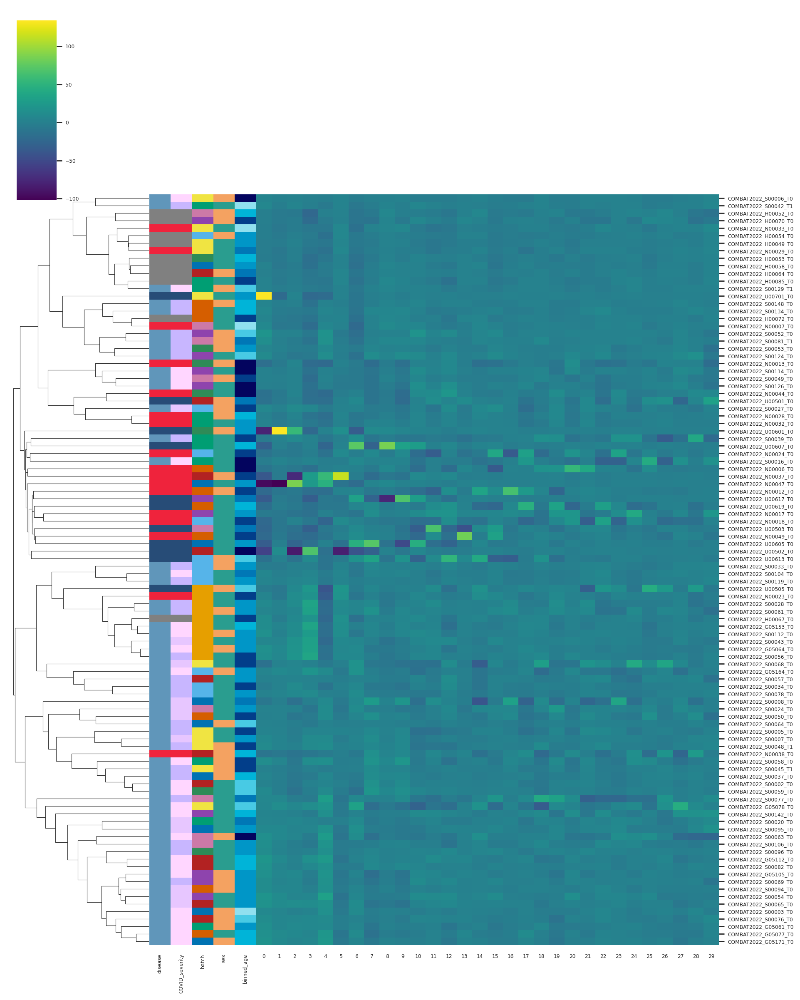

Plasma


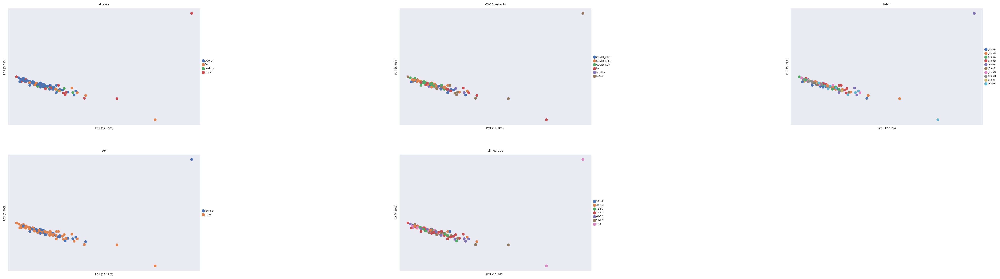

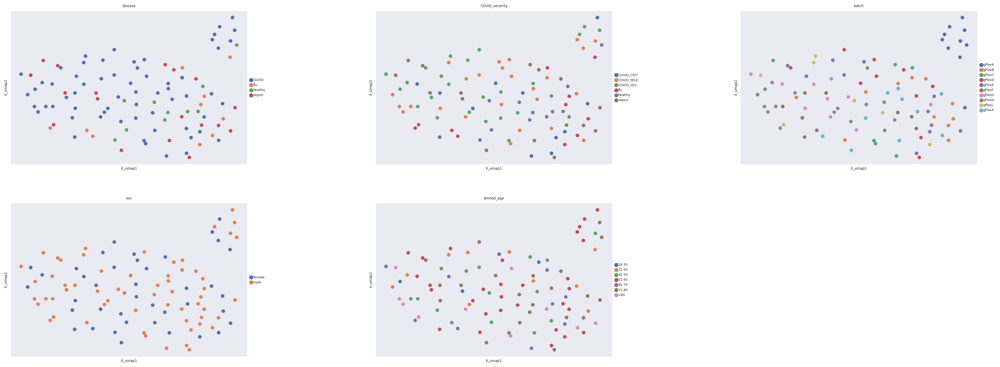

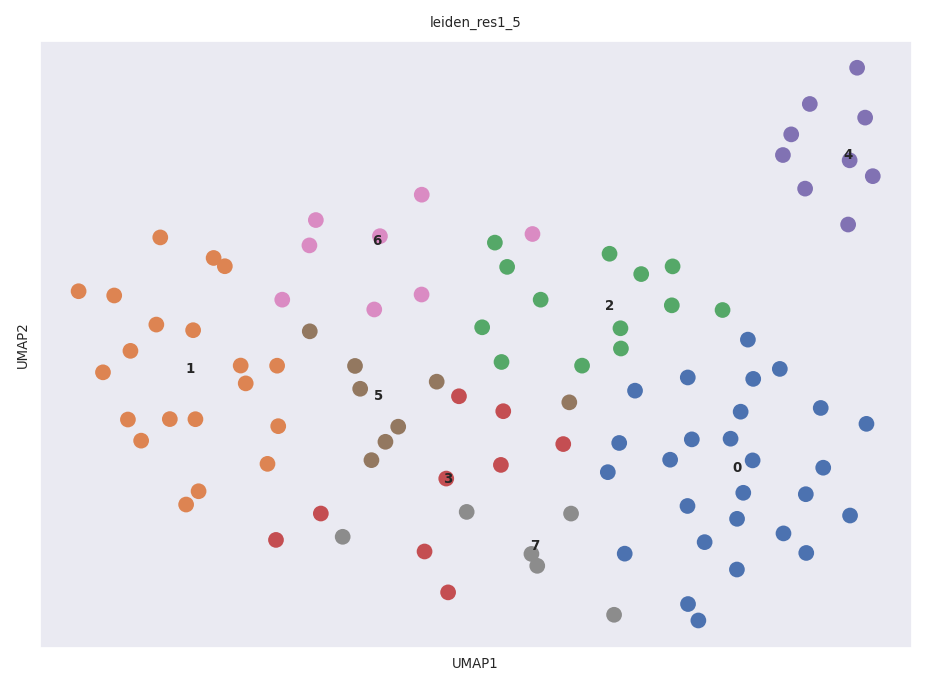

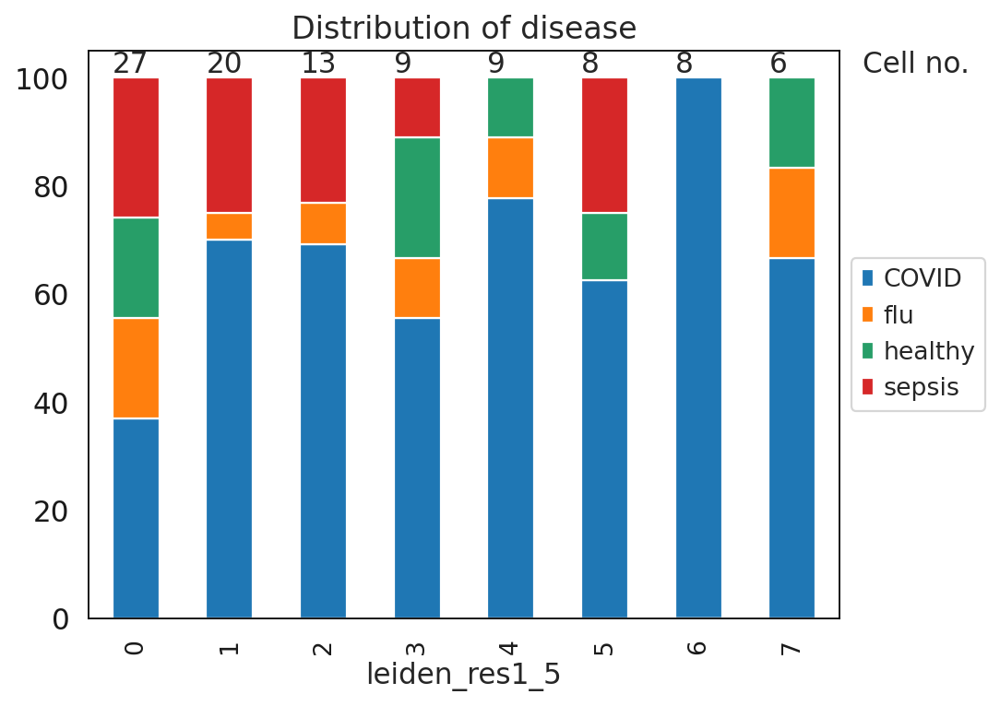

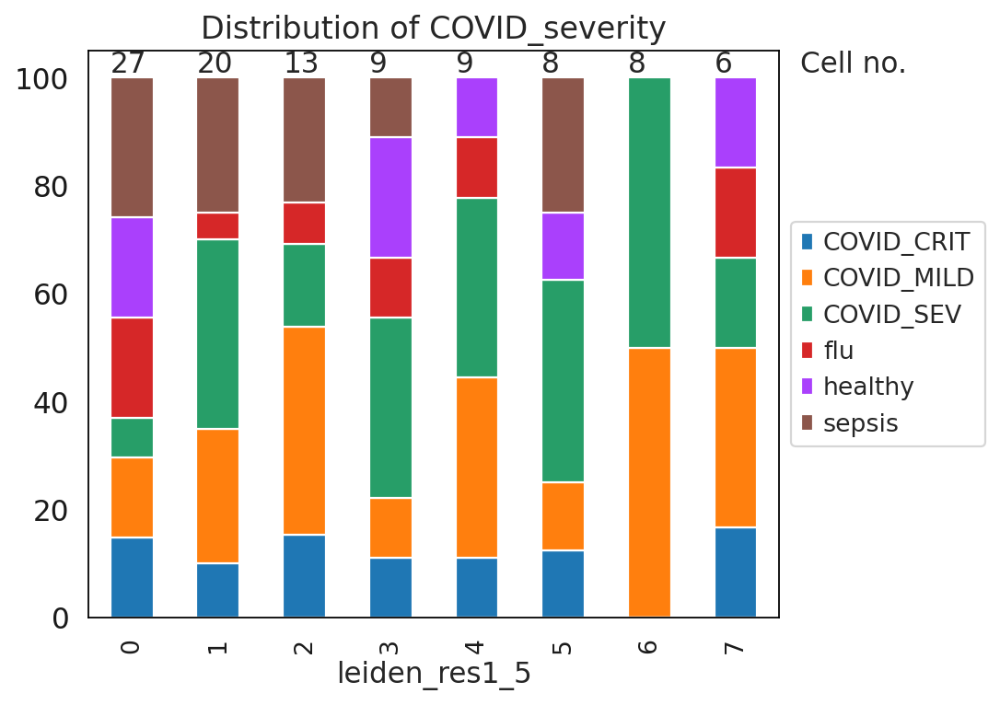

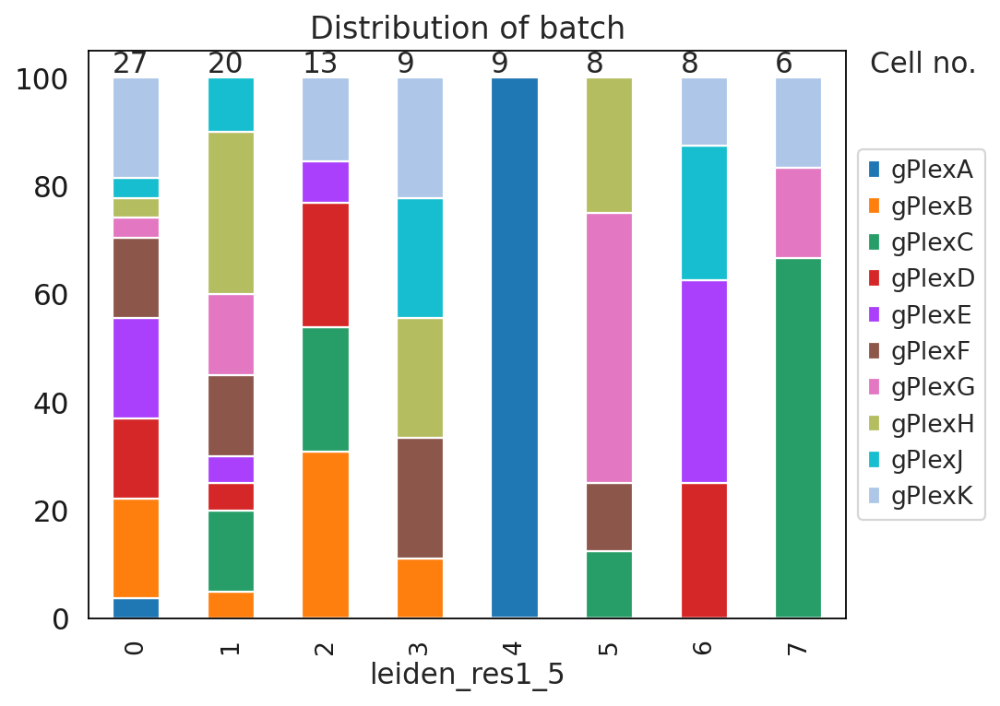

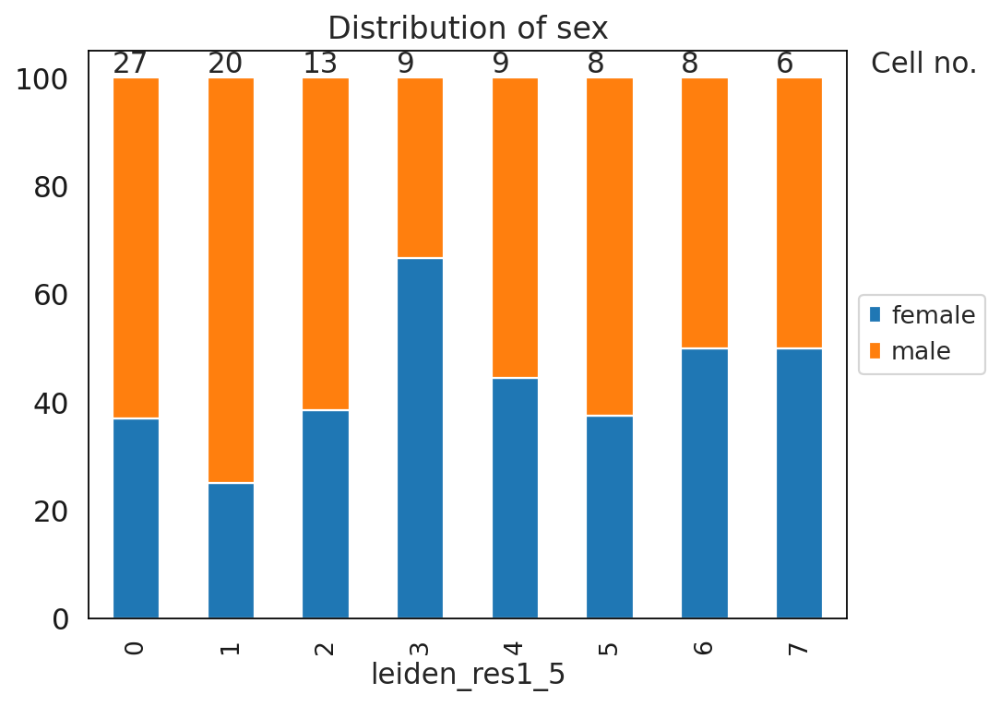

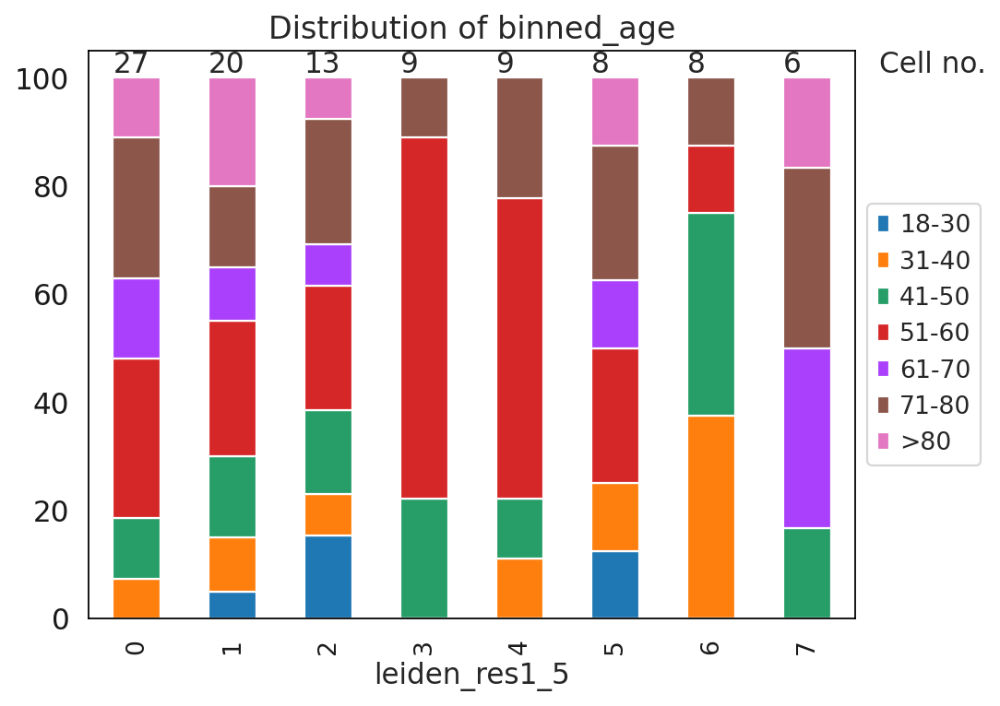

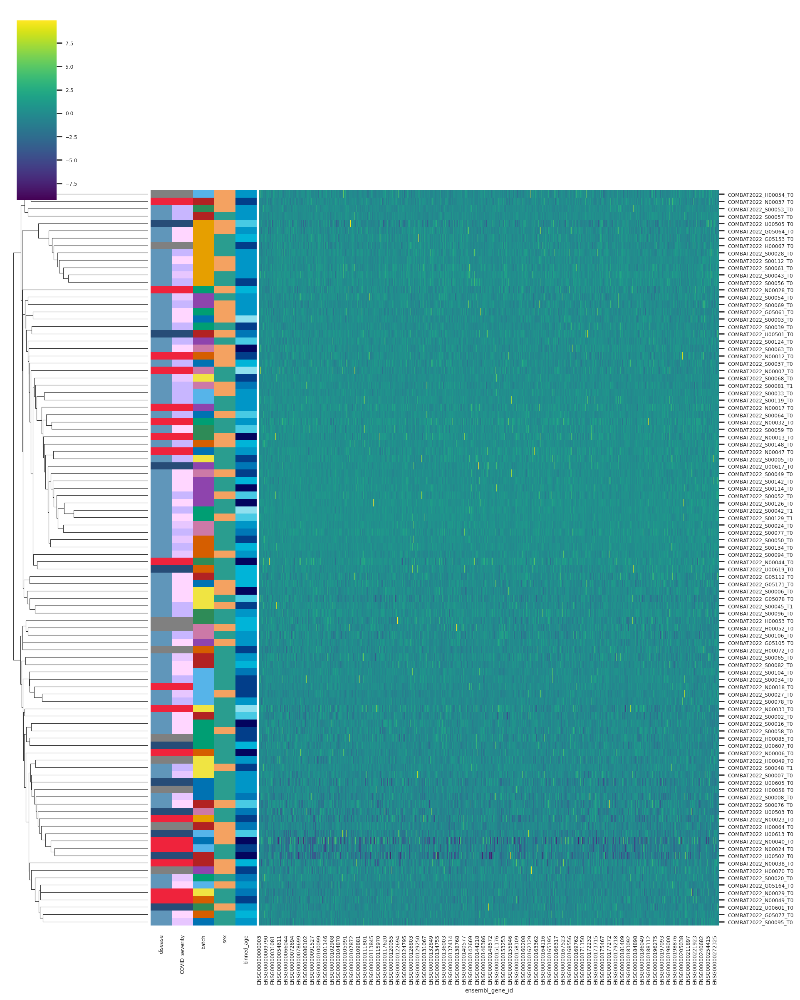

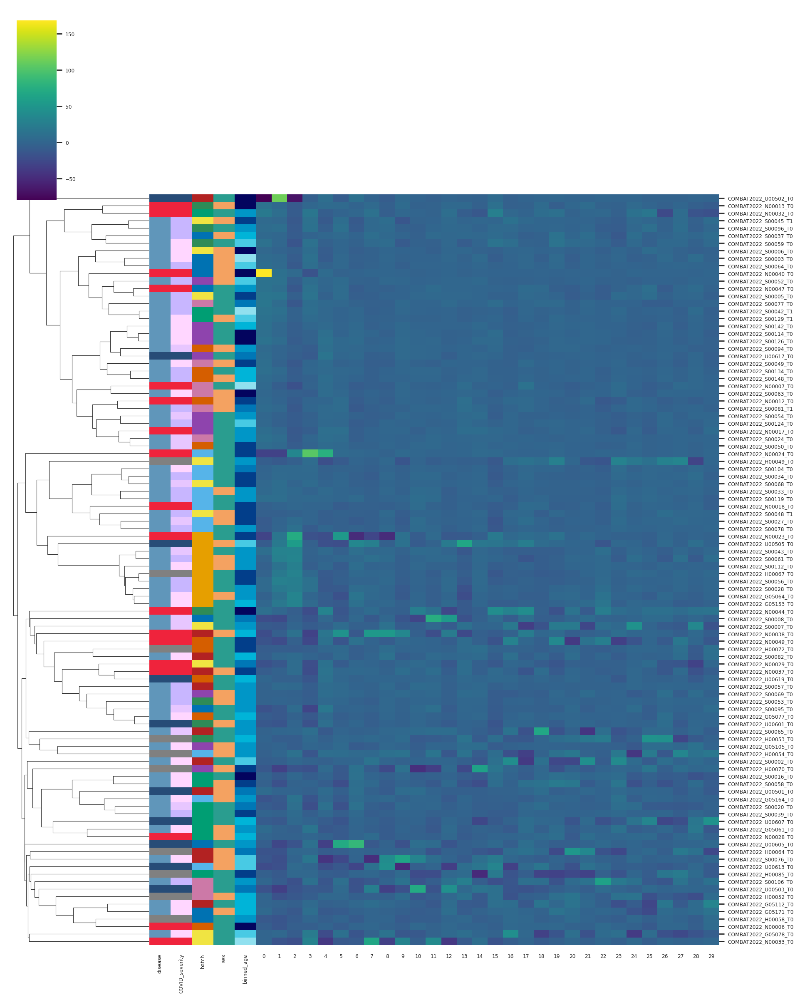

pDC


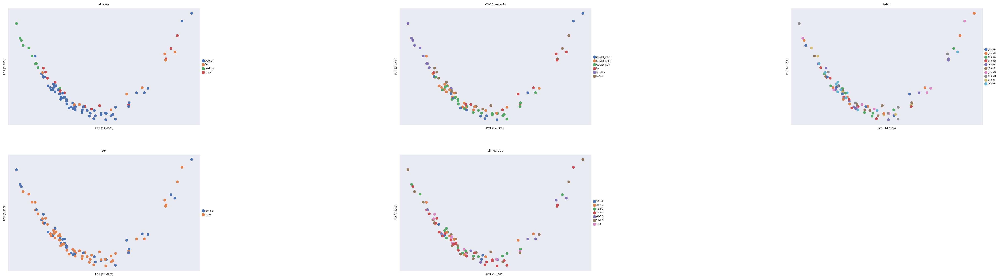

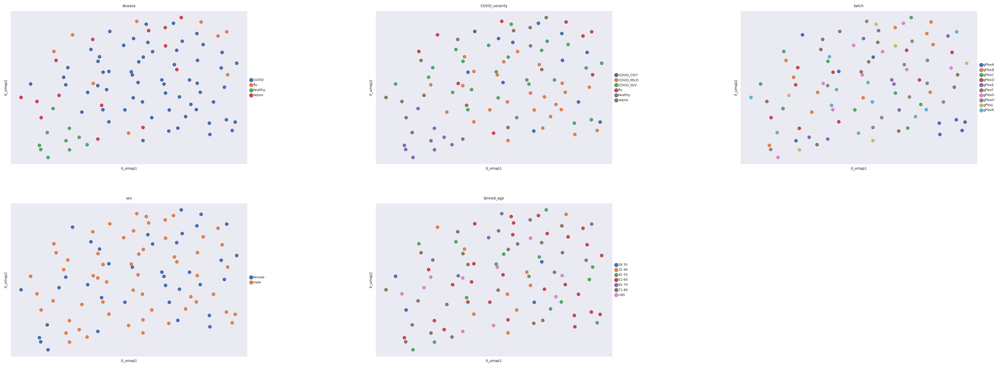

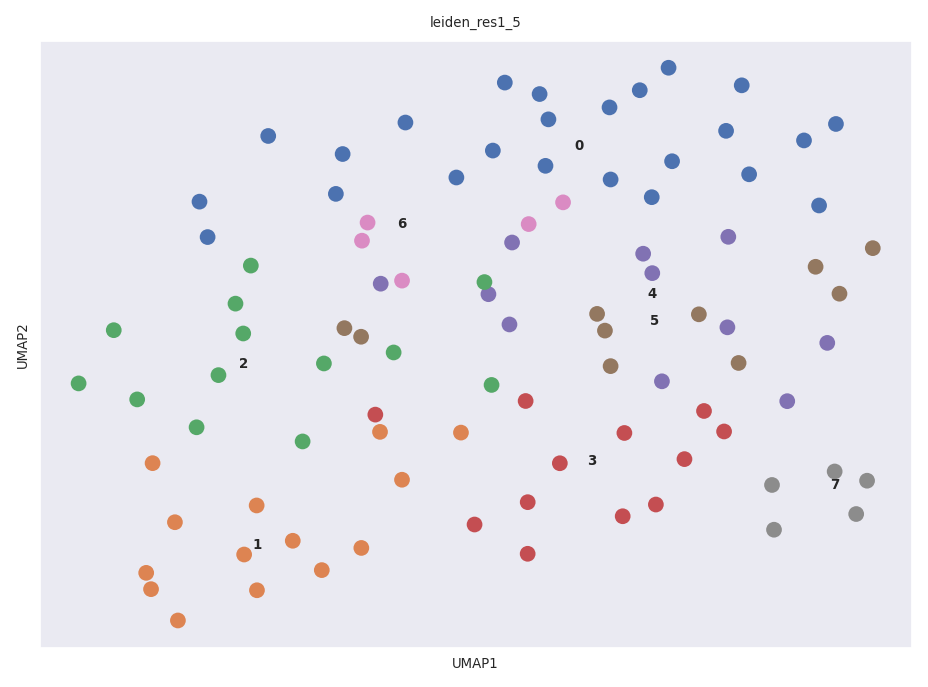

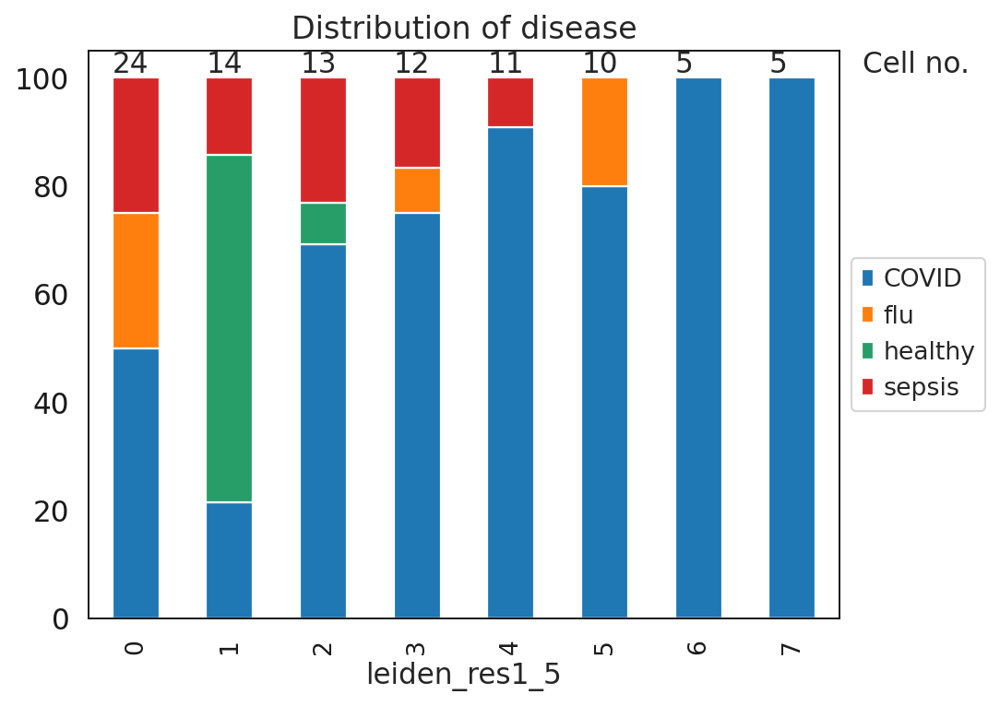

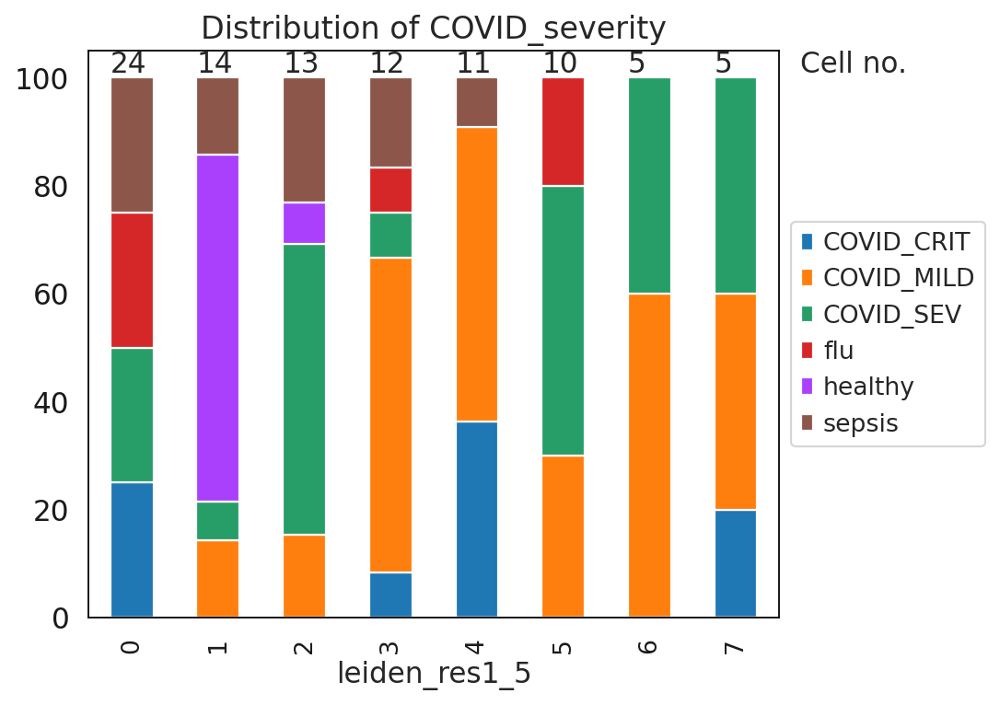

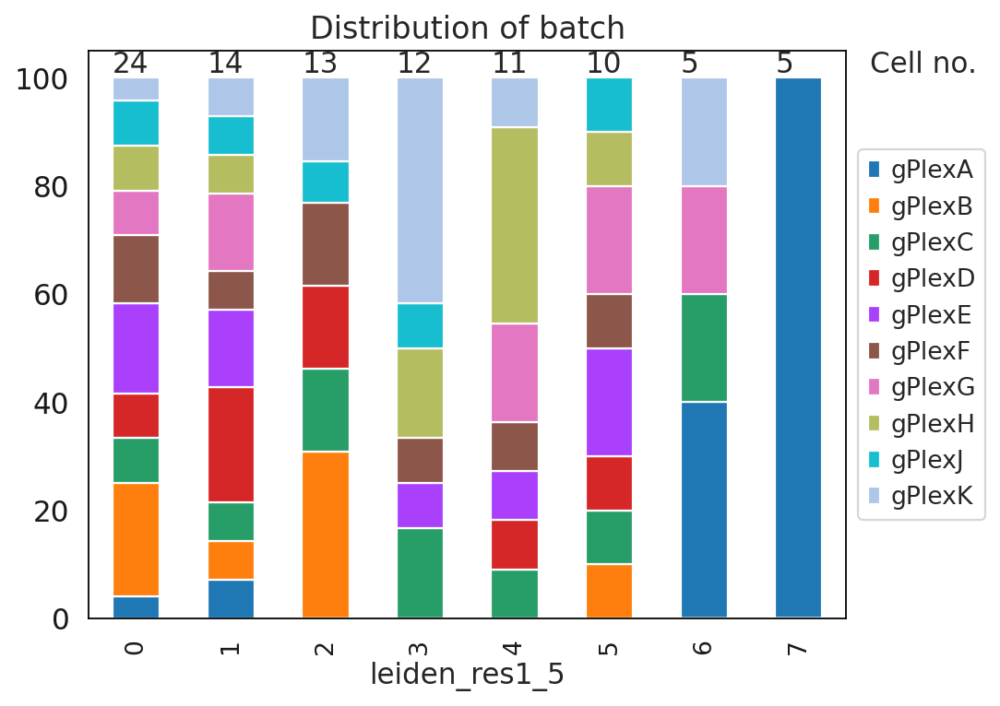

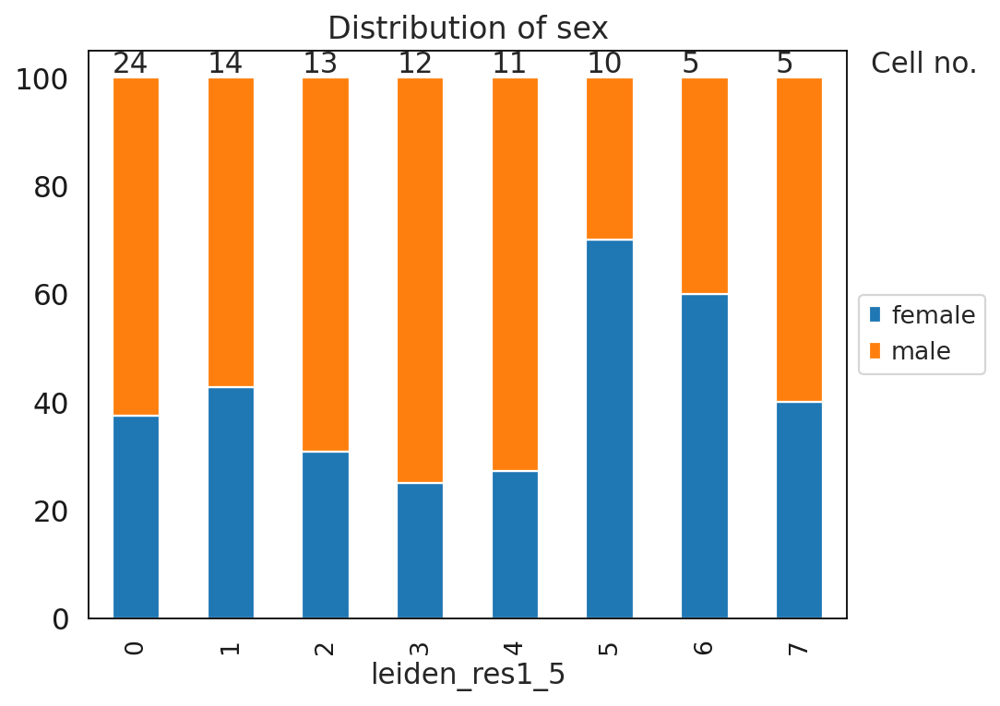

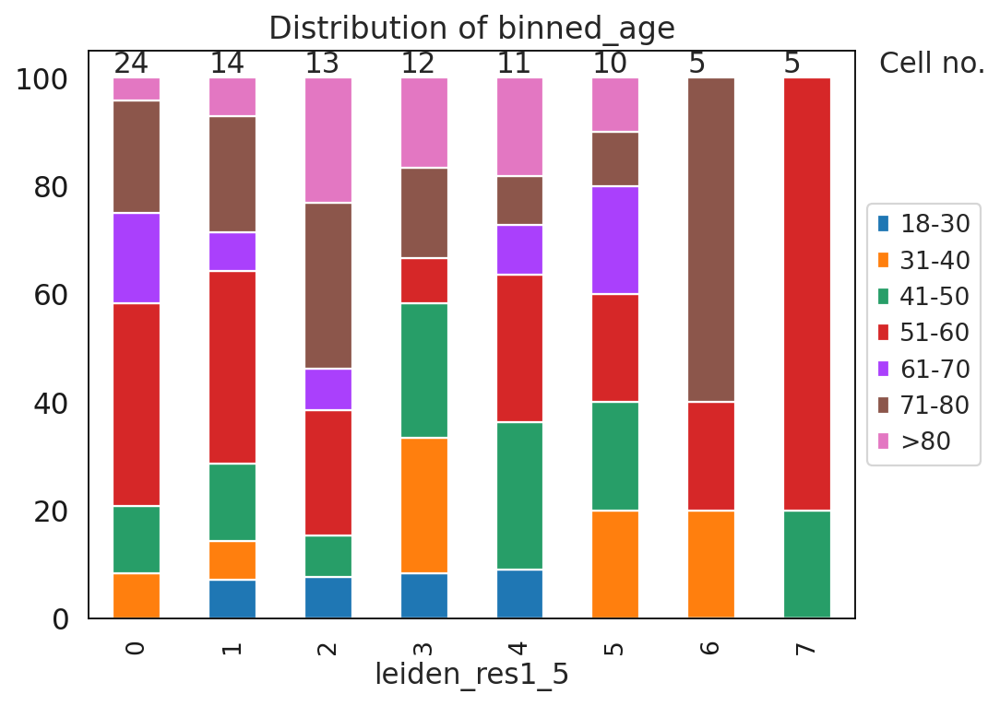

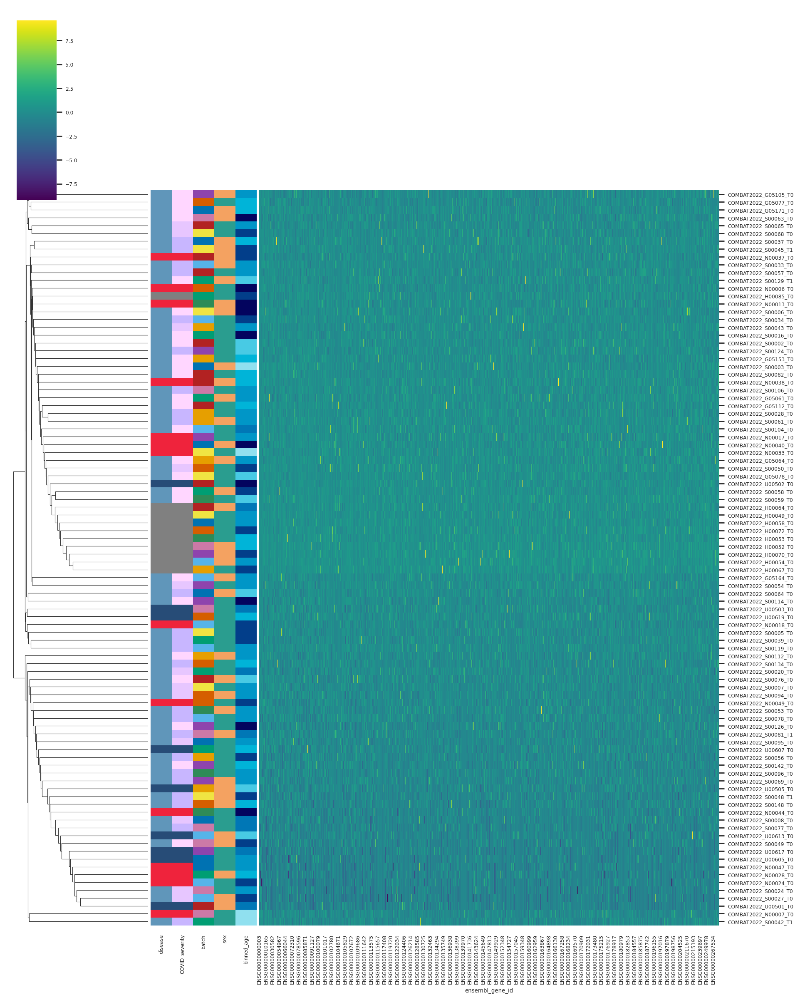

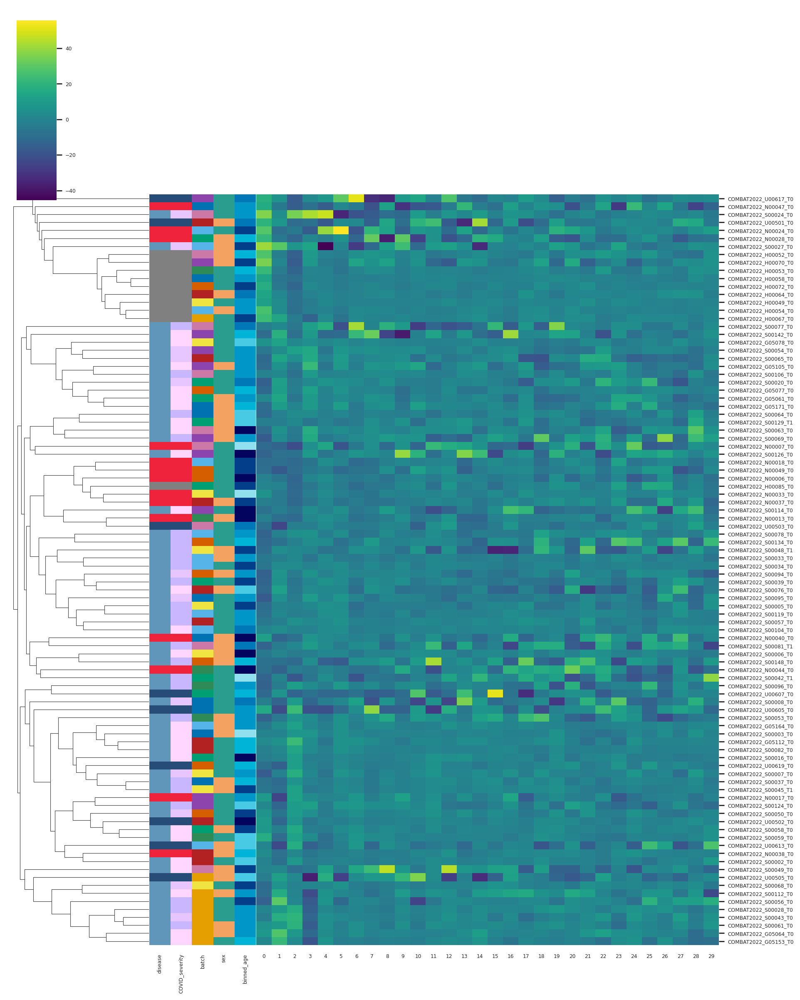

DC


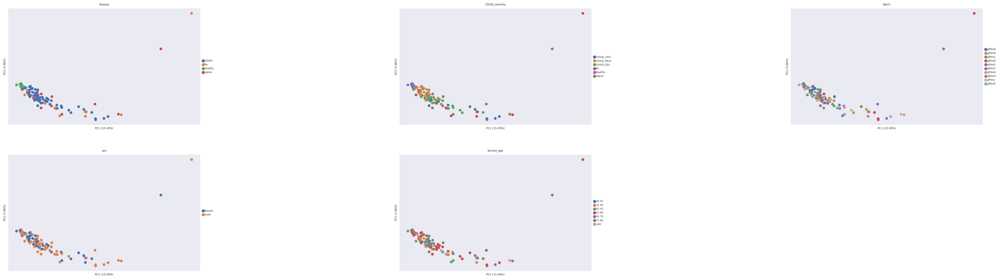

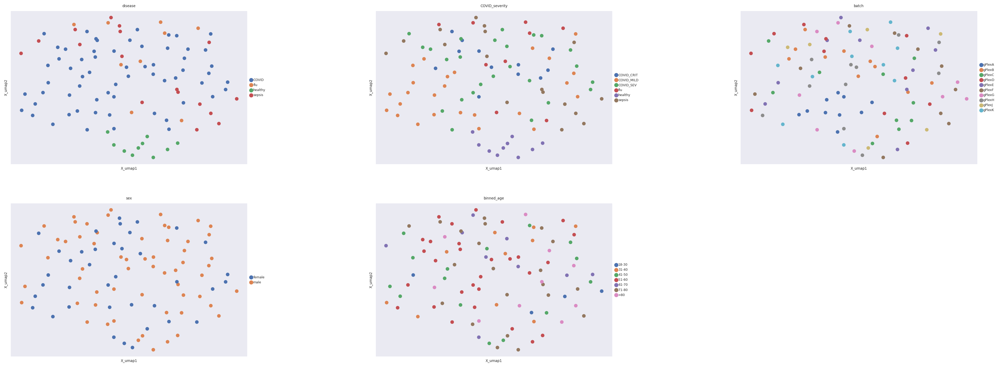

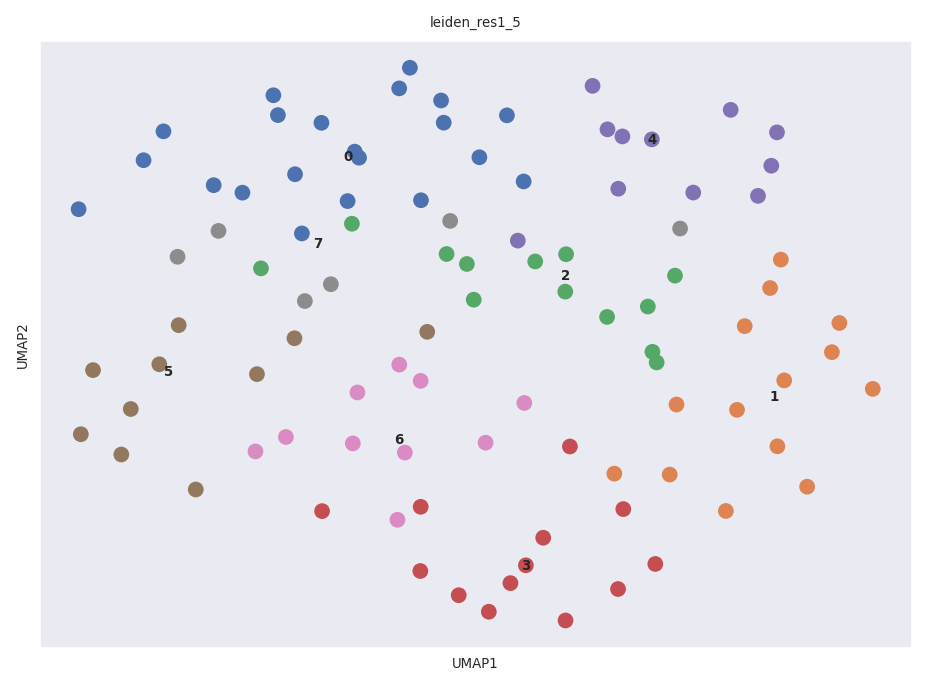

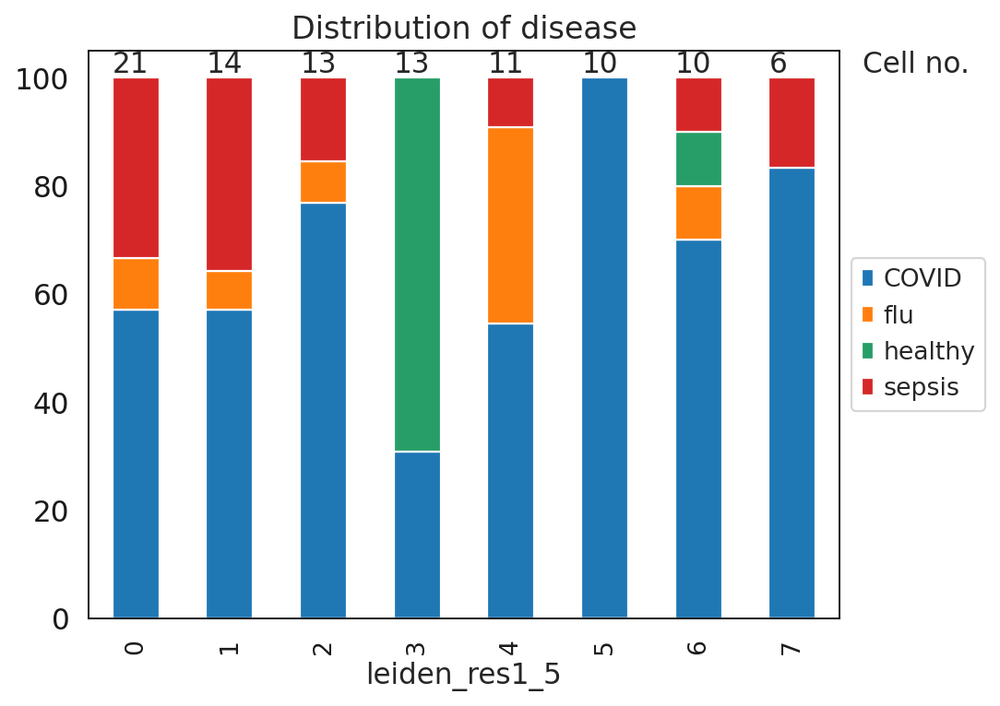

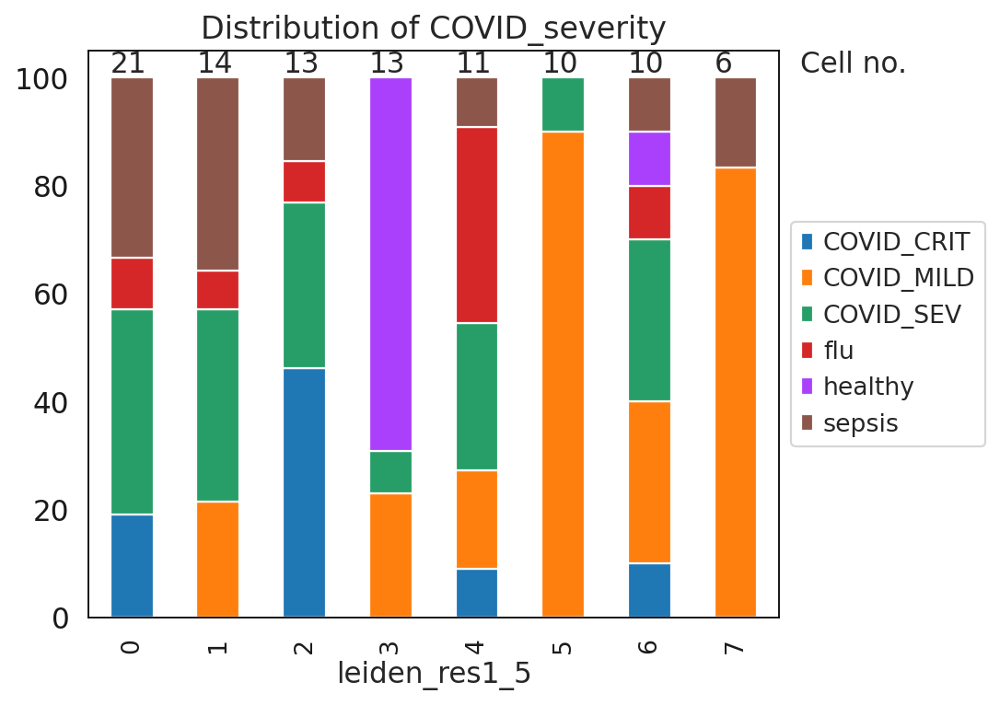

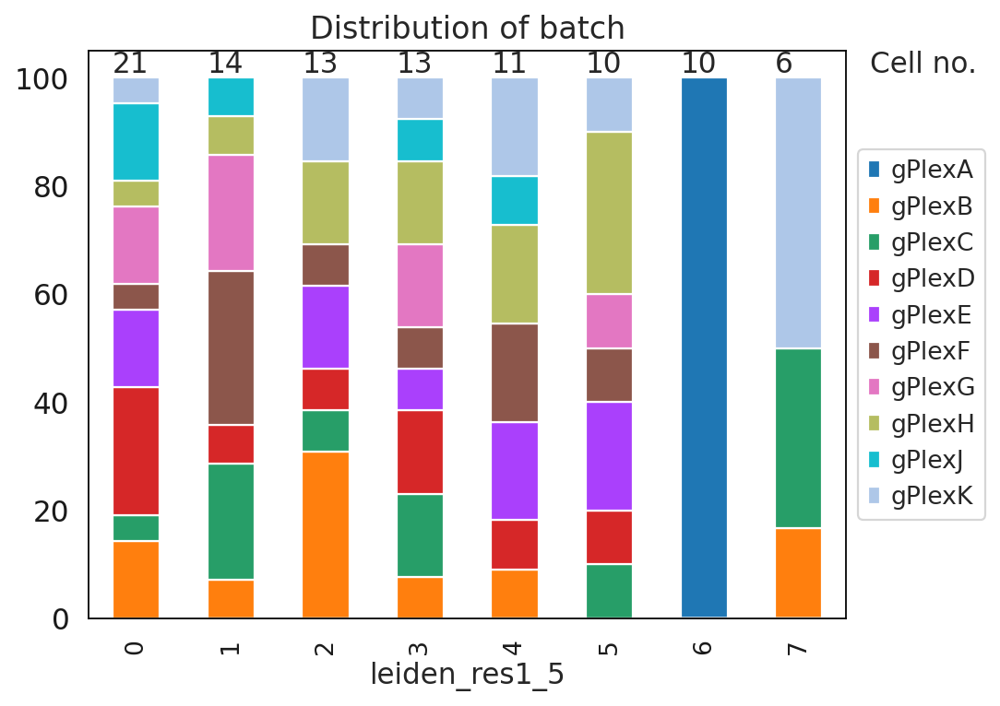

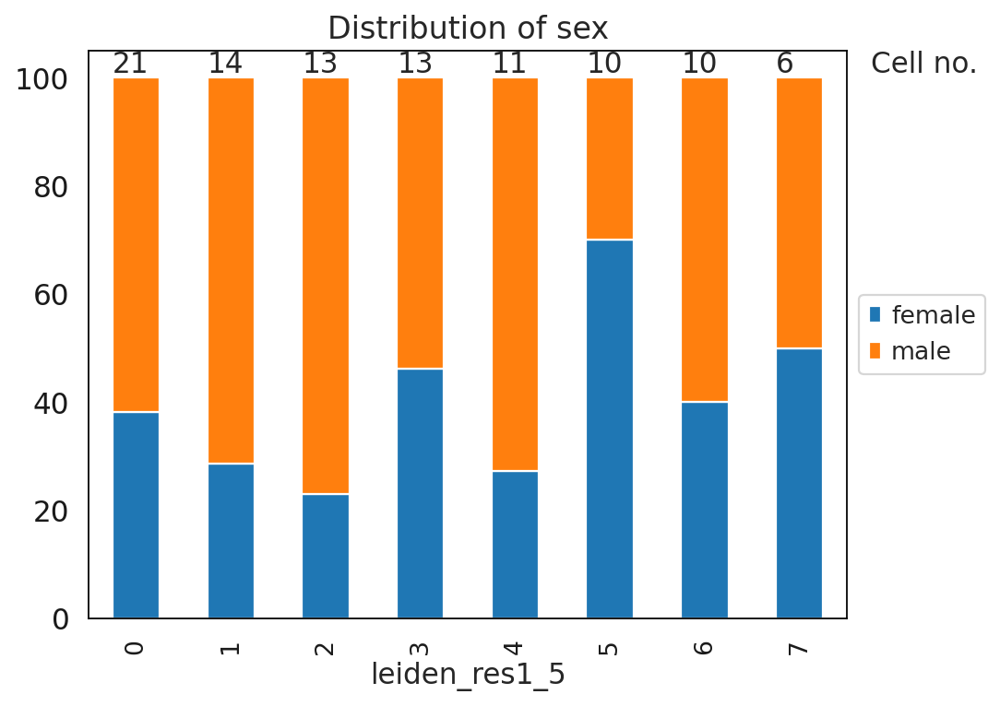

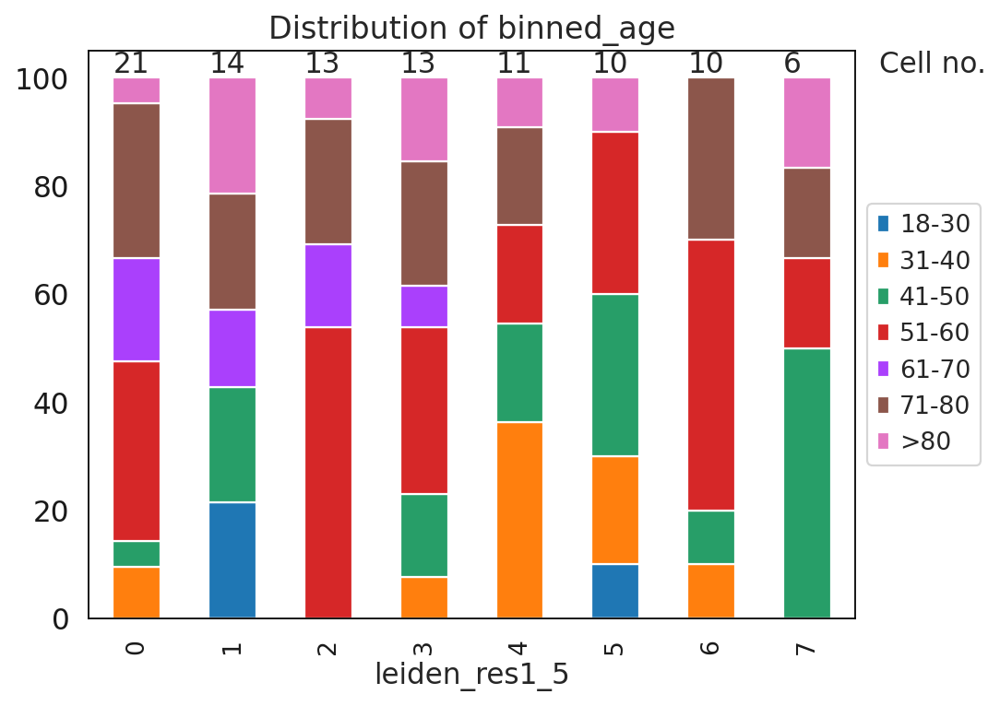

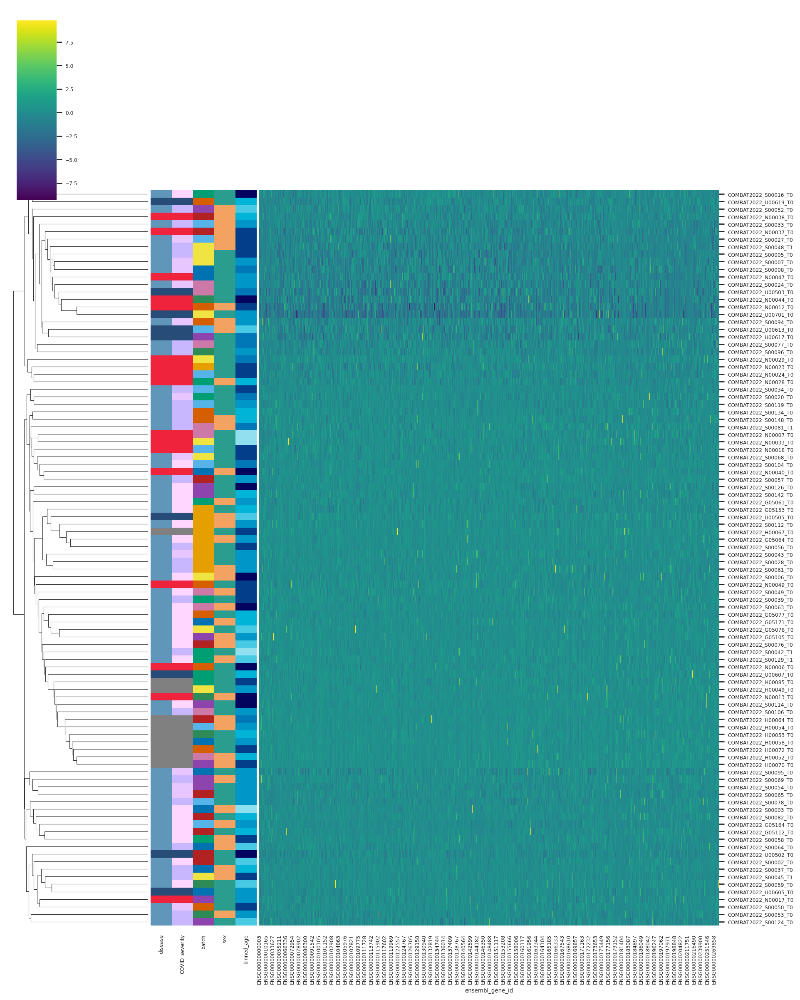

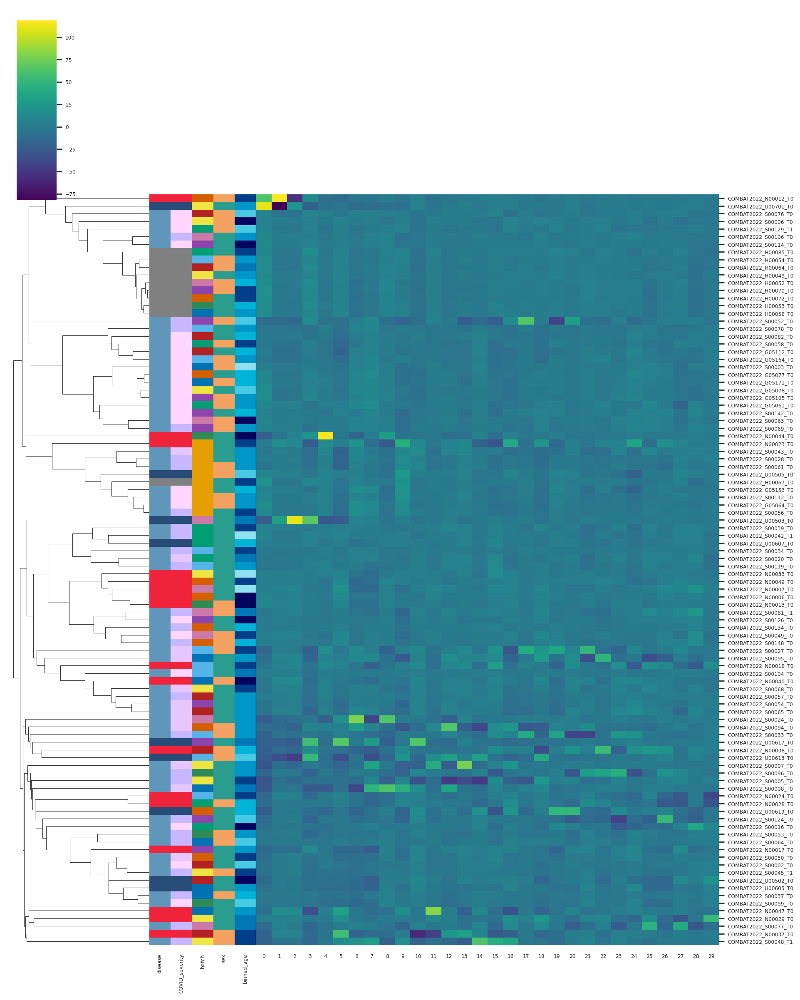

Mono


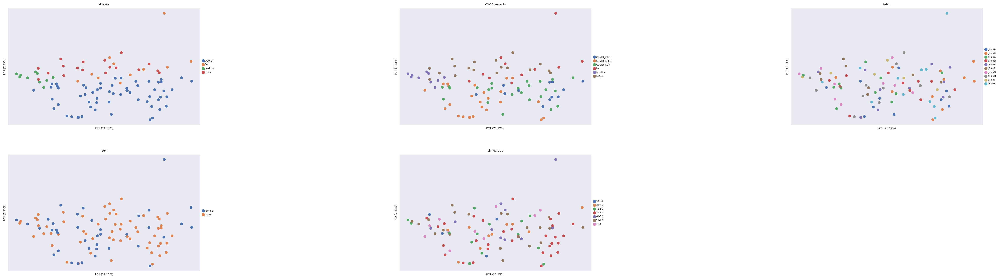

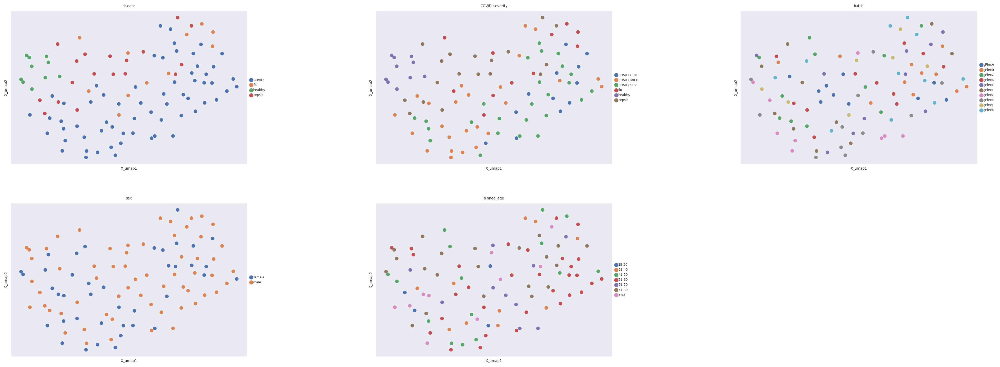

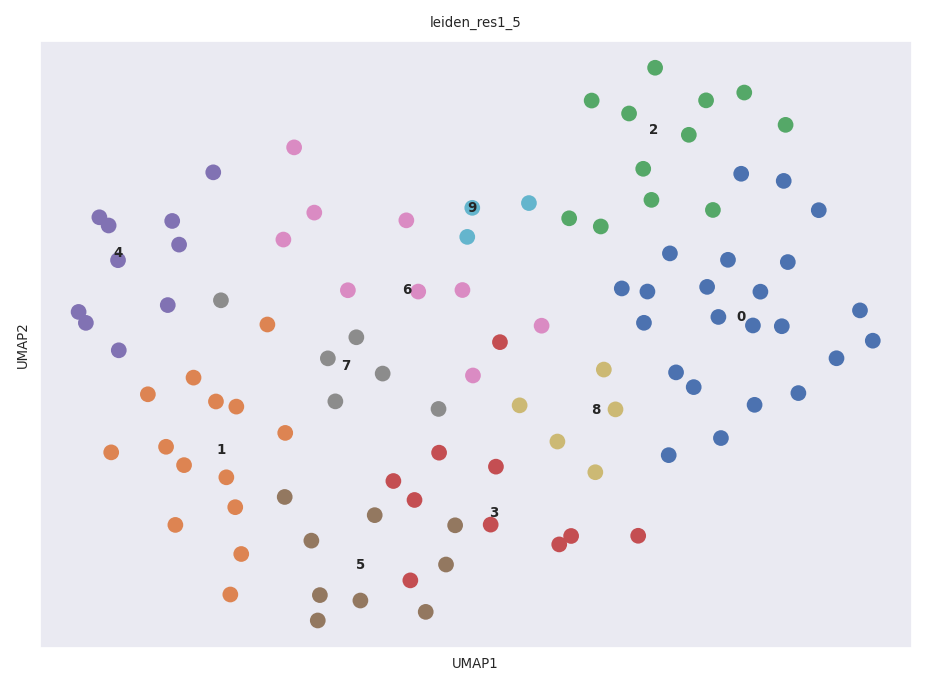

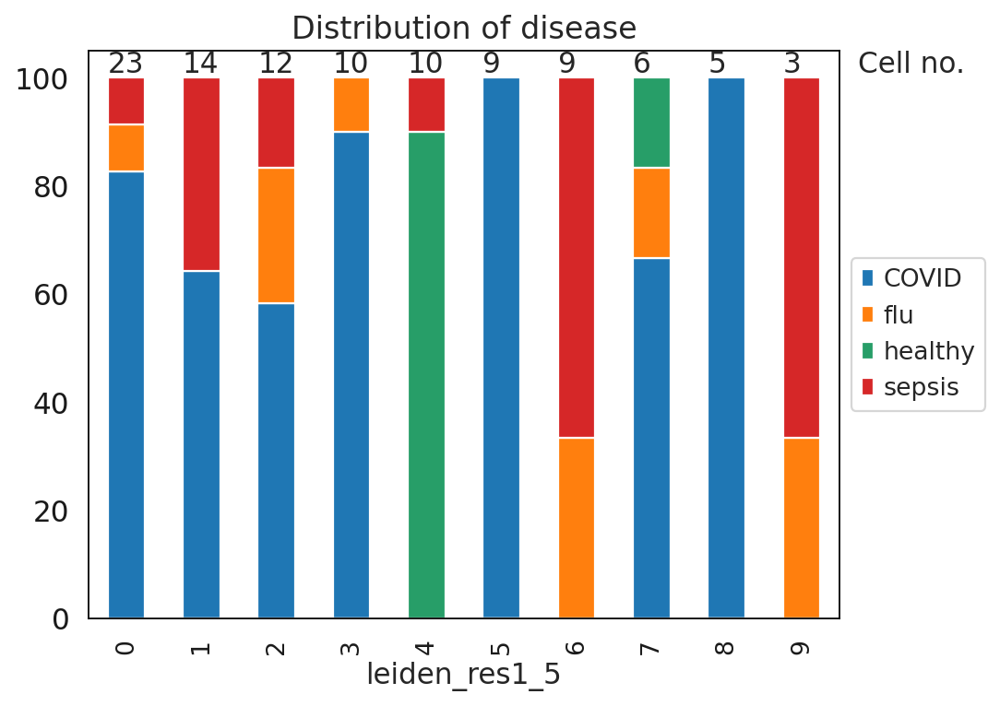

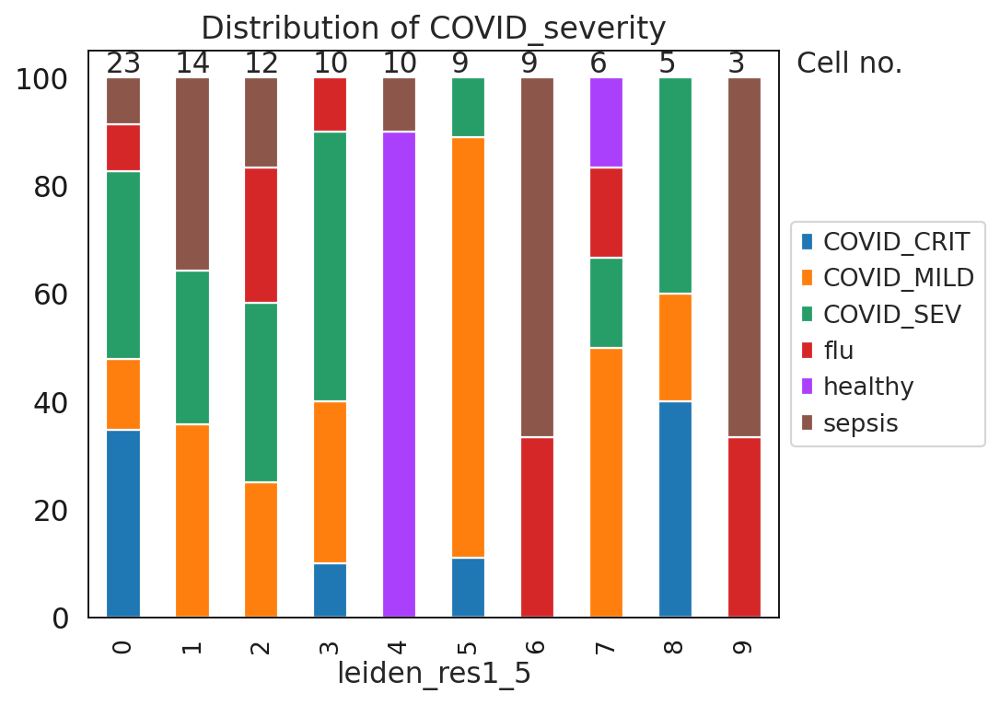

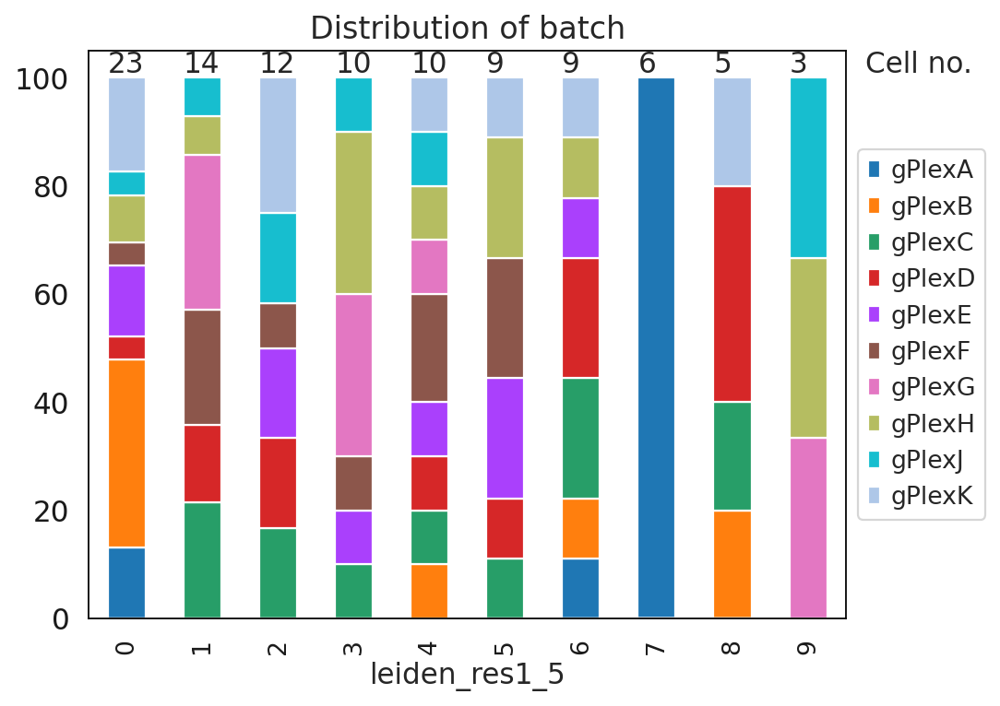

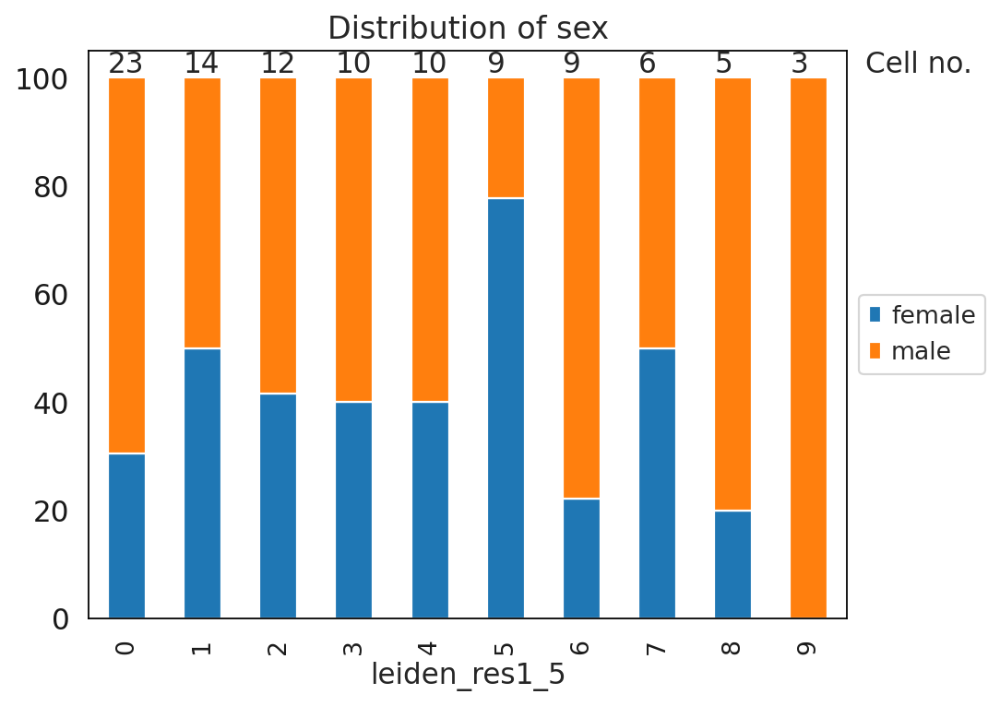

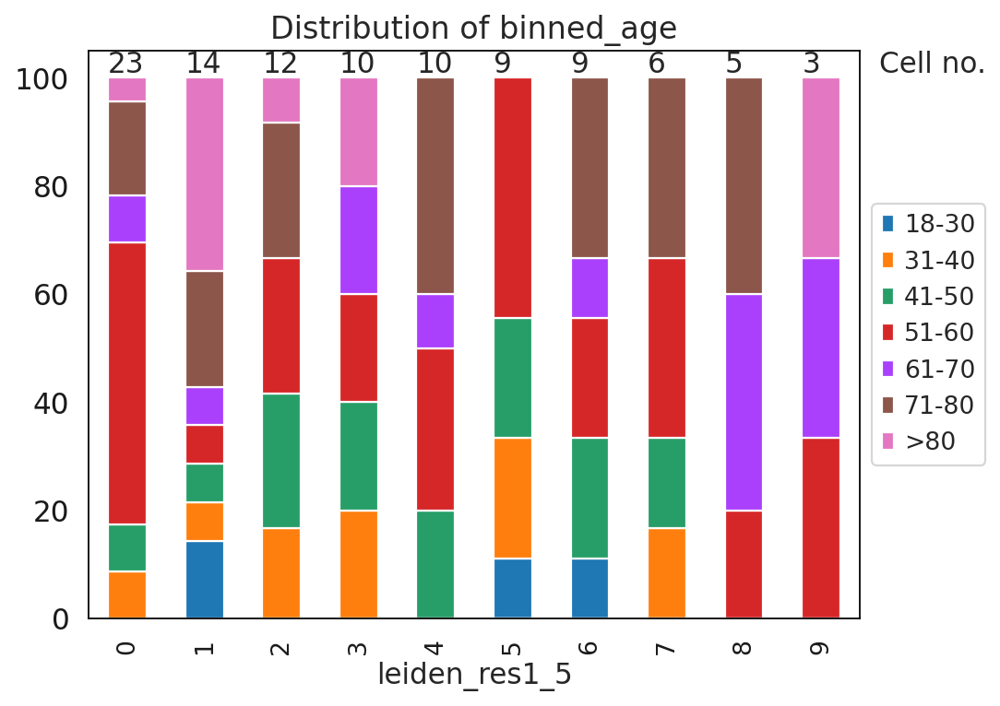

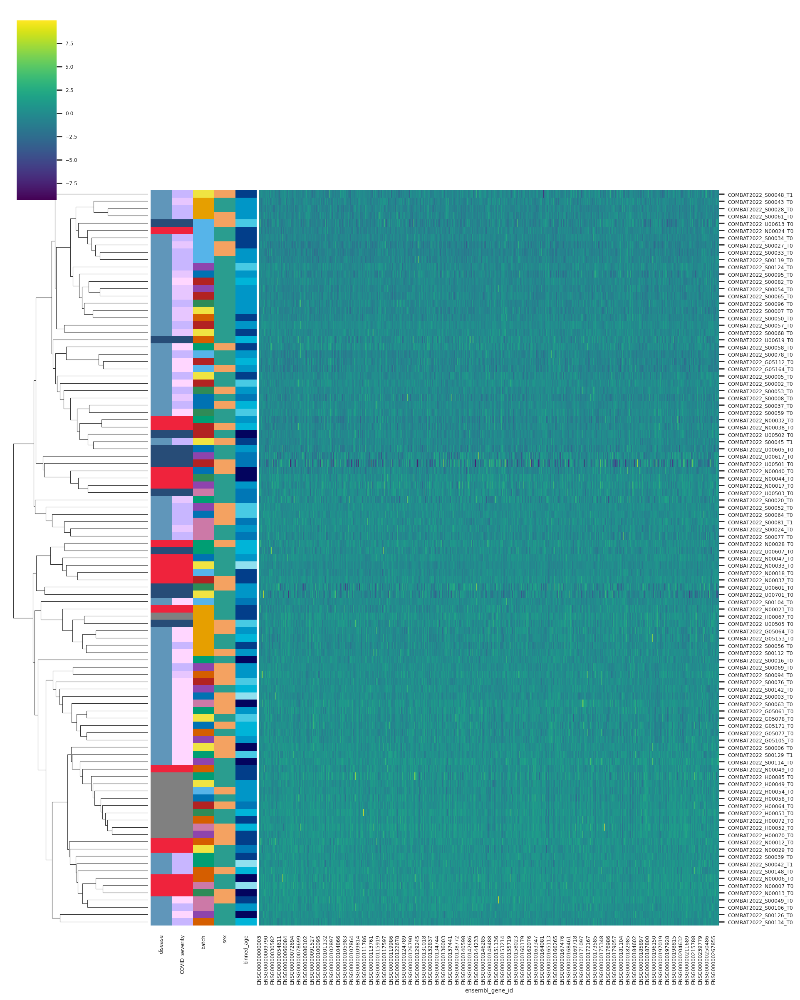

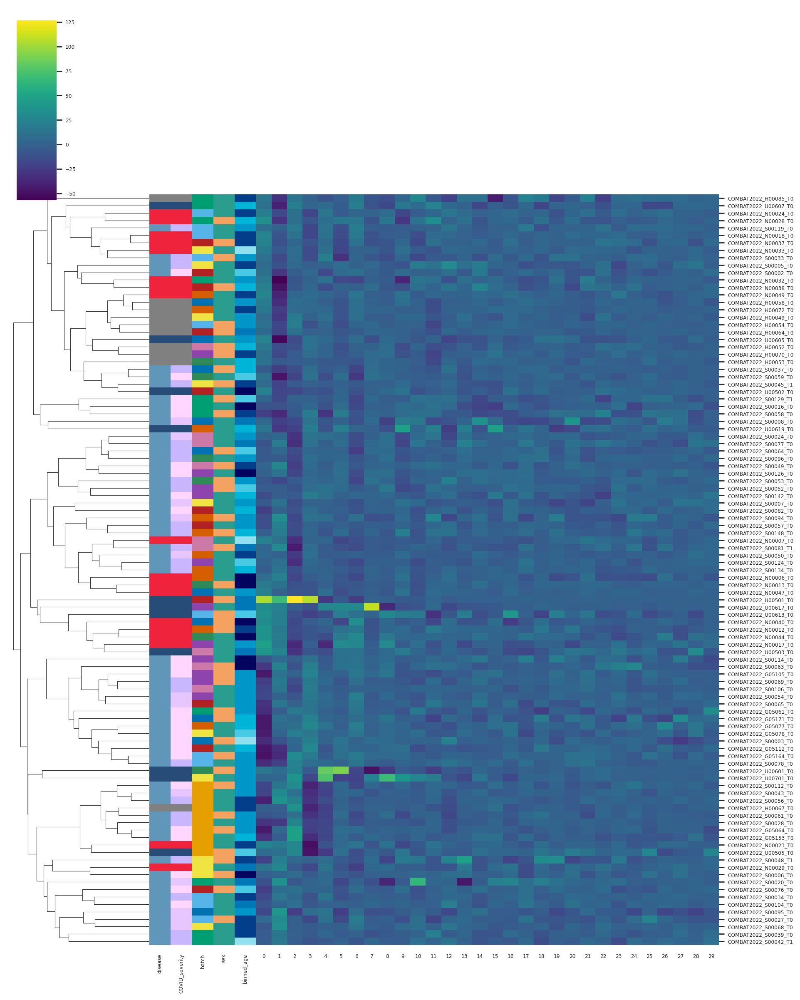

T_CD4_Naive


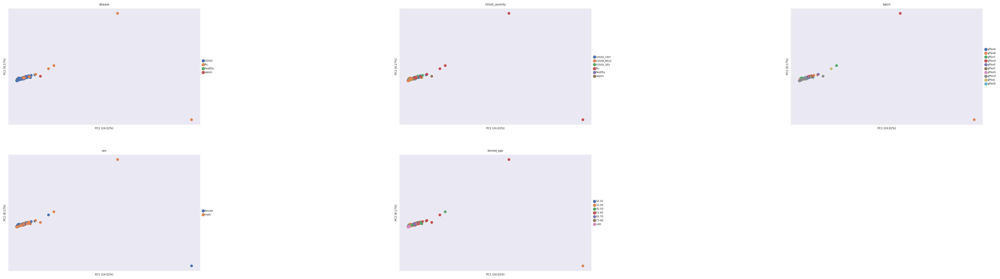

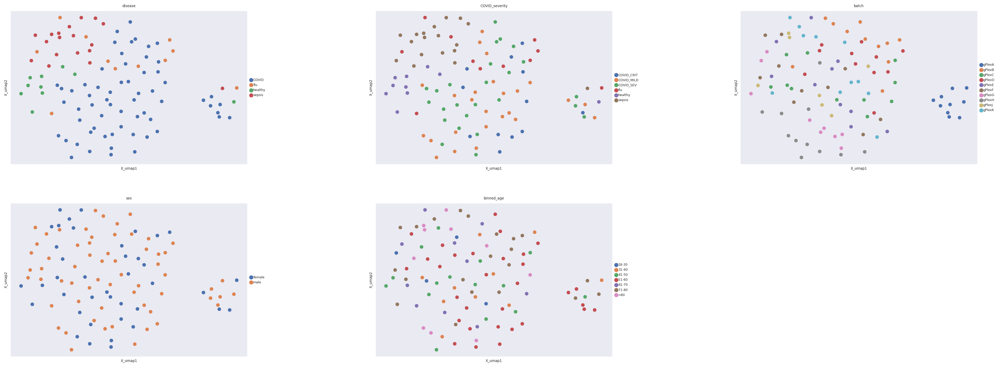

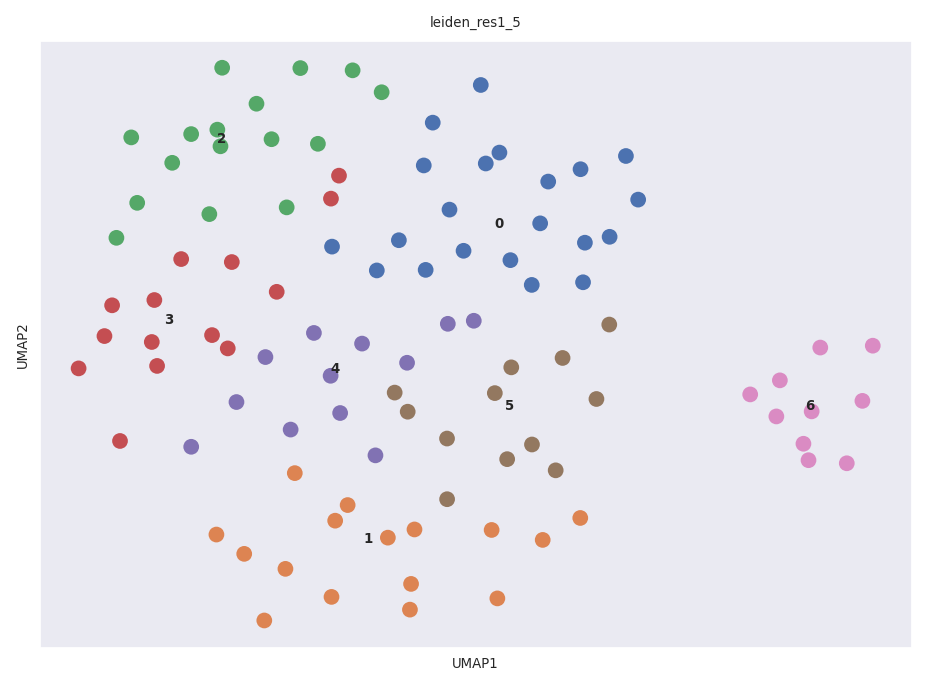

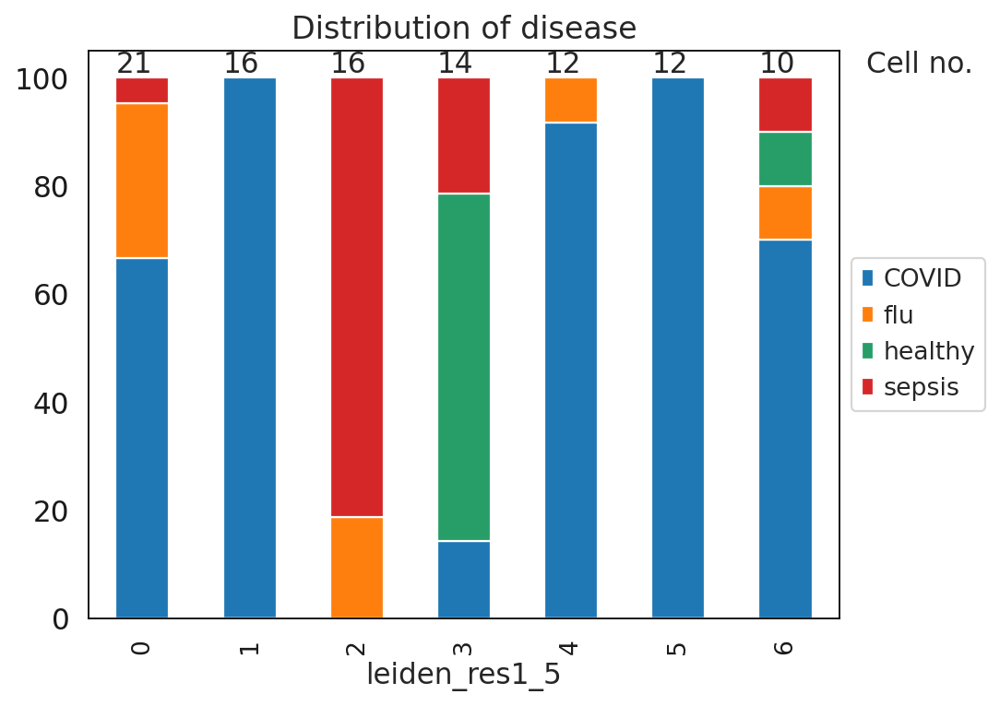

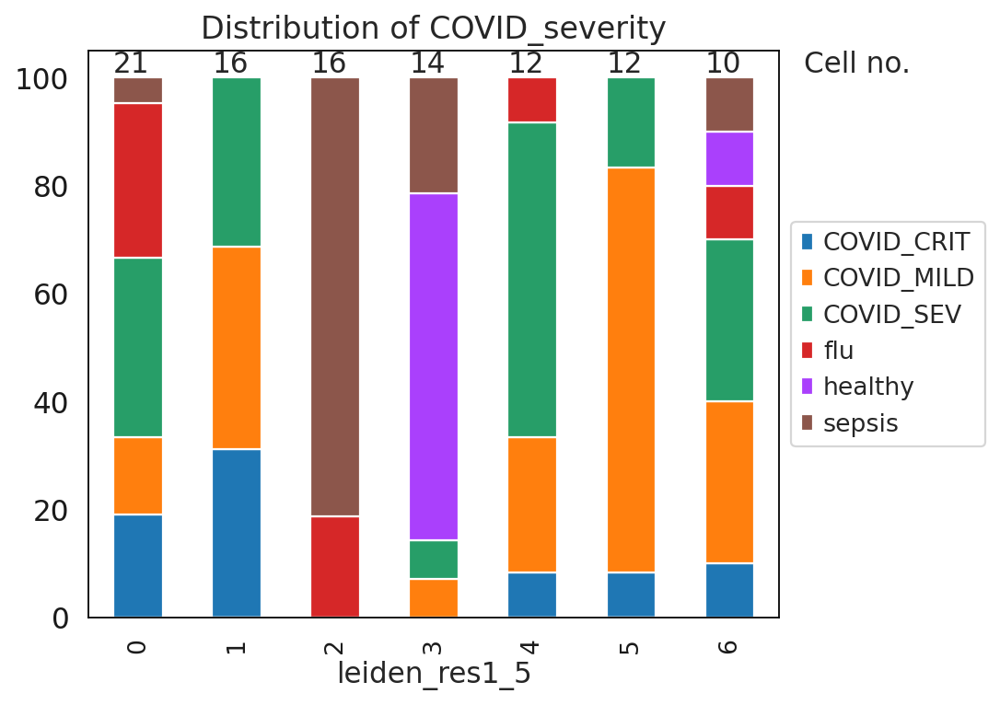

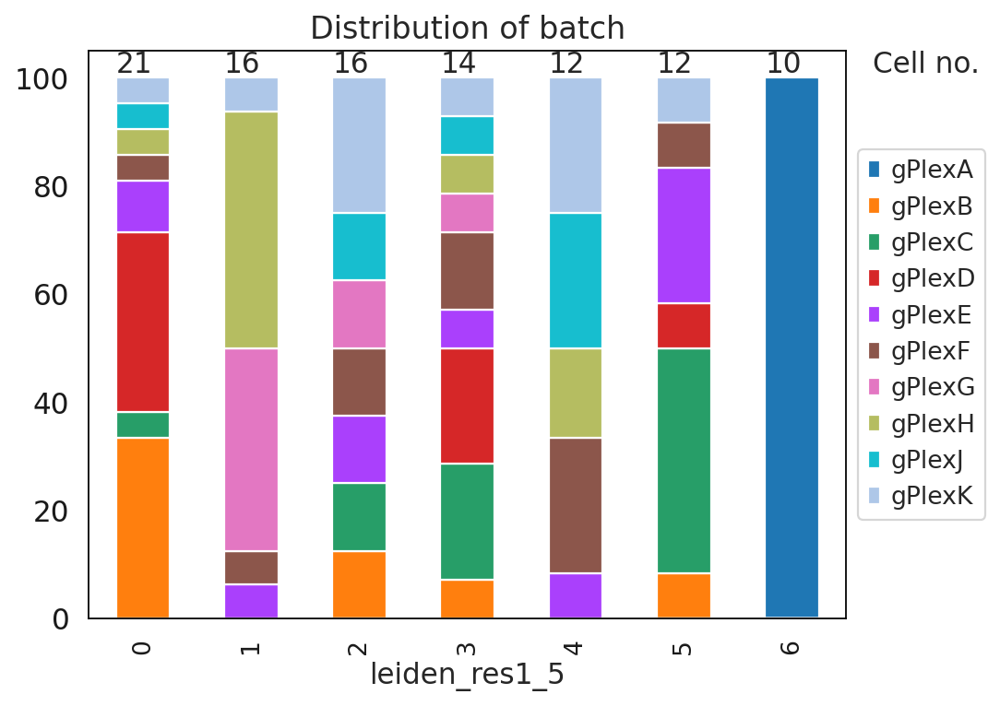

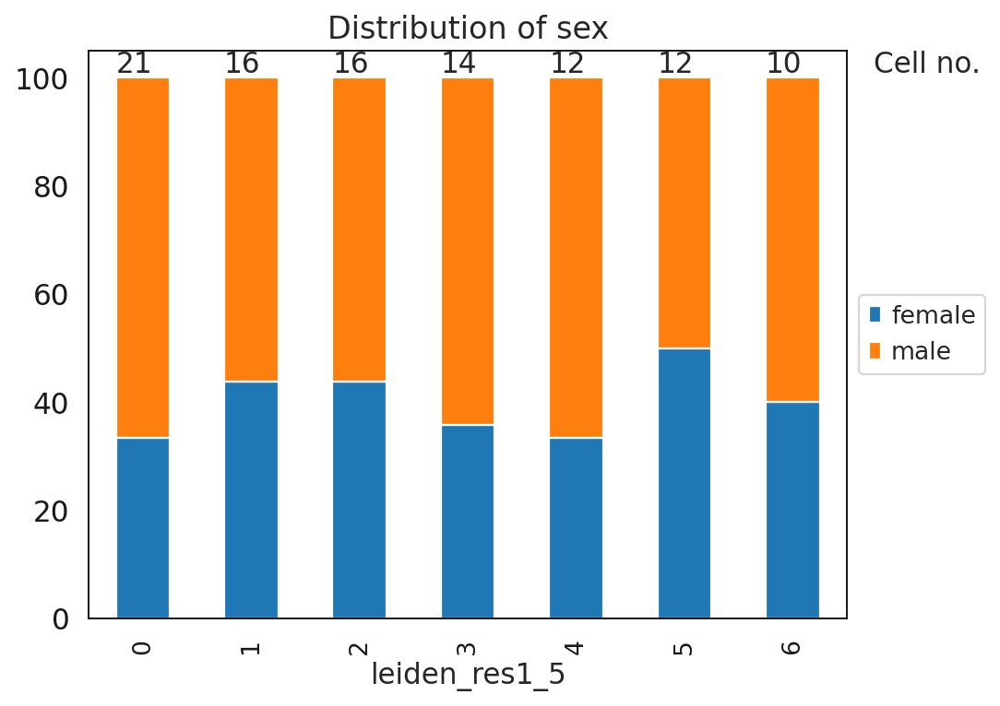

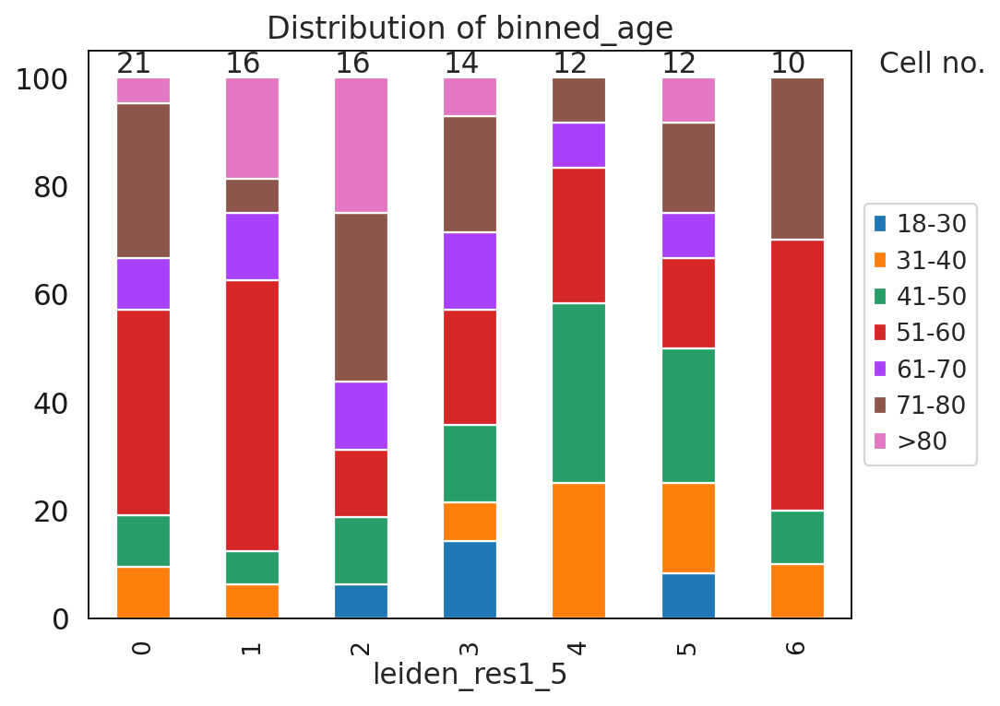

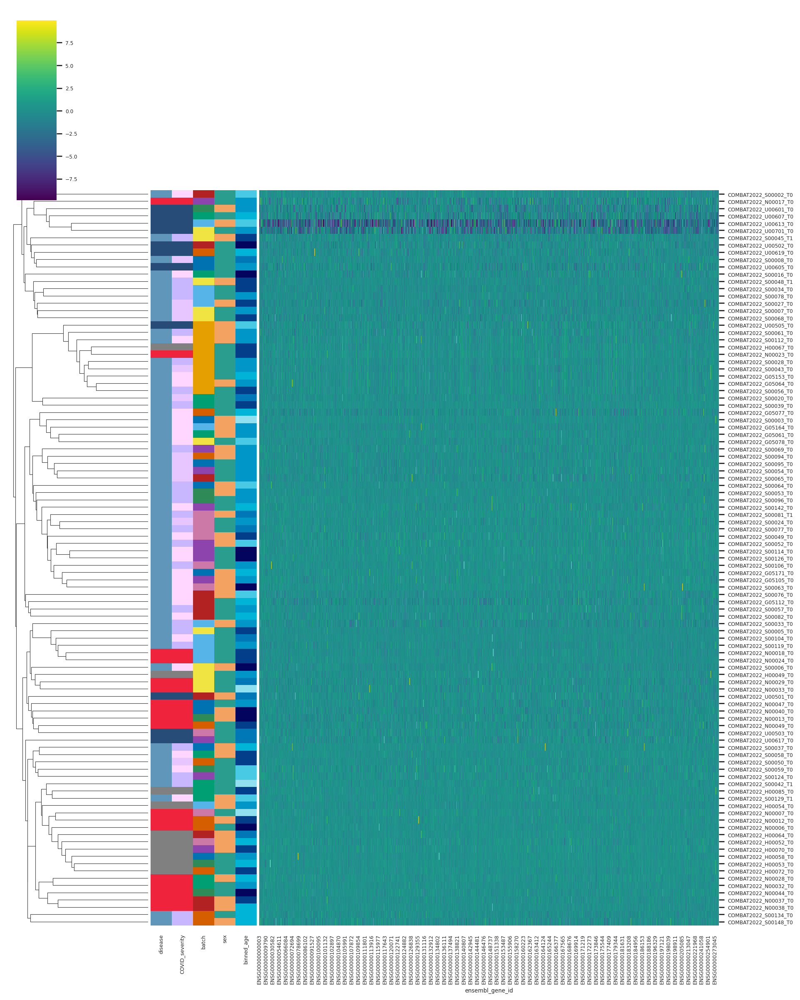

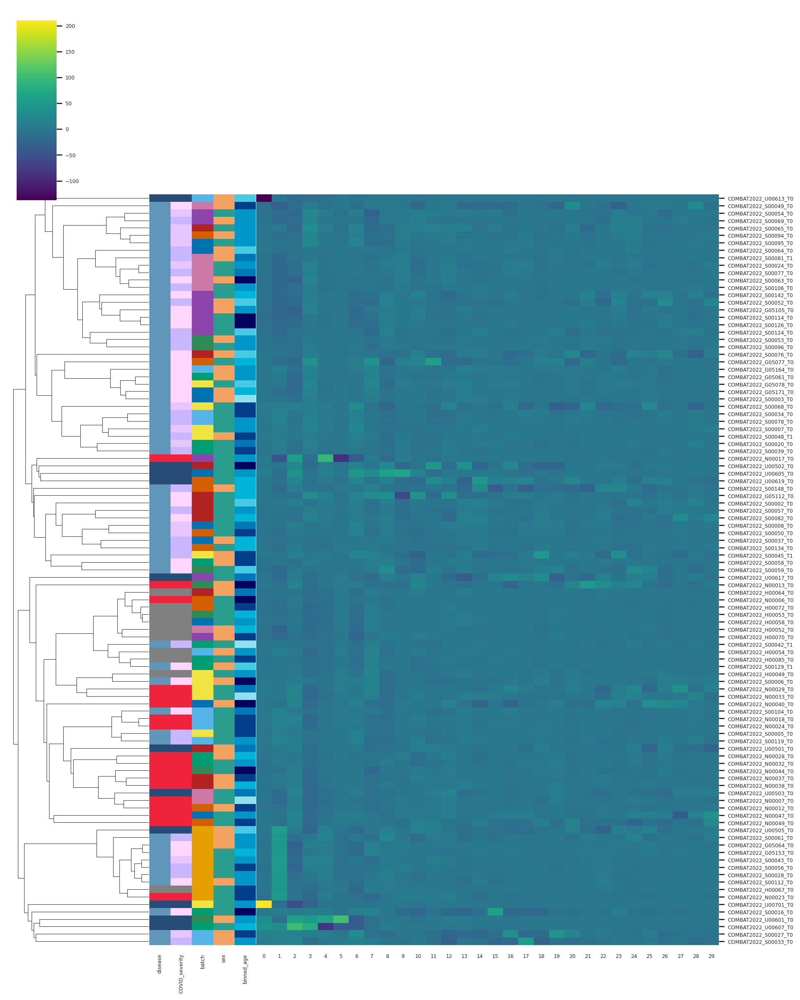

T_CD4_NonNaive


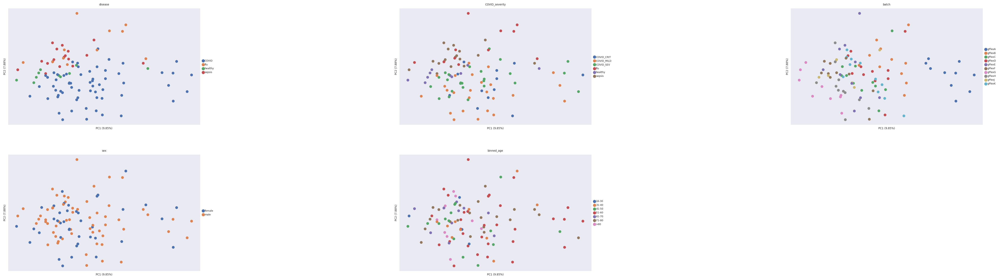

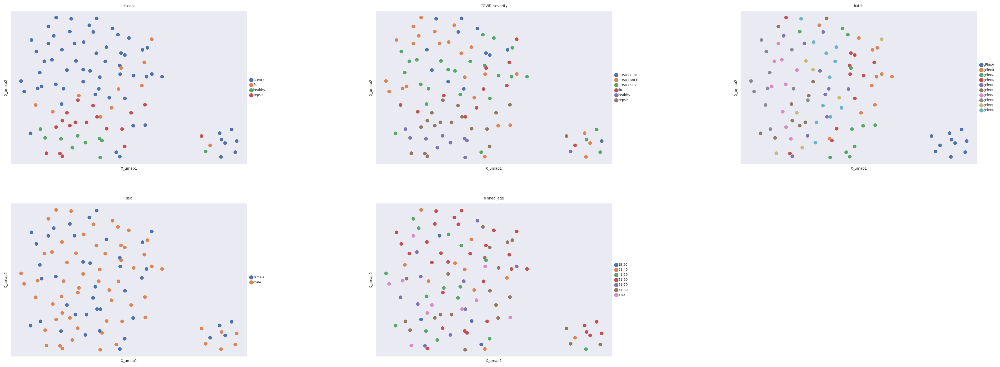

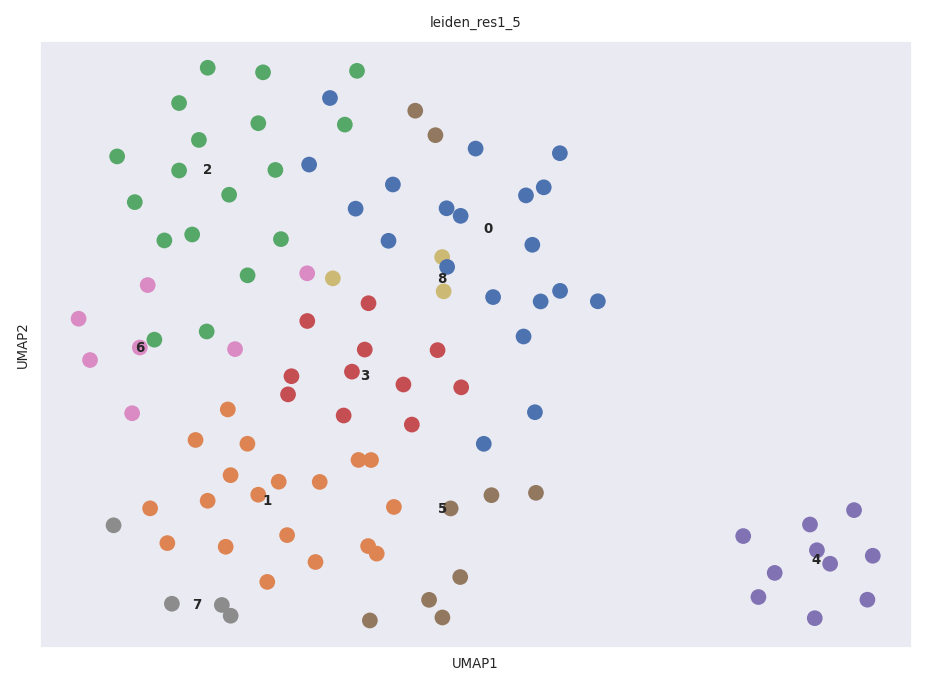

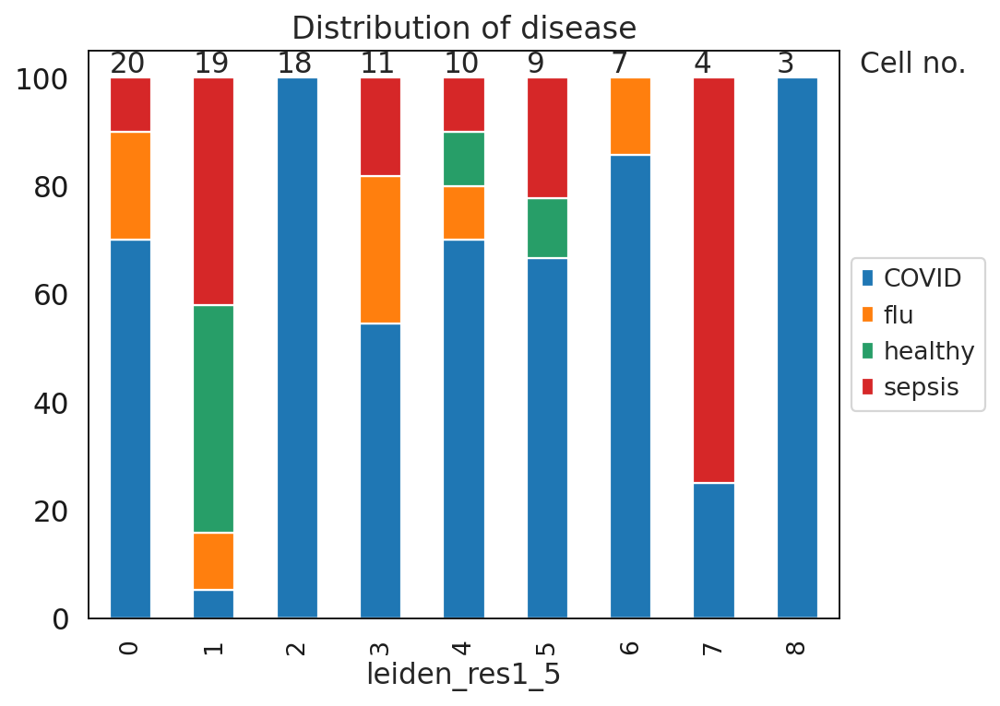

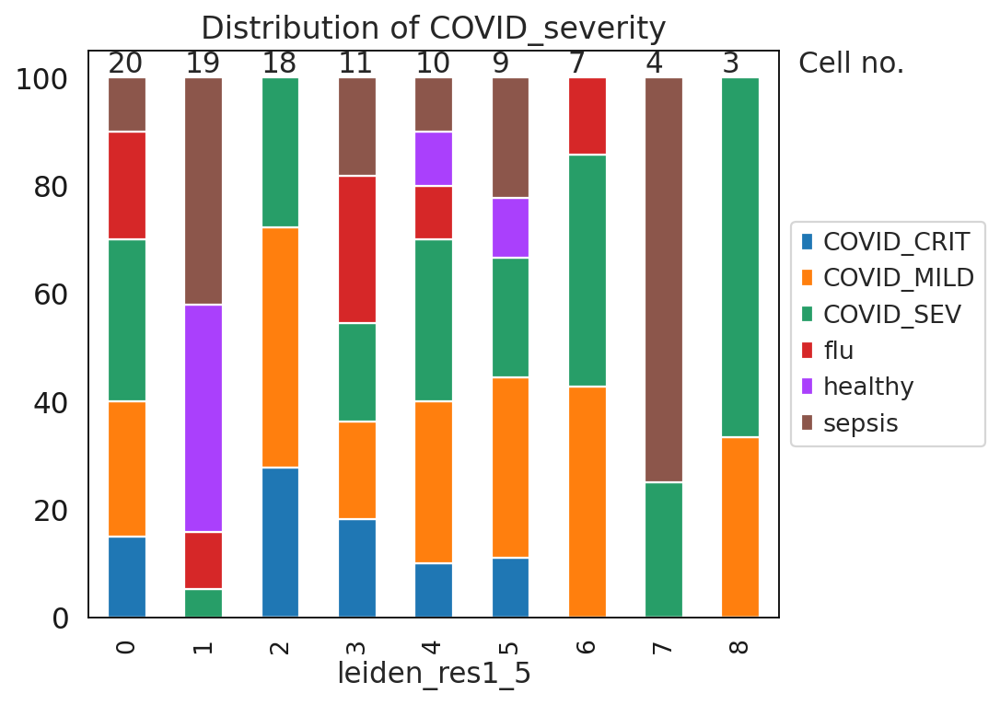

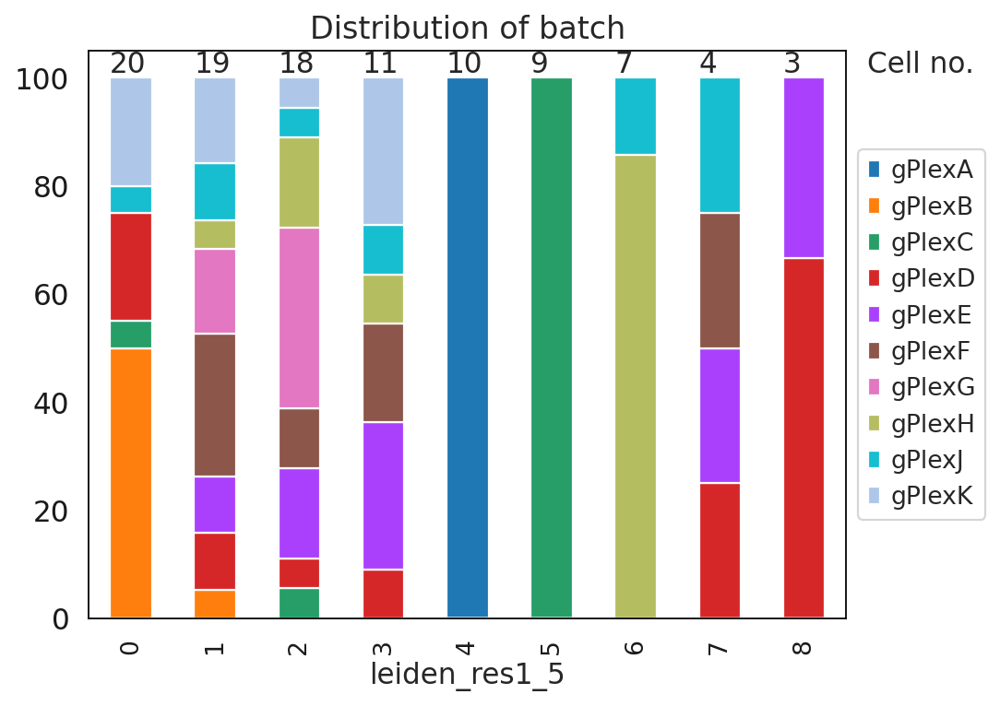

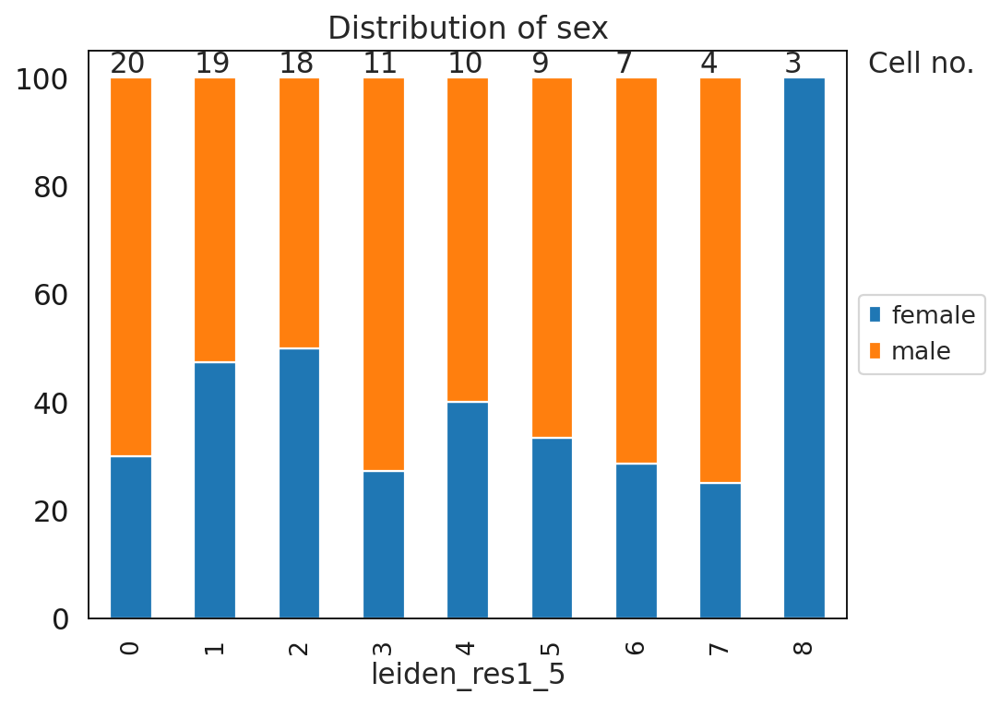

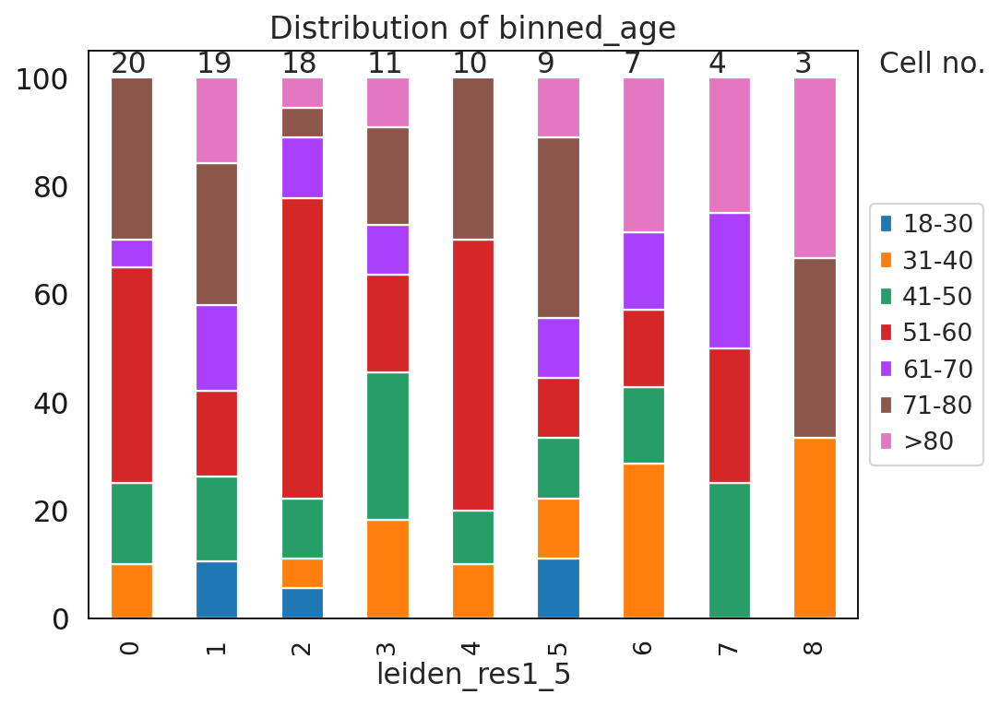

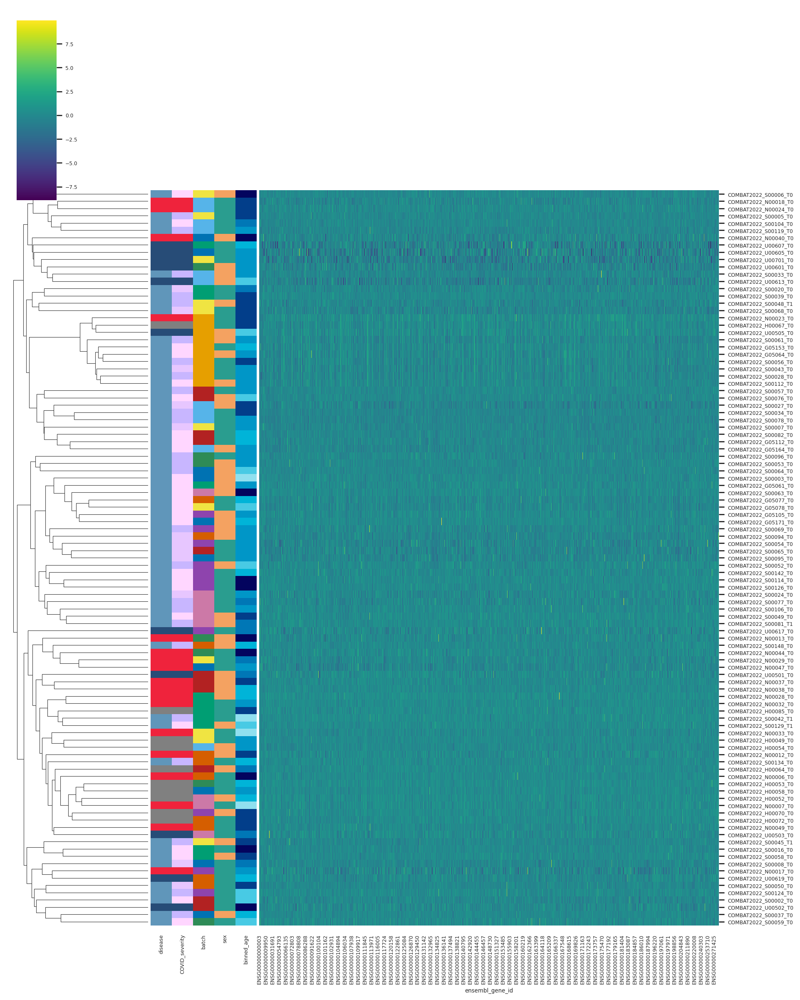

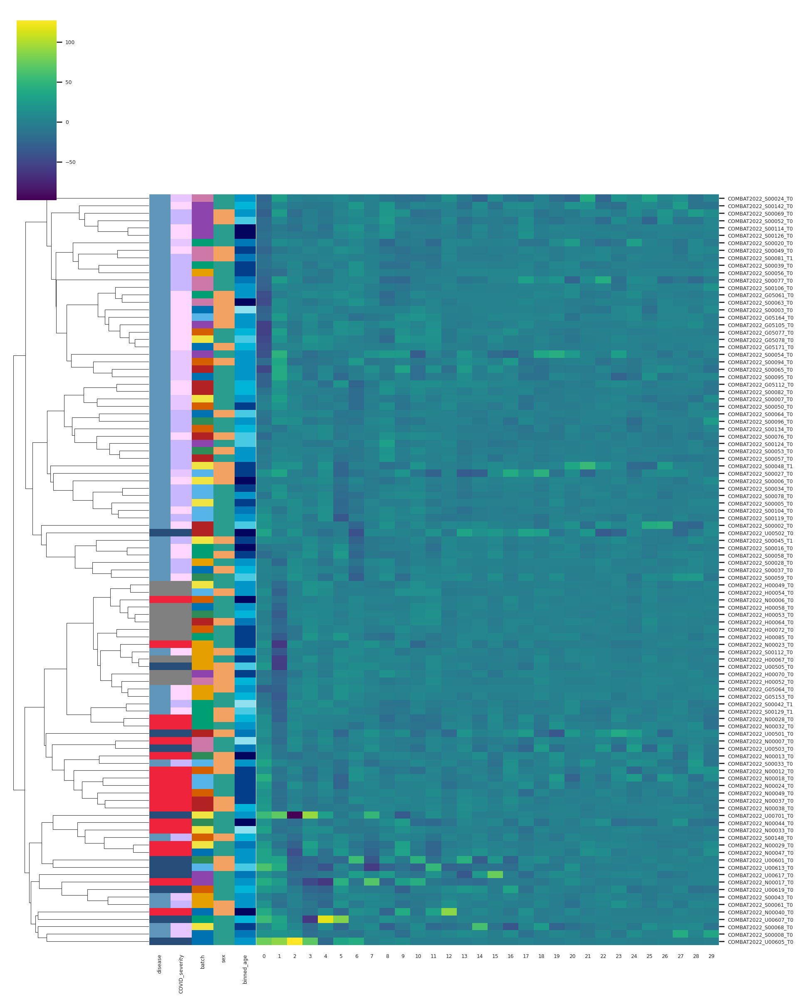

T_CD8_Naive


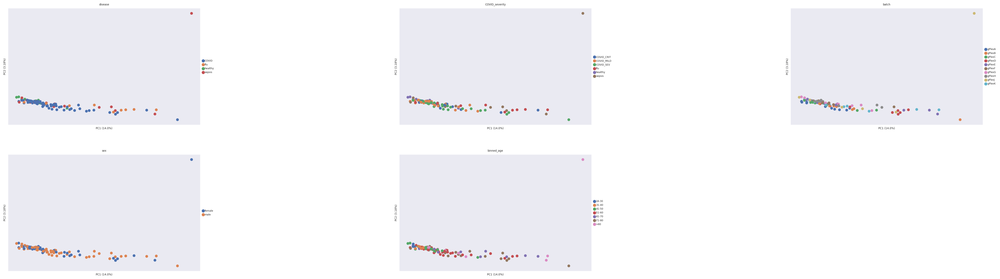

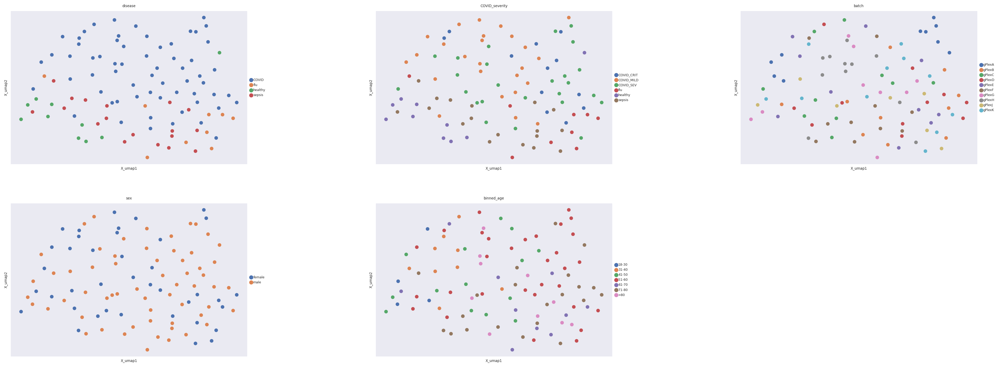

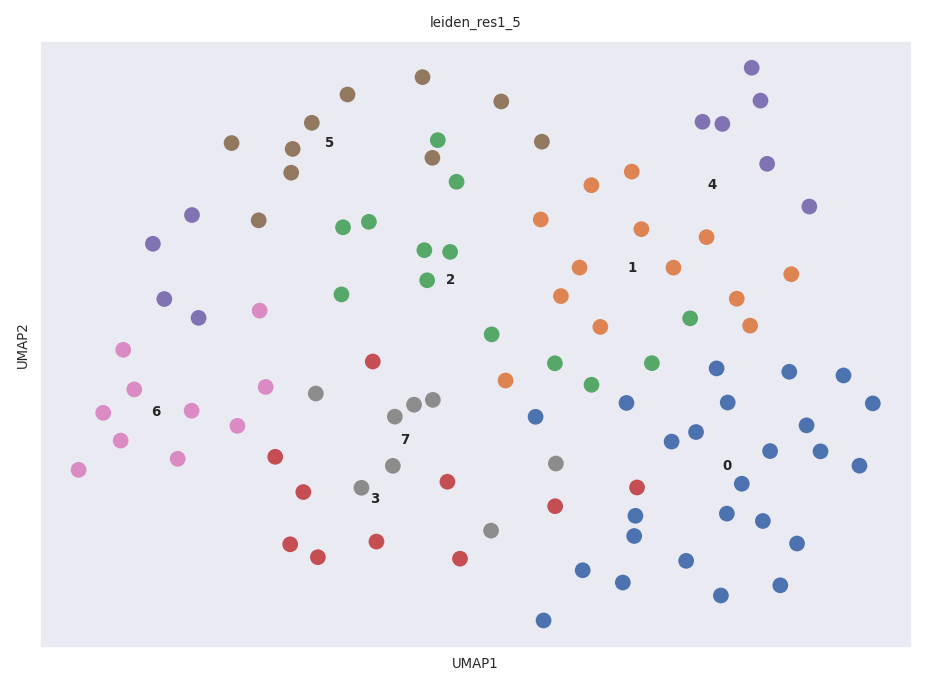

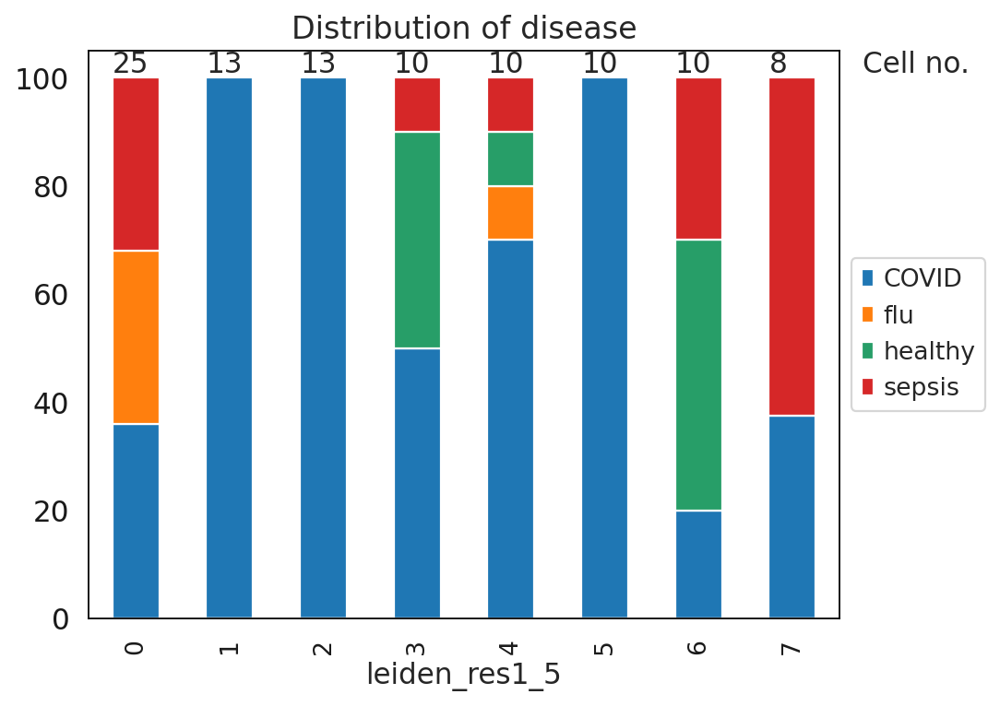

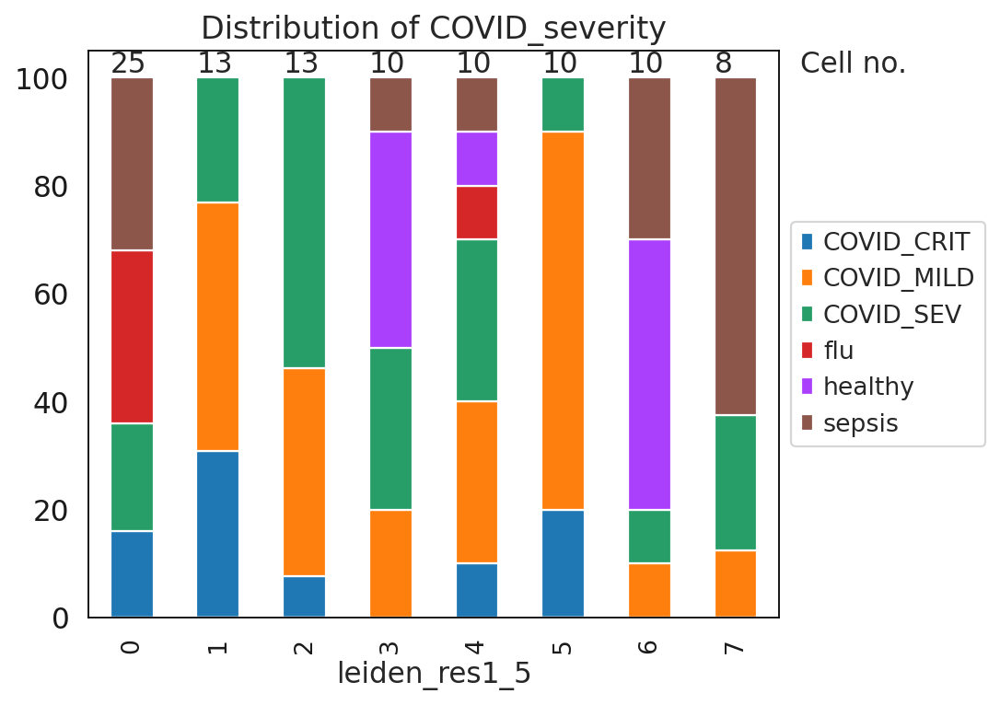

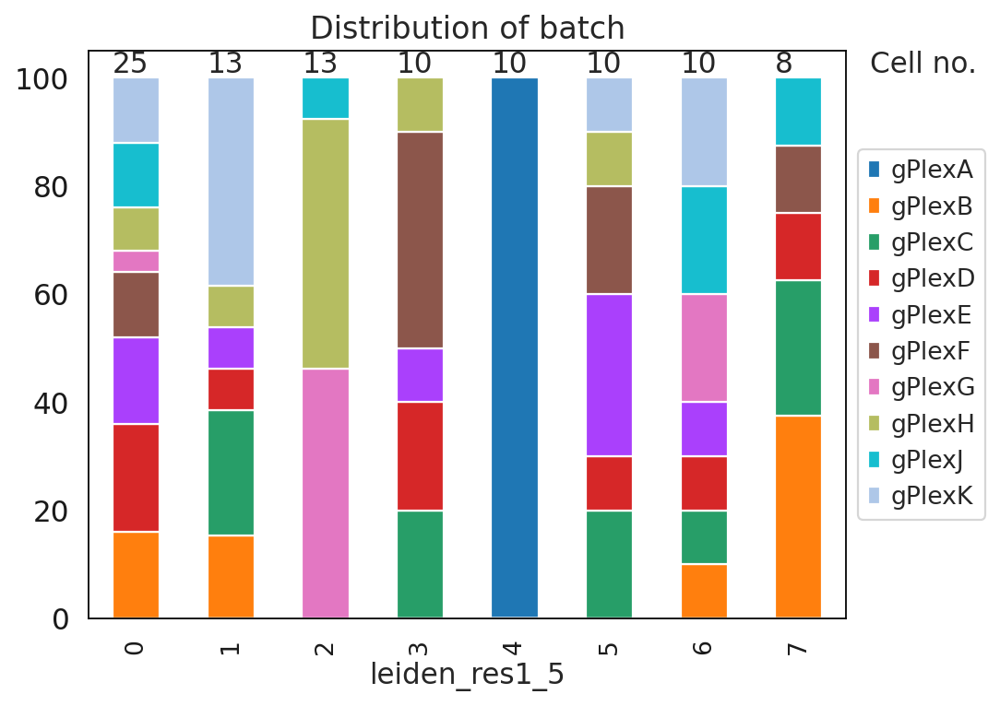

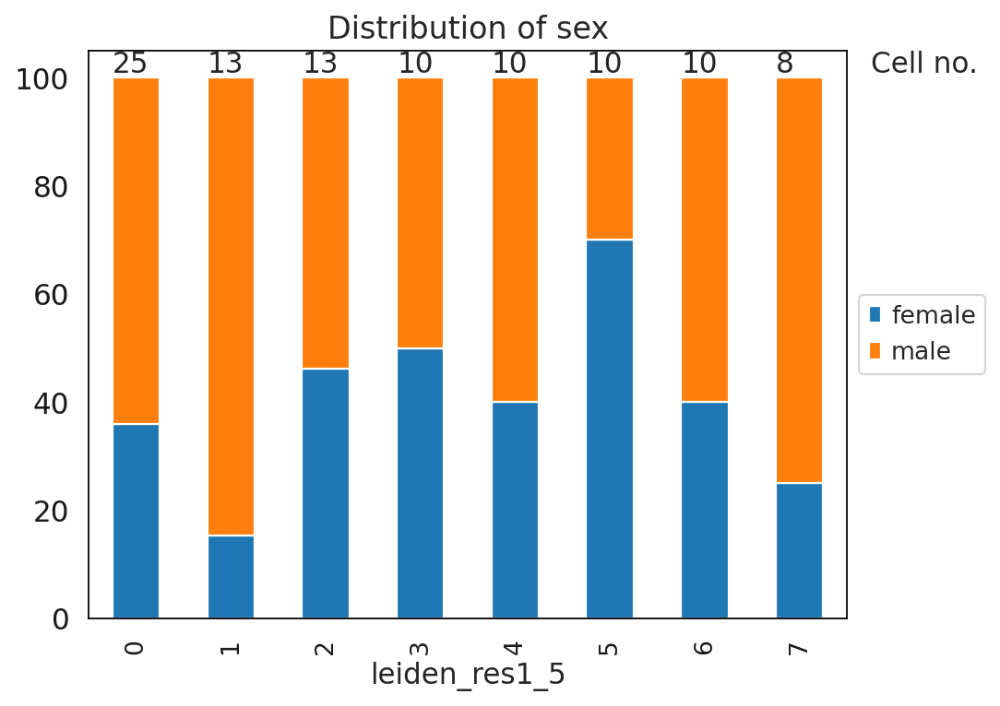

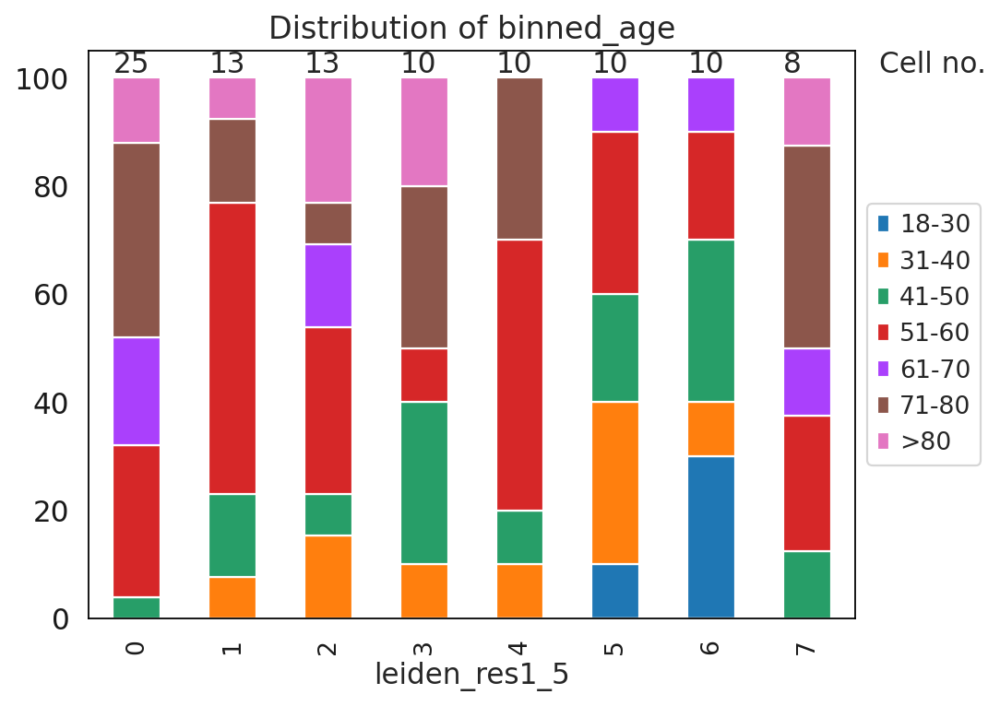

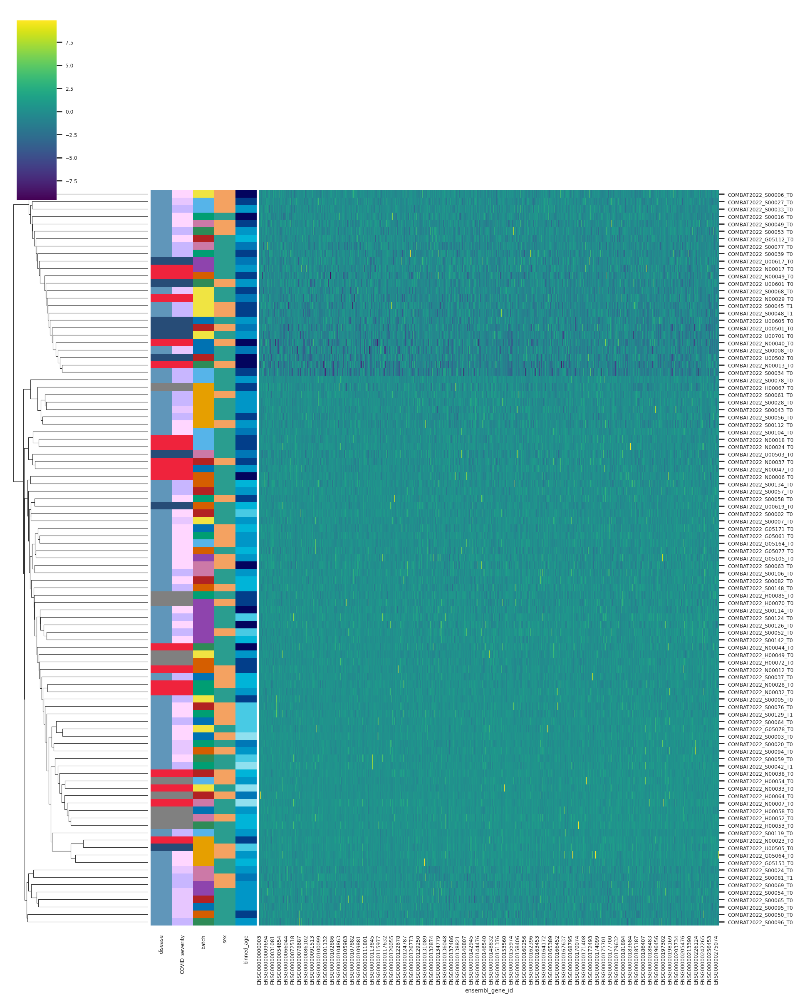

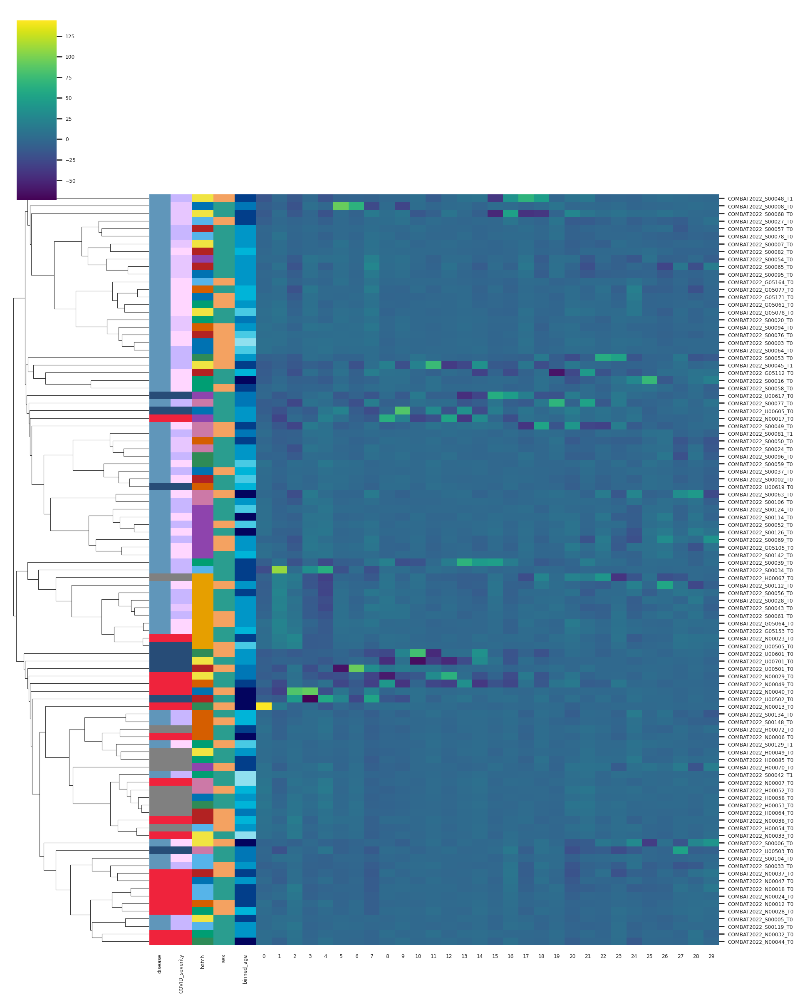

T_CD8_NonNaive


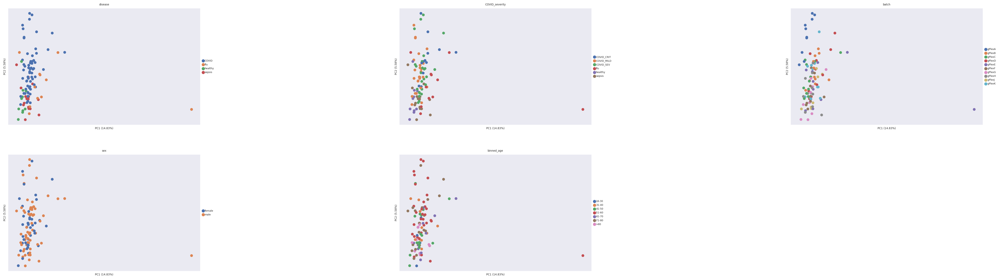

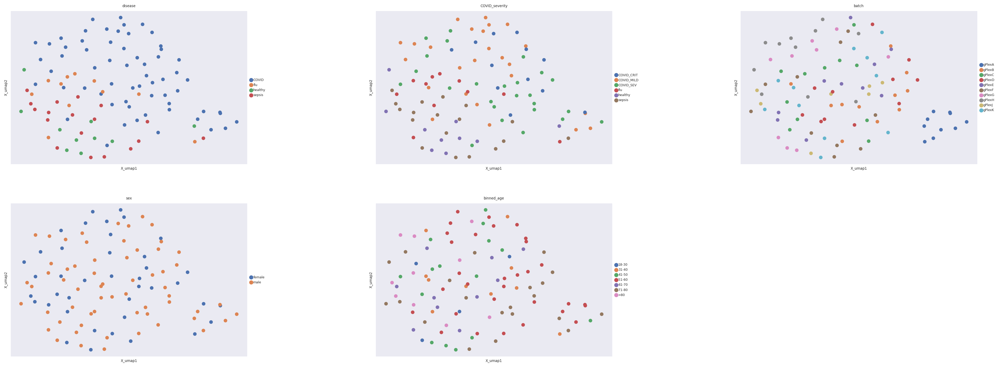

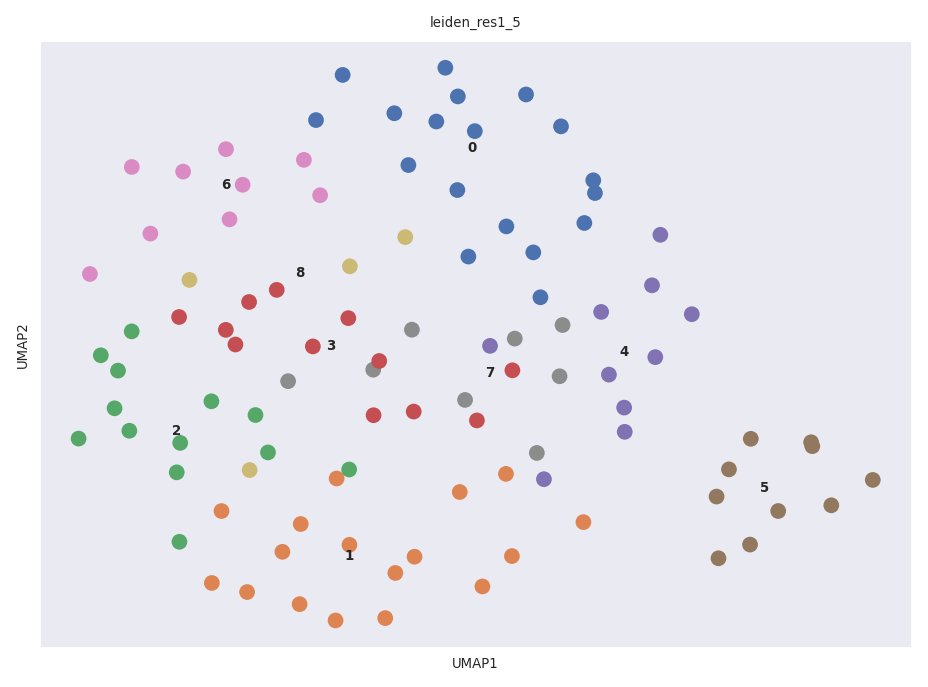

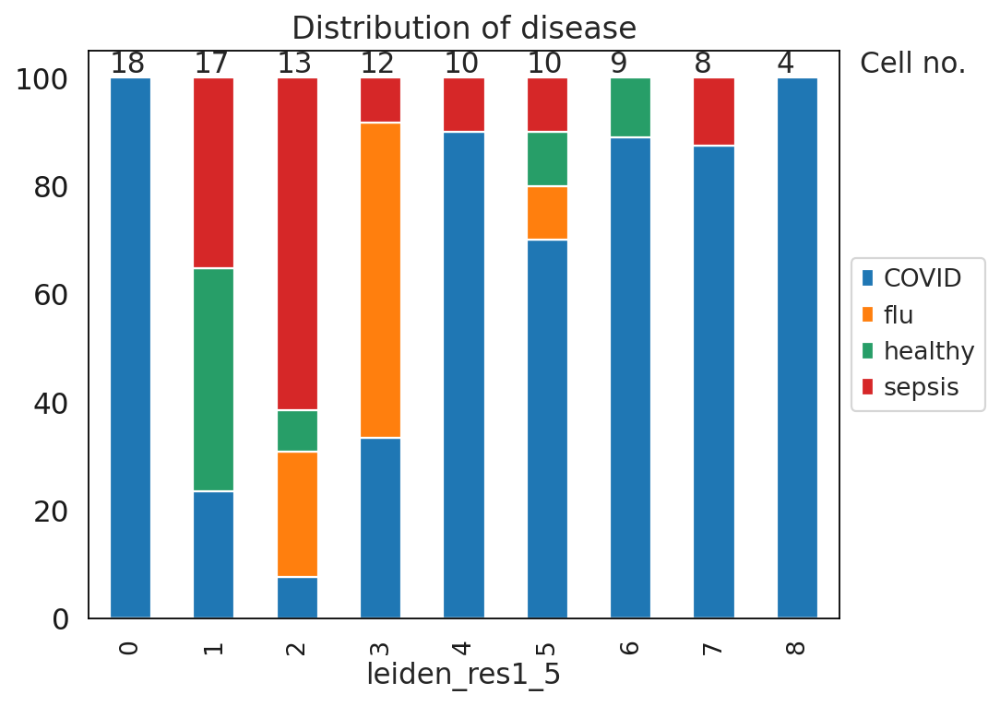

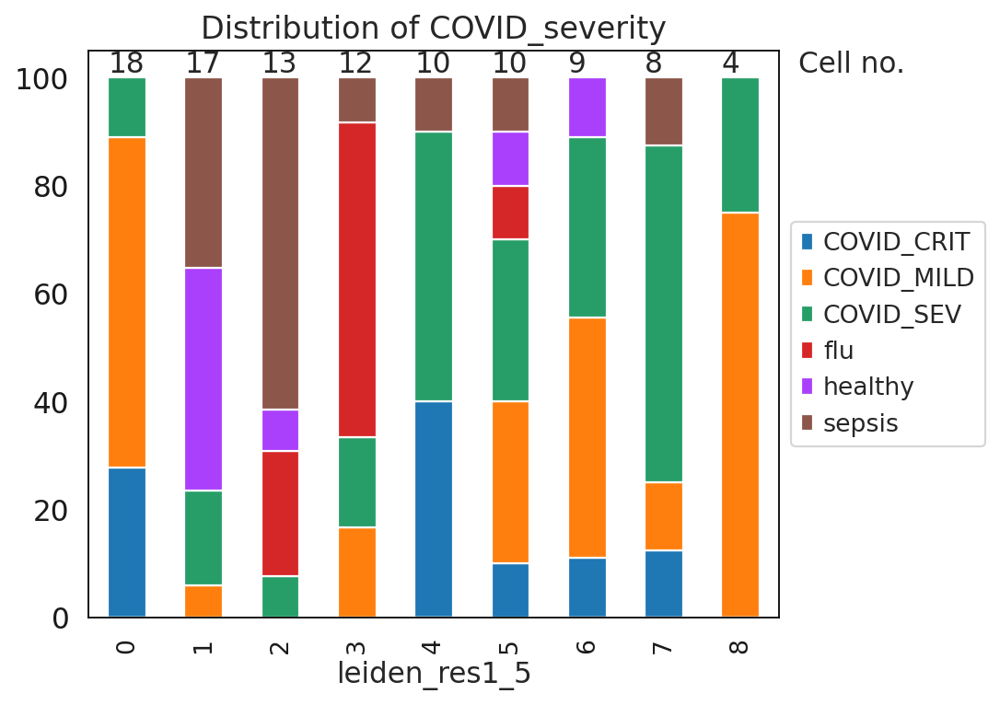

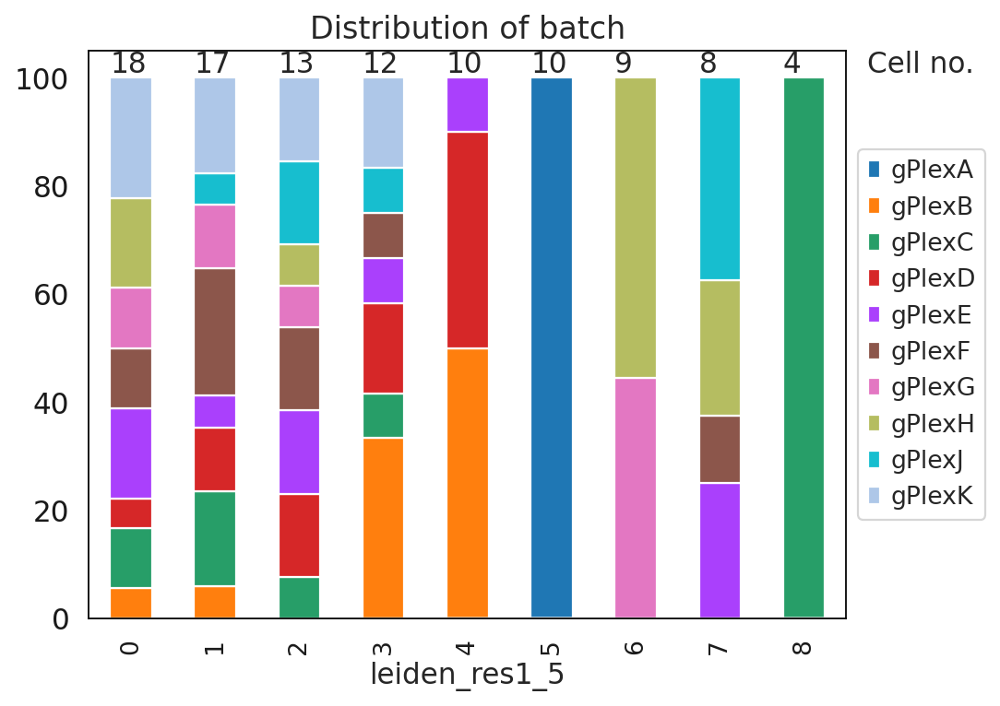

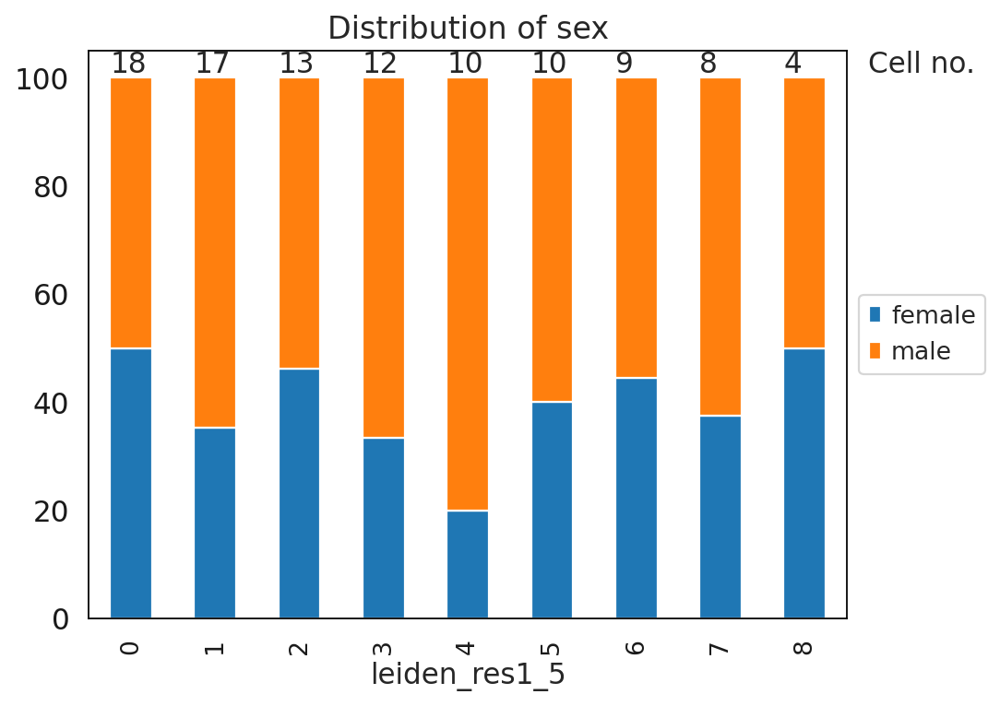

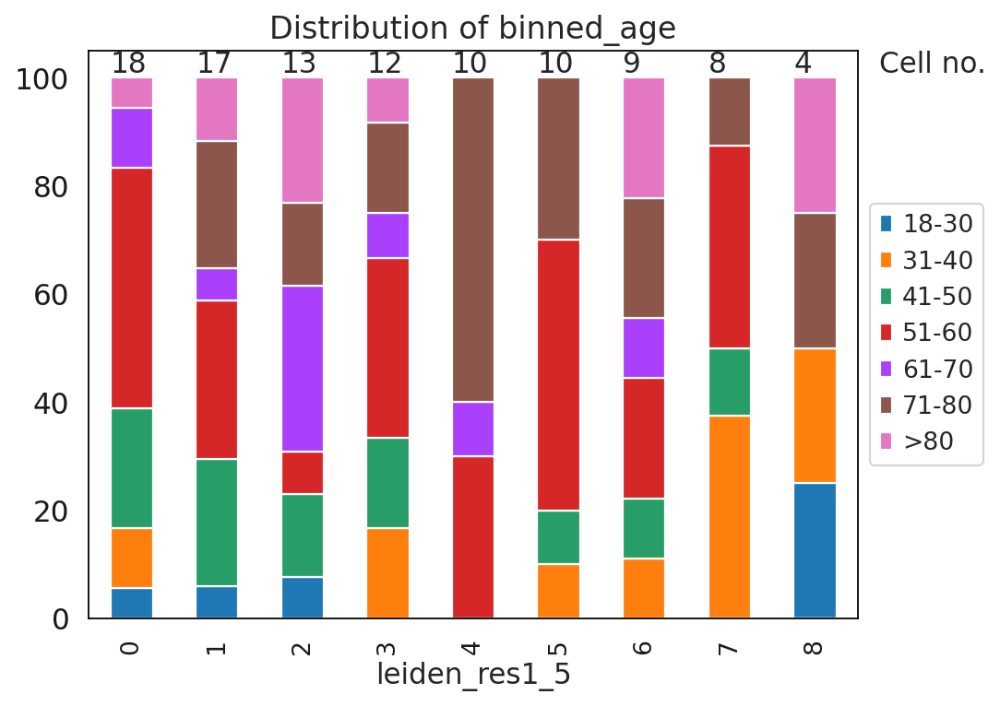

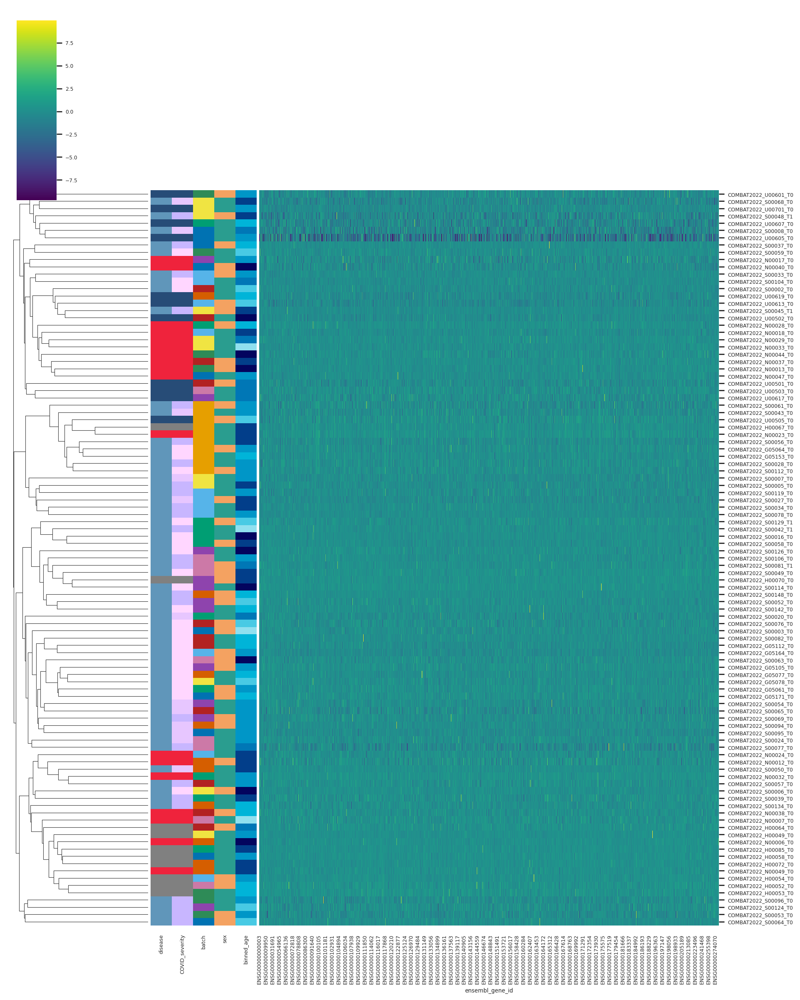

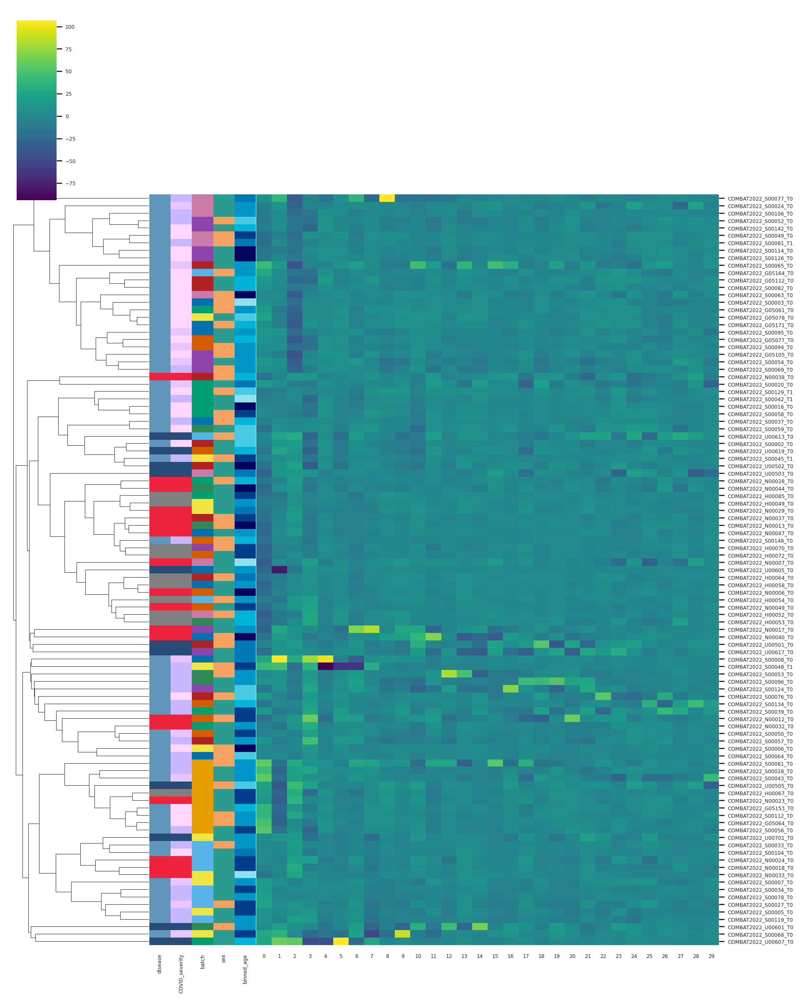

UTC


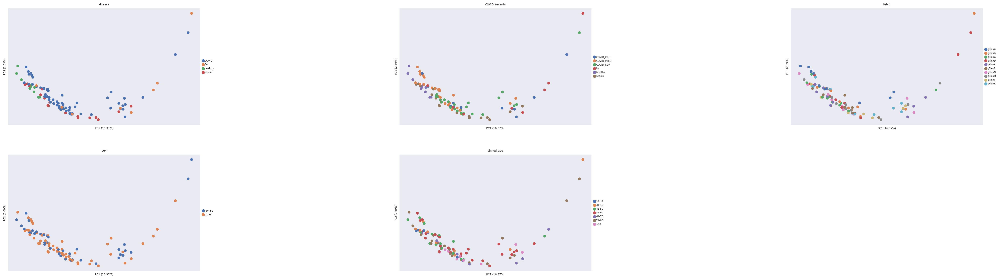

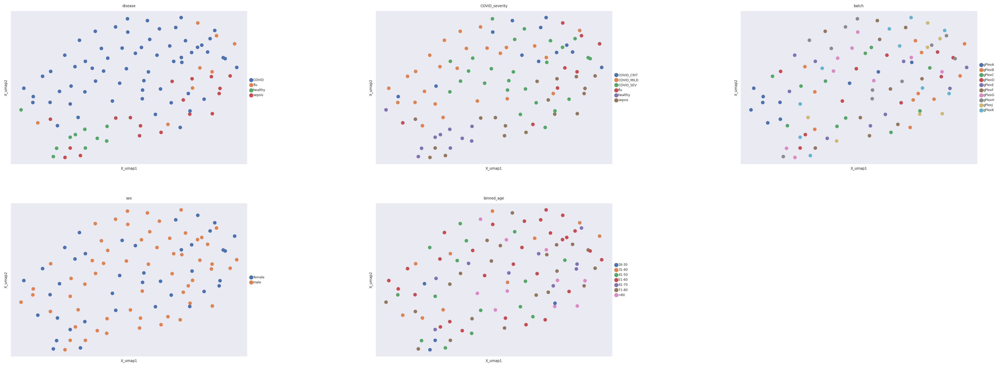

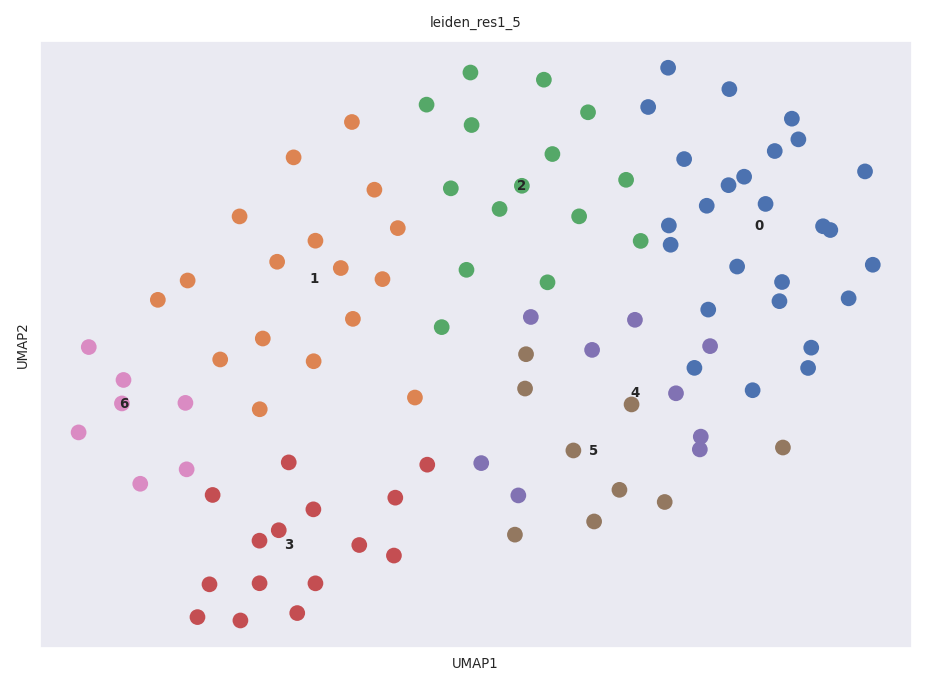

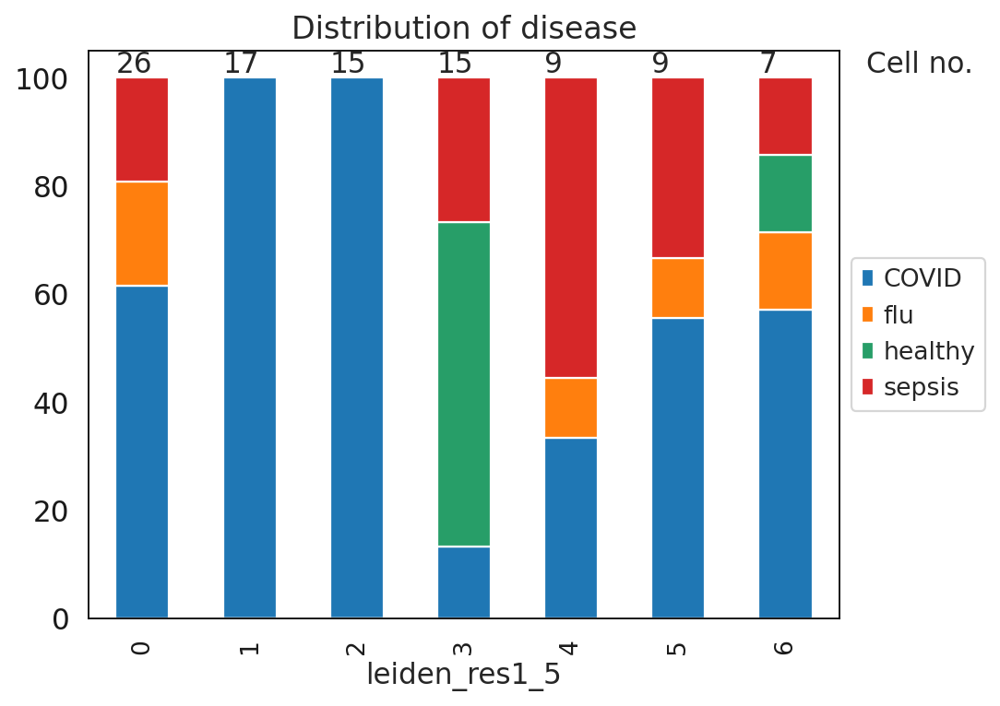

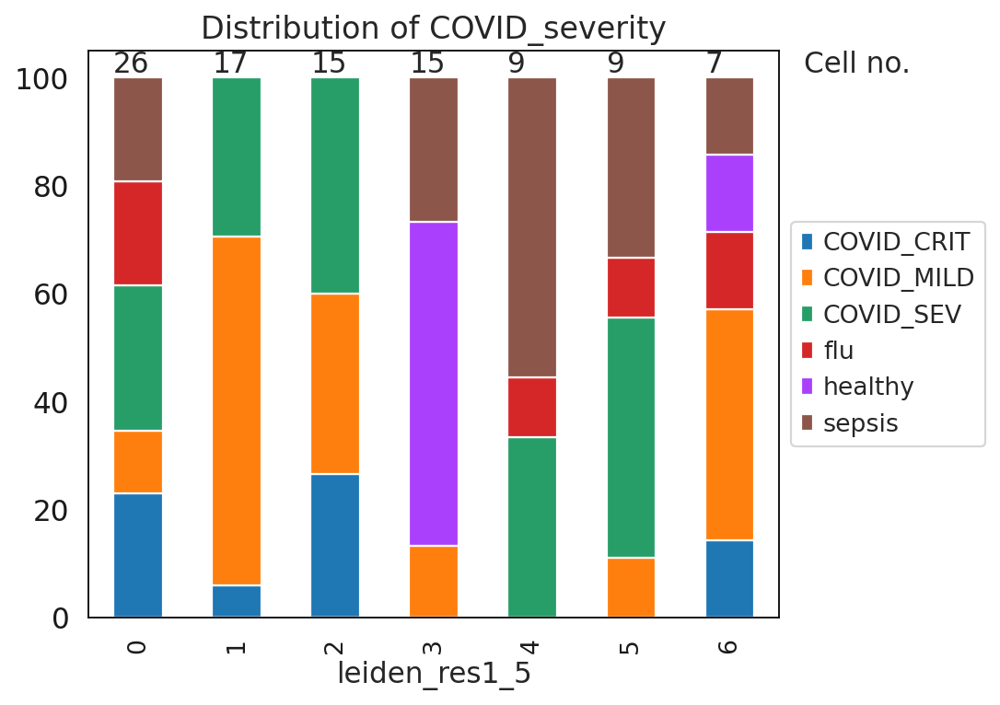

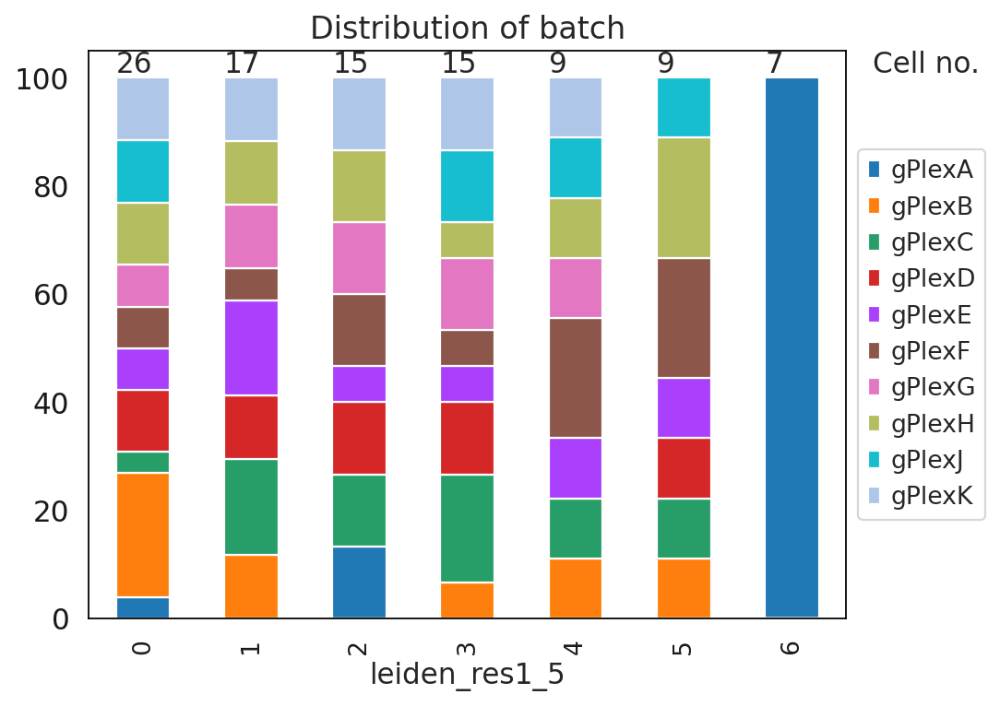

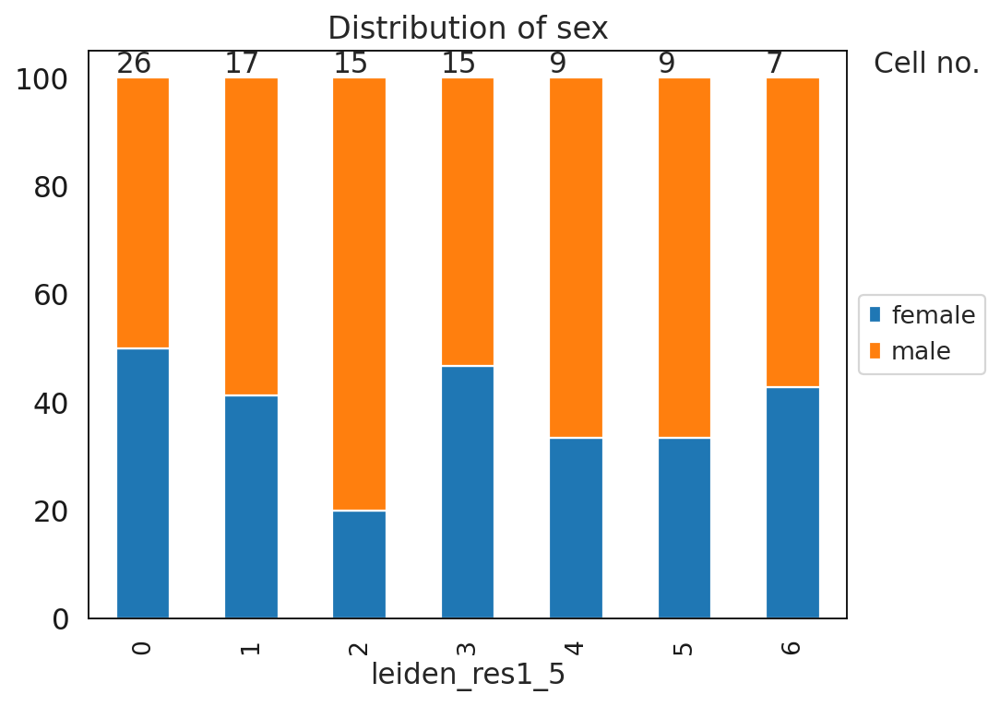

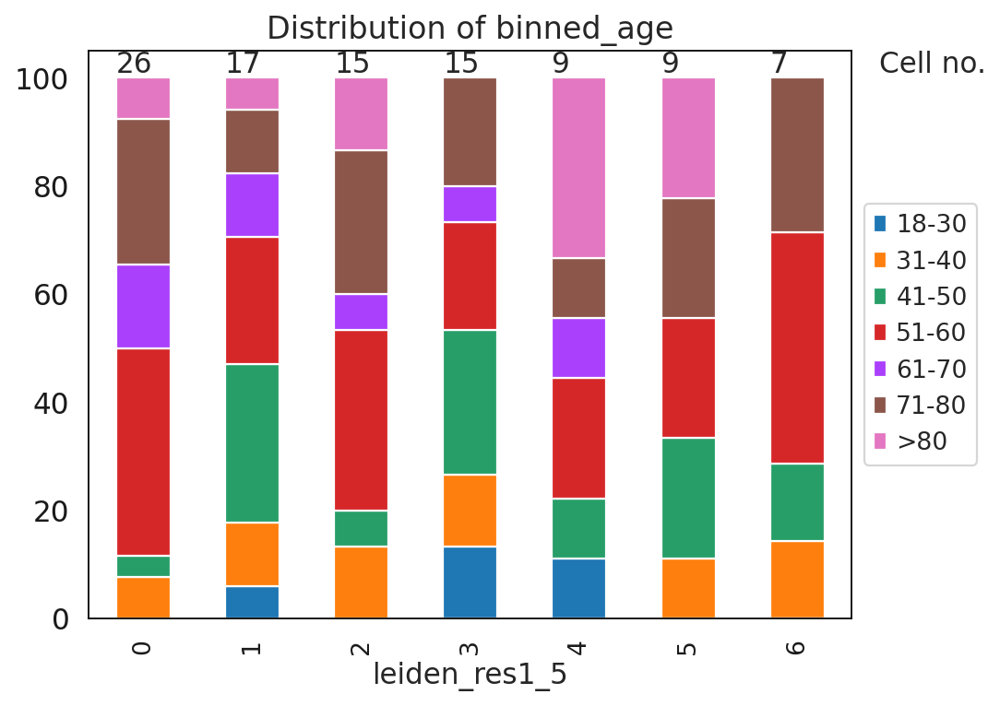

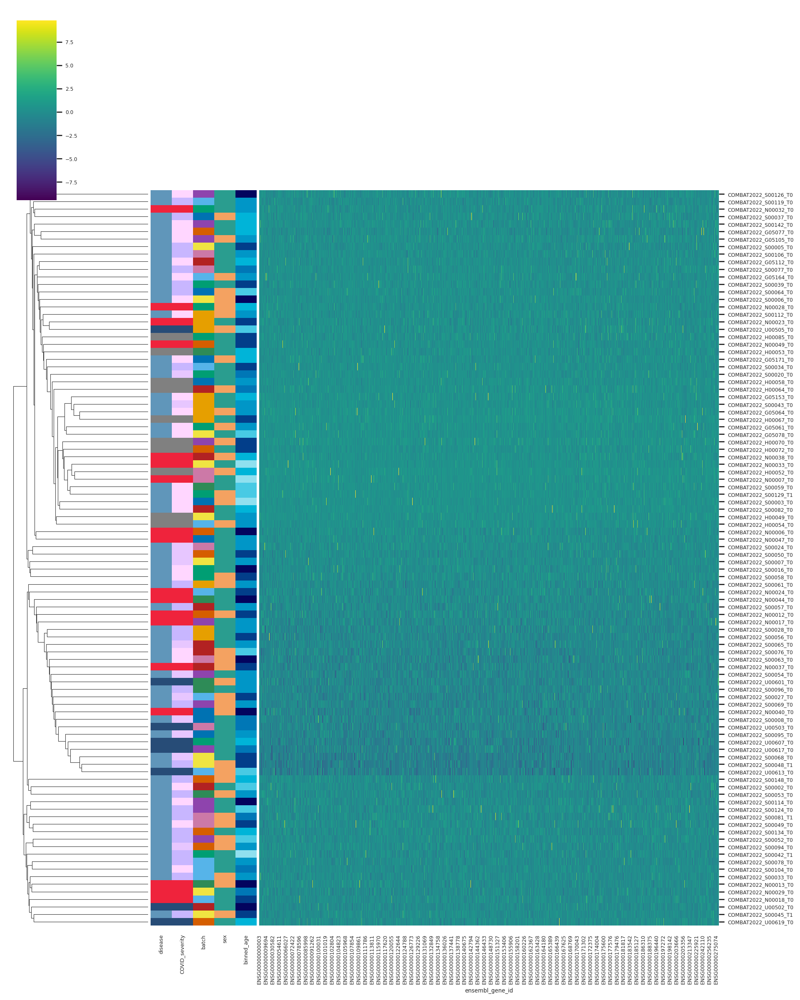

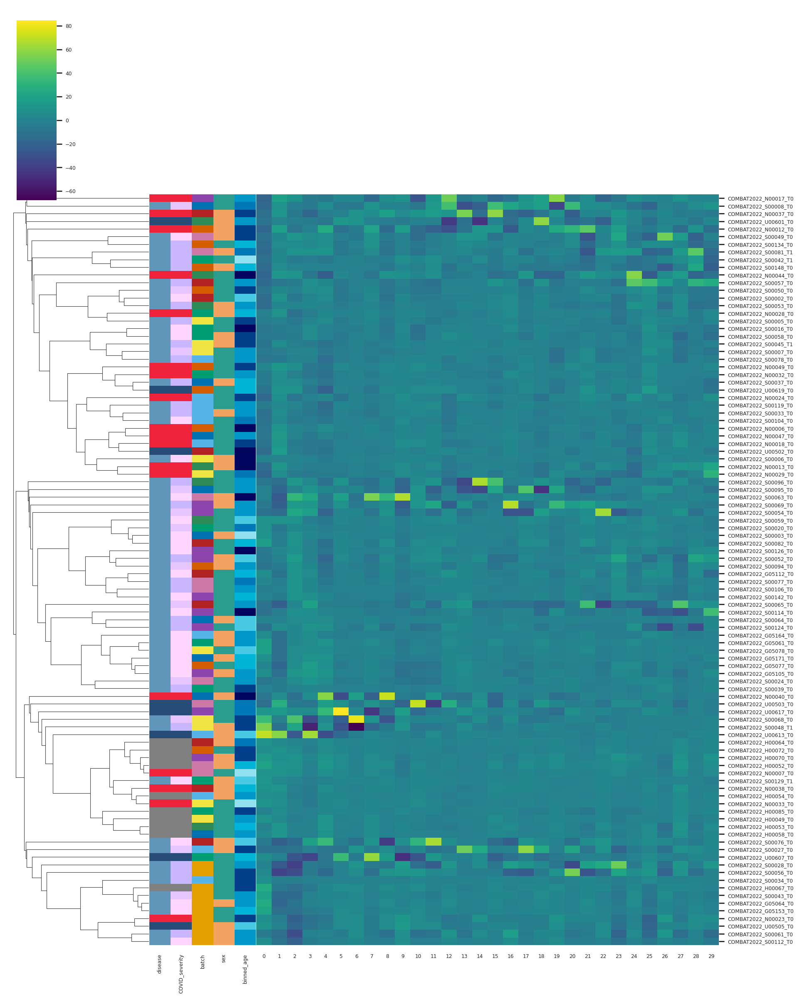

ILC


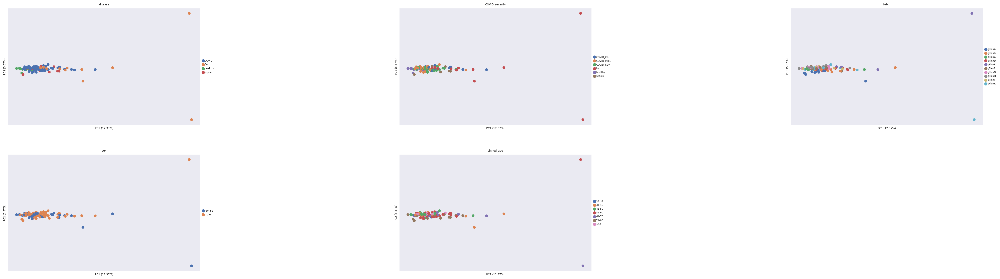

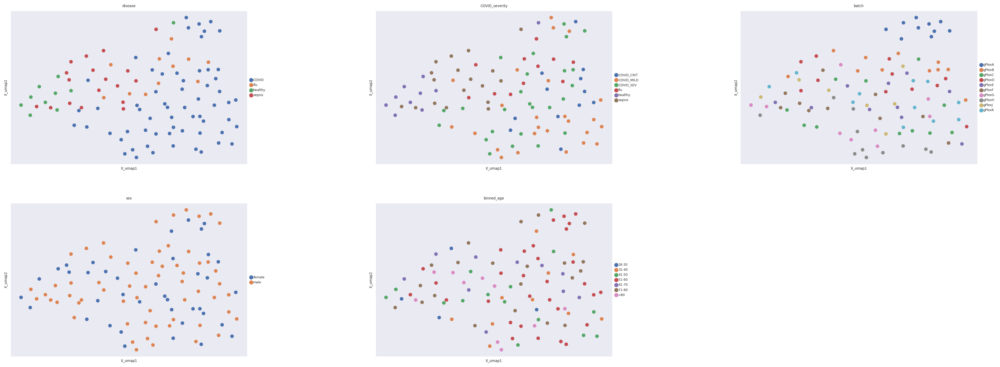

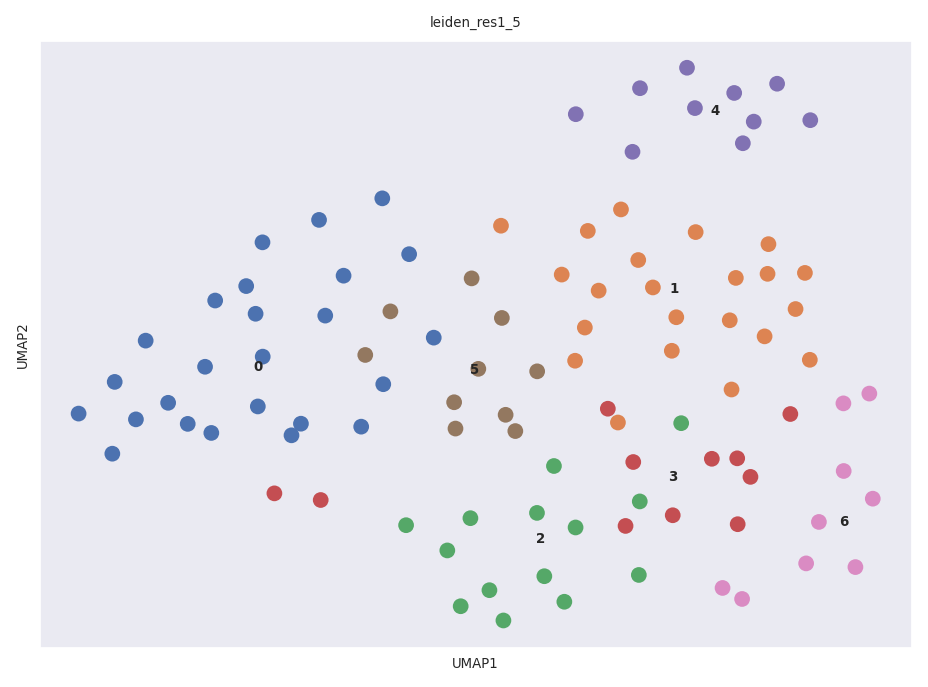

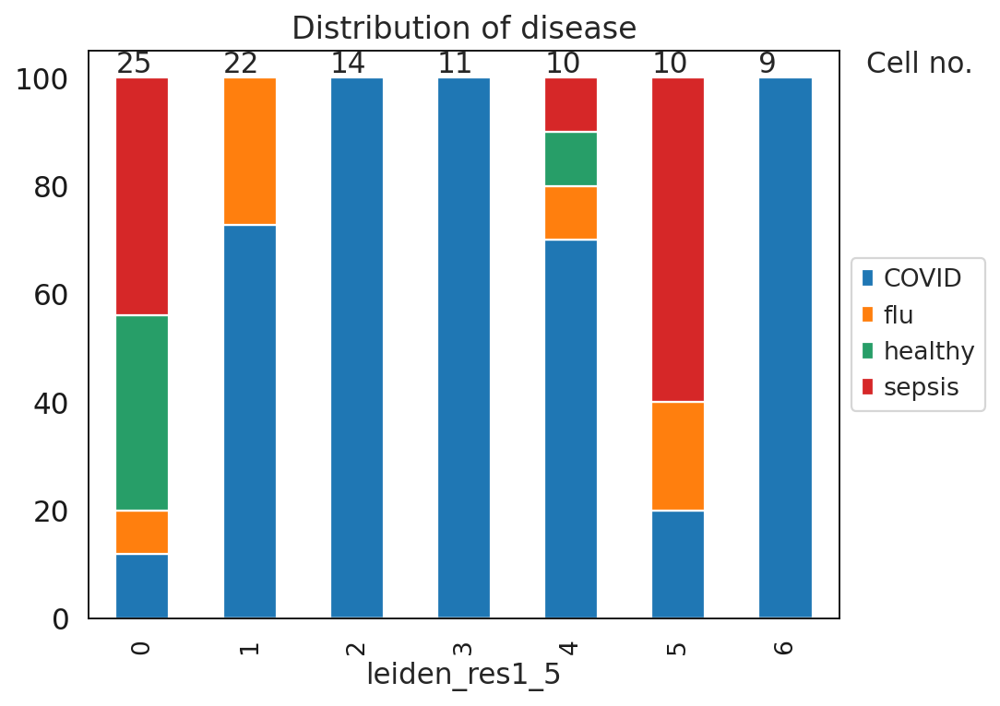

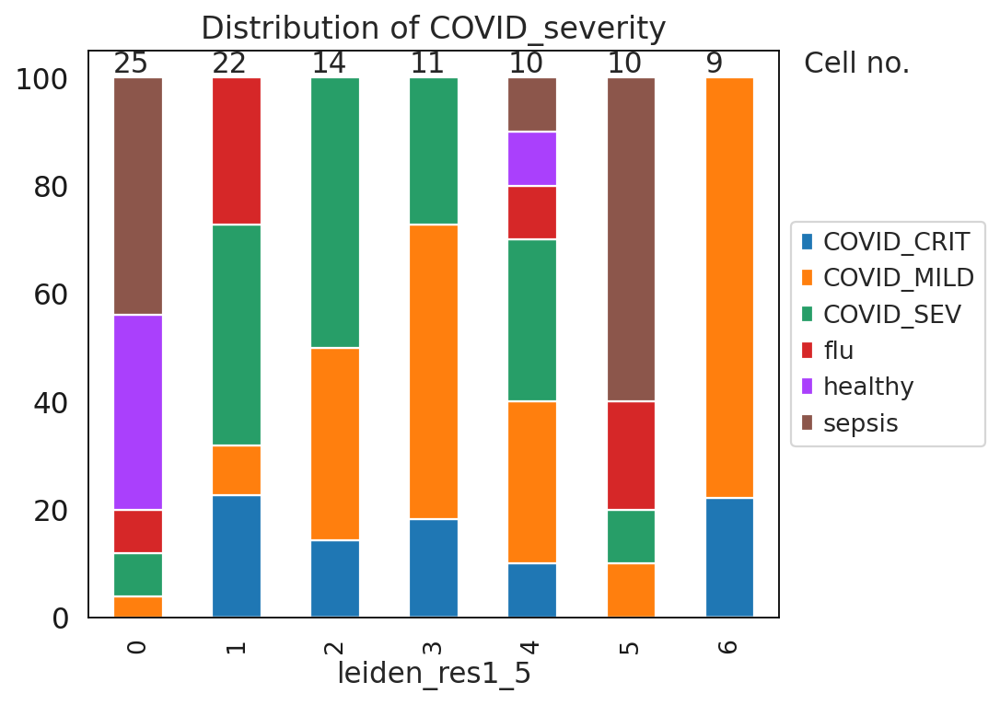

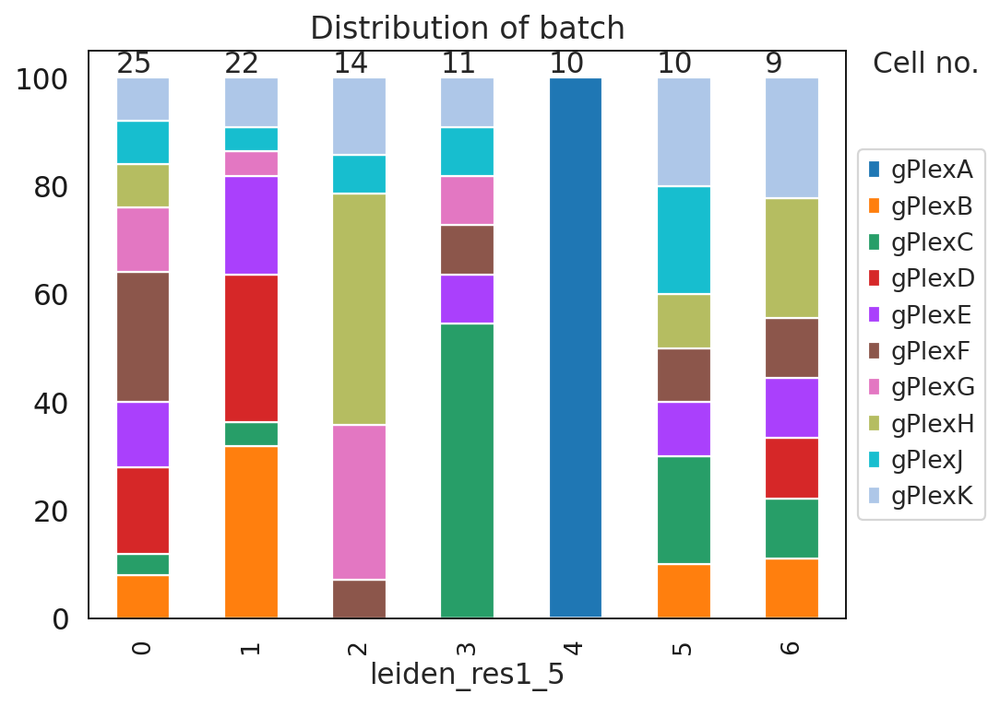

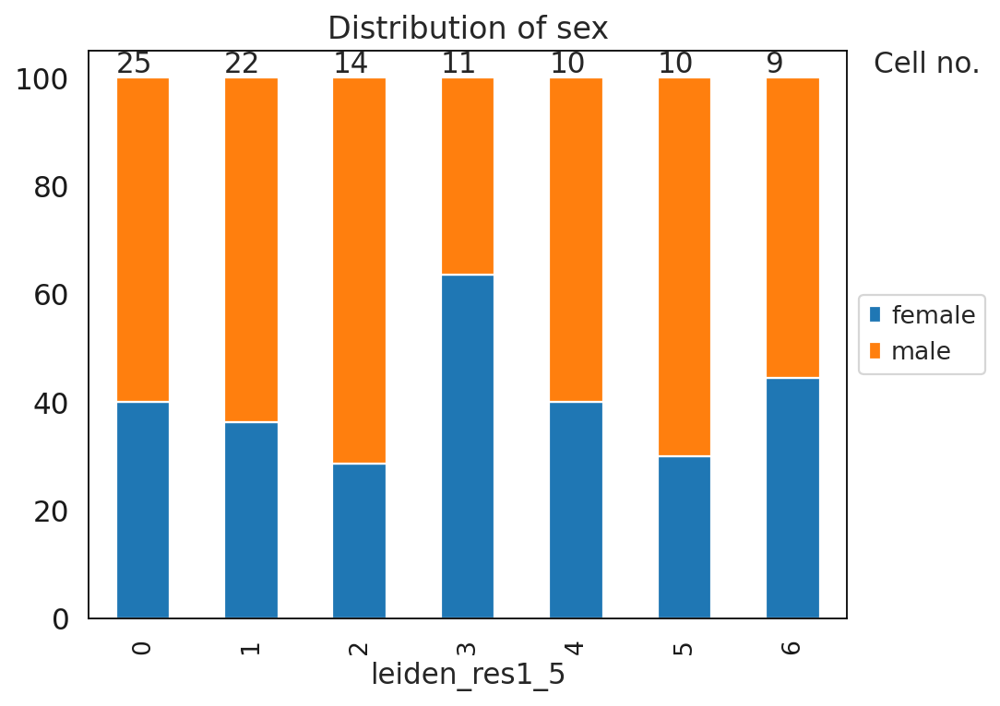

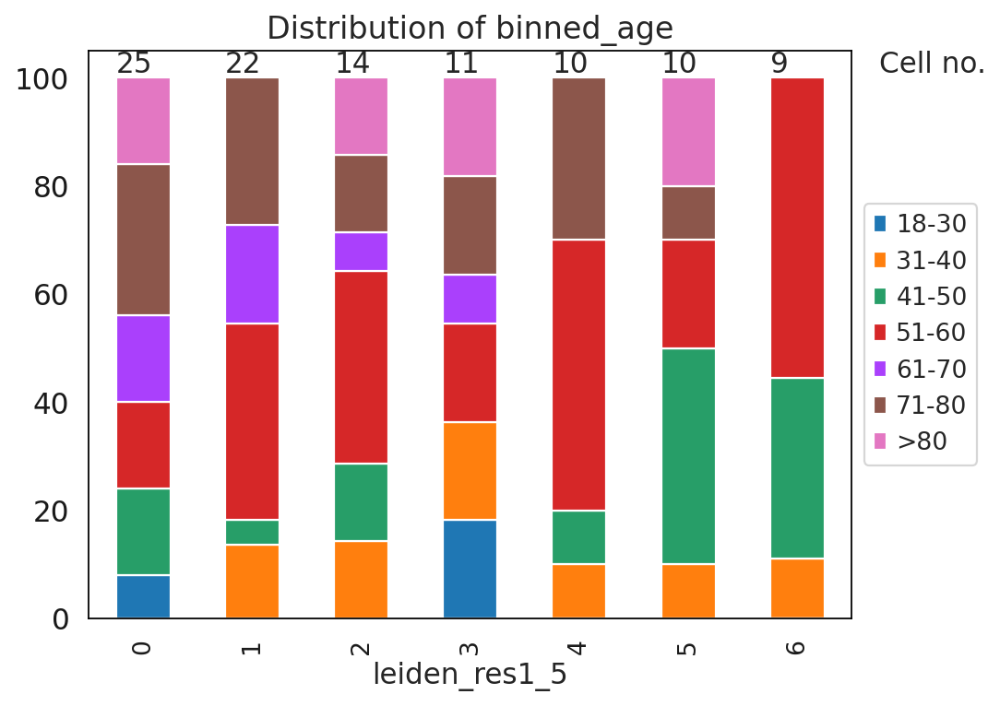

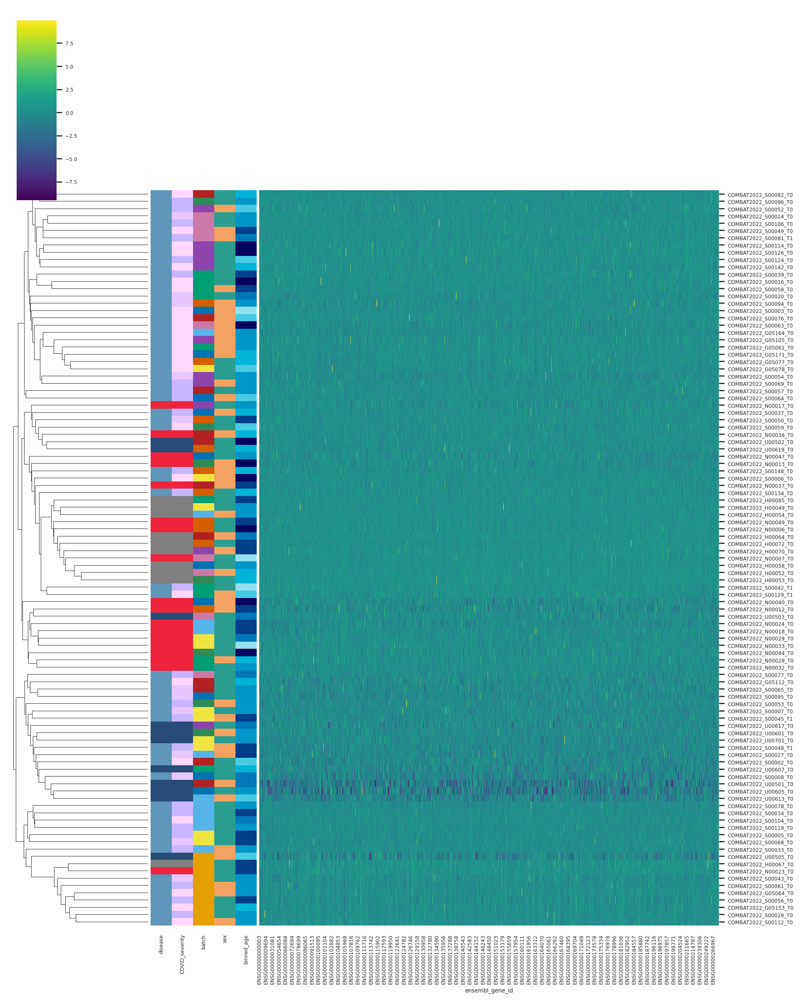

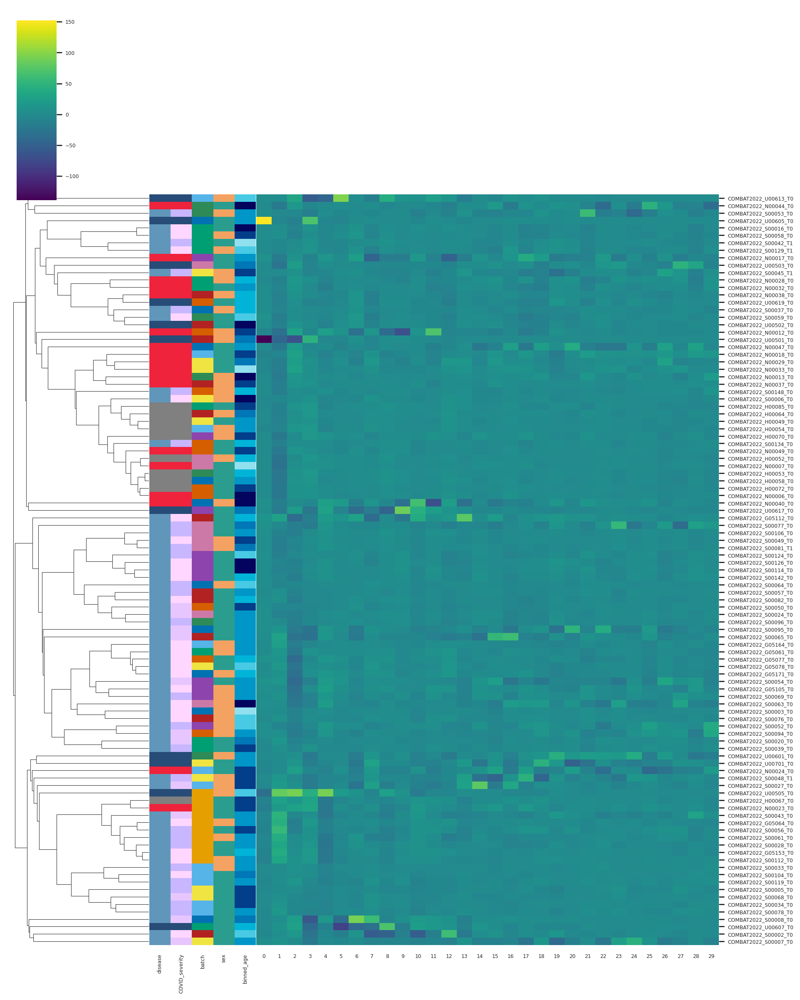

In [71]:
for celltype in annotation_Level1_NonUsedFilt_sortednames:

    print(celltype)
    # Subset adata
    adata_sub = adata[(adata.obs['Level1'] == celltype)]

    # Pseudobulk per patient and cell type, keeping disease
    psdata_sampleID_bycell = dc.get_pseudobulk(adata=adata_sub, 
                                     min_cells=0, 
                                     sample_col = 'sampleID',
                                     groups_col='sampleID', 
                                     layer=None,#'counts', 
                                     mode='sum')
    
    psdata_sampleID_bycell.layers['counts'] = psdata_sampleID_bycell.X.copy()
    psdata_sampleID_bycell

    # Normalizing
    sc.pp.normalize_total(psdata_sampleID_bycell, target_sum=1e6)
    sc.pp.log1p(psdata_sampleID_bycell)
    sc.pp.scale(psdata_sampleID_bycell)


    # HVG
    #sc.pp.highly_variable_genes(psdata_sampleID, layer="log1p_10e4_counts")
    
    # PCA
    sc.pp.pca(psdata_sampleID_bycell, svd_solver="arpack", use_highly_variable=False, n_comps=50)
    
    sc.pl.pca(psdata_sampleID_bycell, color=psdata_sampleID_bycell.obs[[
                                        'disease','COVID_severity',
                                        'batch',
                                        'sex',
                                        'binned_age'
                                       ]], 
              ncols=3, size=150, wspace=0.85, annotate_var_explained=True)

    
    # Computing KNN graph
    sc.pp.neighbors(psdata_sampleID_bycell, n_neighbors=20, n_pcs=30)
    
    # UMAP
    sc.tl.umap(psdata_sampleID_bycell)
    
    fig = sc.pl.embedding(psdata_sampleID_bycell, basis = 'X_umap',  
                     color=['disease','COVID_severity','batch','sex','binned_age'], 
                     wspace = 0.4, size=150, ncols = 3, return_fig=True)

    # Leiden clustering
    sc.tl.leiden(psdata_sampleID_bycell, key_added="leiden_res1_5", resolution=1.5)
    
    sc.pl.umap(
        psdata_sampleID_bycell,
        color=["leiden_res1_5"],
        legend_loc="on data",
        size=200
    )

    
    # Evaluate co-variables distribution across clusters
    pdf_pages = PdfPages(here("03_downstream_analysis/06_inflammation_signatures/results/figures/COMBAT2022wSepsis_{}_noncorr_pseudoB-sampleID_LeidClust_barplots.pdf".format(celltype)))
    for variable in ['disease','COVID_severity','batch','sex','binned_age']:
        sc.set_figure_params(figsize=(7, 5))
        composition_barplot(psdata_sampleID_bycell, xattr="leiden_res1_5", yattr=variable, title="Distribution of {}".format(variable), save_pdf=pdf_pages)
    pdf_pages.close()

    
    
    metadata_sampleID = psdata_sampleID_bycell.obs[["disease", 'COVID_severity', "batch", "sex", "binned_age"]]  # Extract metadata

    # Hierarchical clustering based on 9K genes
    psdata_sampleID_bycell_df = psdata_sampleID_bycell.to_df()  # Genes (rows) × Pseudobulk samples (columns)
   
    sns.set(font_scale=0.5)
    g1 = sns.clustermap(
        psdata_sampleID_bycell_df, 
        col_cluster=False, 
        method='average', metric='cosine', 
        cmap="viridis",
        figsize=(12, 15),
        row_colors=metadata_sampleID.replace({"disease": diseases_palette, "COVID_severity": COVID_severity_palette,
                                              "sex": sex_palette, "binned_age" : binned_age_palette, 
                                              "batch" : batch_palette})
    )
    
    g1.savefig(here("03_downstream_analysis/06_inflammation_signatures/results/figures/COMBAT2022wSepsis_{}_noncorr_pseudoB-sampleID_clustermap_covariates.pdf".format(celltype)),
              format="pdf", dpi=300, bbox_inches="tight", pad_inches=0)
    plt.show()

    
    # Hierarchical clustering based on top 30 PC
    psdata_sampleID_bycell_PC_df = pd.DataFrame(psdata_sampleID_bycell.obsm["X_pca"][:, 1:31], index=psdata_sampleID_bycell.obs.index)
    
    sns.set(font_scale=0.5)
    g2 = sns.clustermap(
        psdata_sampleID_bycell_PC_df, 
        col_cluster=False, 
        method='average', metric='cosine', 
        cmap="viridis",
        figsize=(12, 15),
        row_colors=metadata_sampleID.replace({"disease": diseases_palette, "COVID_severity": COVID_severity_palette,
                                              "sex": sex_palette, "binned_age" : binned_age_palette, 
                                              "batch" : batch_palette})
    )
    
    g2.savefig(here("03_downstream_analysis/06_inflammation_signatures/results/figures/COMBAT2022wSepsis_{}_noncorr-PCA_pseudoB-sampleID_clustermap_covariates.pdf".format(celltype)),
              format="pdf", dpi=300, bbox_inches="tight", pad_inches=0)
    plt.show()